# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

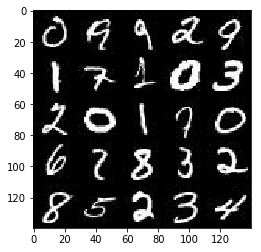

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

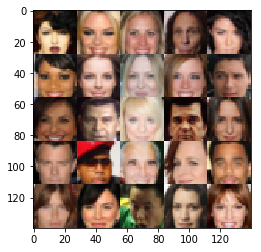

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [6]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    """
    Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks
    Paper: https://arxiv.org/abs/1511.06434
    Example: https://github.com/carpedm20/DCGAN-tensorflow
    """
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Hidden layer
        h1 = tf.layers.conv2d(images, 64, 5, 2, 'same')
        # Leaky ReLU
        h1 = tf.maximum(alpha * h1, h1)
        
        h2 = tf.layers.conv2d(h1, 128, 5, 2, 'same')
        h2 = tf.layers.batch_normalization(h2, training=True)
        h2 = tf.maximum(alpha * h2, h2)
        
        h3 = tf.layers.conv2d(h2, 256, 5, 1, 'same')
        h3 = tf.layers.batch_normalization(h3, training=True)
        h3 = tf.maximum(alpha * h3, h3)
        
        h4 = tf.layers.conv2d(h3, 512, 5, 1, 'same')
        h4 = tf.layers.batch_normalization(h4, training=True)
        h4 = tf.maximum(alpha * h4, h4)
        
        flat = tf.reshape(h4, (-1, 7*7*512))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    with tf.variable_scope('generator', reuse=not is_train):
        
        h1 = tf.layers.dense(z, 7*7*512)
        h1 = tf.reshape(h1, (-1, 7, 7, 512))
        h1 = tf.maximum(alpha * h1, h1)
    
        h2 = tf.layers.conv2d_transpose(h1, 256, 3, 1, 'same')
        h2 = tf.layers.batch_normalization(h2, training=is_train)
        h2 = tf.maximum(alpha * h2, h2)
    
        h3 = tf.layers.conv2d_transpose(h2, 128, 3, 1, 'same')
        h3 = tf.layers.batch_normalization(h3, training=is_train)
        h3 = tf.maximum(alpha * h3, h3)
        
        h4 = tf.layers.conv2d_transpose(h3, 64, 3, 2, 'same')
        h4 = tf.layers.batch_normalization(h4, training=is_train)
        h4 = tf.maximum(alpha * h4, h4)
    
        # Logits and tanh output
        logits = tf.layers.conv2d_transpose(h4, out_channel_dim, 3, 2, 'same')
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    smooth = 0.1
    
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                                 (logits=d_logits_real, 
                                  labels=tf.ones_like(d_model_real) * (1 - smooth)))

    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                                 (logits=d_logits_fake, 
                                  labels=tf.zeros_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits
                            (logits=d_logits_fake, 
                             labels=tf.ones_like(d_model_fake)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    # Get the trainable_variables, split into G and D parts
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]

    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    
    input_real, input_z, _ = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    step_count = 0
    step_print = 10
    step_example = 100
    losses = []
    show_n_images = 25
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                
                # Get images
                step_count += 1
                batch_images = batch_images * 2
                
                 # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z})
                
                if step_count % step_print == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                        "Discriminator Loss: {:.4f}...".format(train_loss_d),
                        "Generator Loss: {:.4f}".format(train_loss_g))    
                    
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                    
                    show_generator_output(sess, show_n_images, input_z, data_shape[3], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 1.7918... Generator Loss: 1.4460


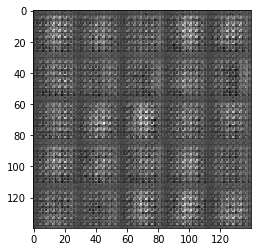

Epoch 1/2... Discriminator Loss: 1.0742... Generator Loss: 5.1640


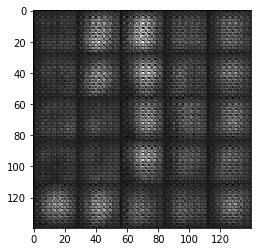

Epoch 1/2... Discriminator Loss: 1.5360... Generator Loss: 1.1884


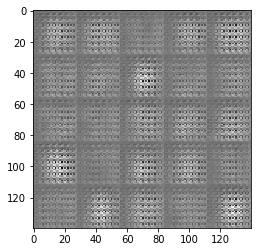

Epoch 1/2... Discriminator Loss: 1.4059... Generator Loss: 4.1031


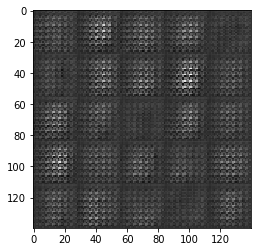

Epoch 1/2... Discriminator Loss: 2.1060... Generator Loss: 0.2817


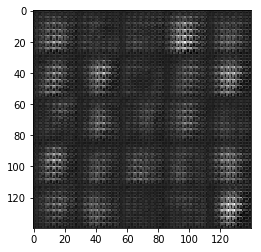

Epoch 1/2... Discriminator Loss: 2.5123... Generator Loss: 0.2938


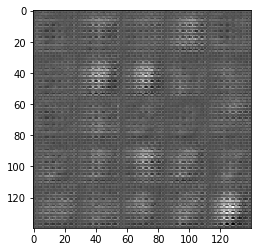

Epoch 1/2... Discriminator Loss: 1.2188... Generator Loss: 1.0310


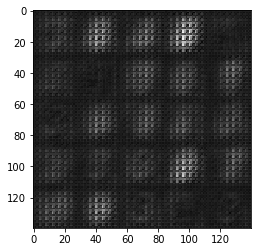

Epoch 1/2... Discriminator Loss: 1.6315... Generator Loss: 0.4373


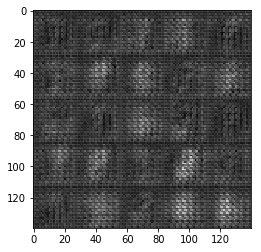

Epoch 1/2... Discriminator Loss: 2.7093... Generator Loss: 4.8857


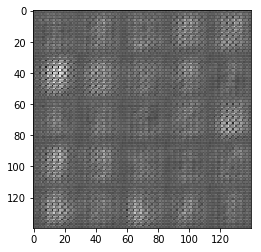

Epoch 1/2... Discriminator Loss: 1.5735... Generator Loss: 0.6318


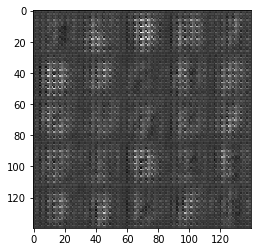

Epoch 1/2... Discriminator Loss: 3.9281... Generator Loss: 0.0699


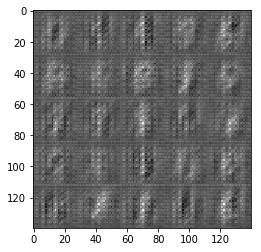

Epoch 1/2... Discriminator Loss: 2.1394... Generator Loss: 0.2811


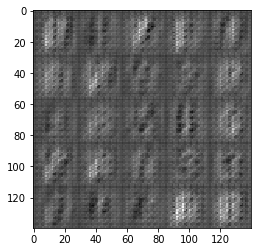

Epoch 1/2... Discriminator Loss: 3.6242... Generator Loss: 3.3381


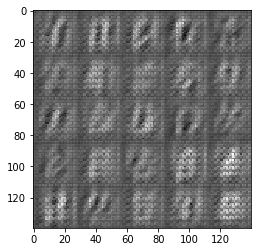

Epoch 1/2... Discriminator Loss: 2.0617... Generator Loss: 0.2572


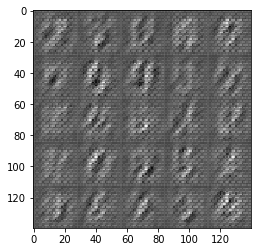

Epoch 1/2... Discriminator Loss: 2.8417... Generator Loss: 2.9649


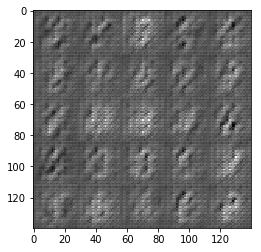

Epoch 1/2... Discriminator Loss: 1.1860... Generator Loss: 1.0436


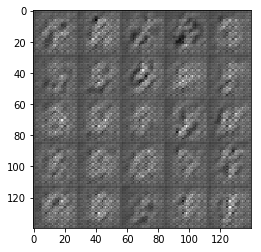

Epoch 1/2... Discriminator Loss: 1.3682... Generator Loss: 1.0957


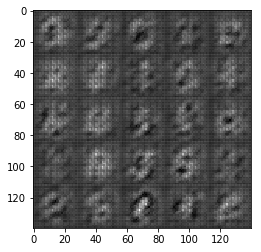

Epoch 1/2... Discriminator Loss: 1.5196... Generator Loss: 1.5804


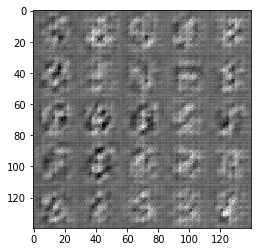

Epoch 1/2... Discriminator Loss: 1.6167... Generator Loss: 1.5651


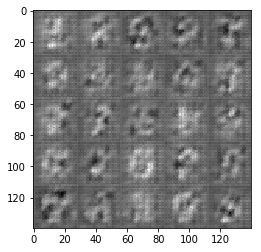

Epoch 1/2... Discriminator Loss: 1.1400... Generator Loss: 1.2507


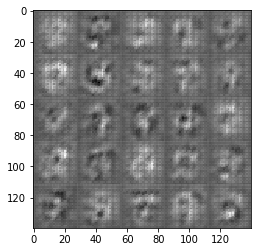

Epoch 1/2... Discriminator Loss: 2.9093... Generator Loss: 1.5289


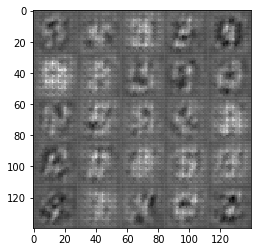

Epoch 1/2... Discriminator Loss: 3.1946... Generator Loss: 3.0629


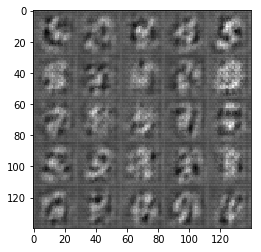

Epoch 1/2... Discriminator Loss: 2.1142... Generator Loss: 0.2466


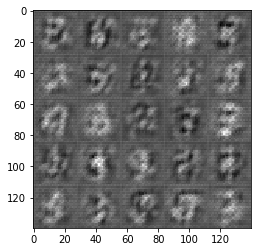

Epoch 1/2... Discriminator Loss: 2.1717... Generator Loss: 1.0973


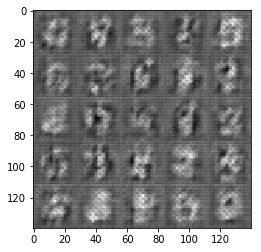

Epoch 1/2... Discriminator Loss: 1.5446... Generator Loss: 0.8616


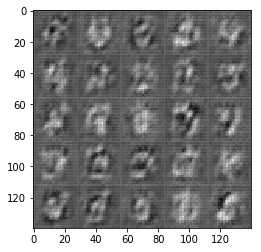

Epoch 1/2... Discriminator Loss: 1.0737... Generator Loss: 1.1575


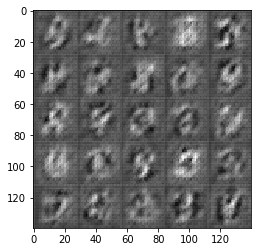

Epoch 1/2... Discriminator Loss: 3.0786... Generator Loss: 0.1452


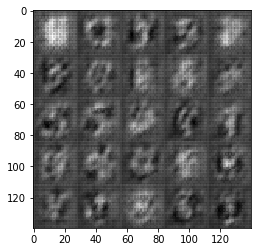

Epoch 1/2... Discriminator Loss: 1.7431... Generator Loss: 1.4870


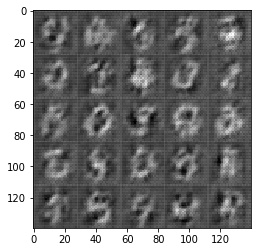

Epoch 1/2... Discriminator Loss: 1.0969... Generator Loss: 2.0437


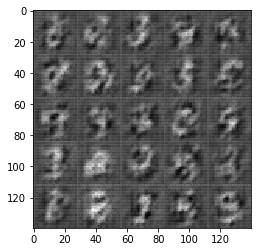

Epoch 1/2... Discriminator Loss: 2.8201... Generator Loss: 0.1264


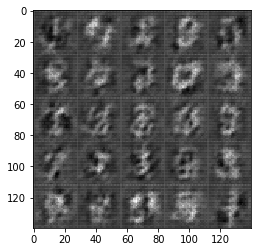

Epoch 1/2... Discriminator Loss: 2.0901... Generator Loss: 1.9883


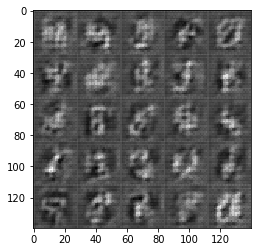

Epoch 1/2... Discriminator Loss: 1.3911... Generator Loss: 0.6252


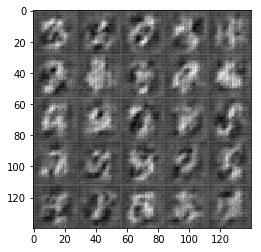

Epoch 1/2... Discriminator Loss: 1.7725... Generator Loss: 1.5235


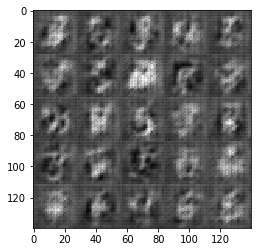

Epoch 1/2... Discriminator Loss: 1.1043... Generator Loss: 1.6201


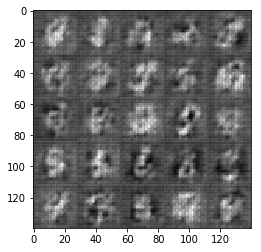

Epoch 1/2... Discriminator Loss: 1.7583... Generator Loss: 1.1044


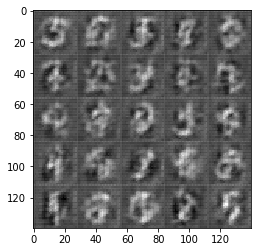

Epoch 1/2... Discriminator Loss: 1.8250... Generator Loss: 0.4590


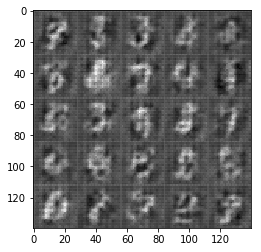

Epoch 1/2... Discriminator Loss: 1.7129... Generator Loss: 1.3271


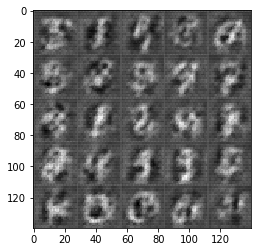

Epoch 1/2... Discriminator Loss: 1.3466... Generator Loss: 0.6852


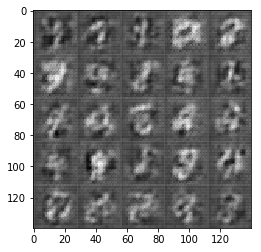

Epoch 1/2... Discriminator Loss: 1.9848... Generator Loss: 2.6446


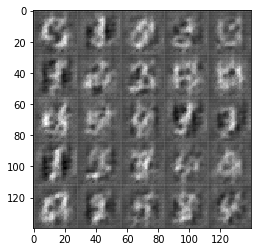

Epoch 1/2... Discriminator Loss: 1.8466... Generator Loss: 0.4204


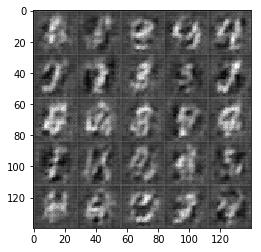

Epoch 1/2... Discriminator Loss: 1.4957... Generator Loss: 1.4926


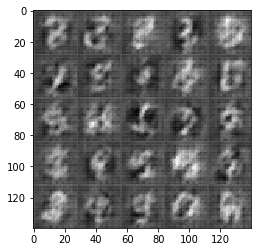

Epoch 1/2... Discriminator Loss: 2.2165... Generator Loss: 0.2201


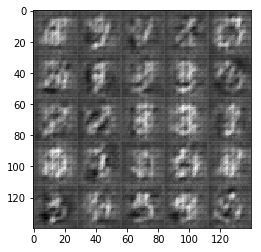

Epoch 1/2... Discriminator Loss: 1.6810... Generator Loss: 0.6540


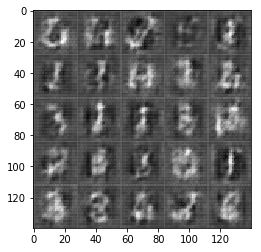

Epoch 1/2... Discriminator Loss: 1.5182... Generator Loss: 0.7647


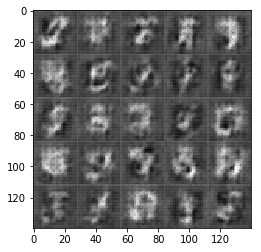

Epoch 1/2... Discriminator Loss: 1.6397... Generator Loss: 2.0445


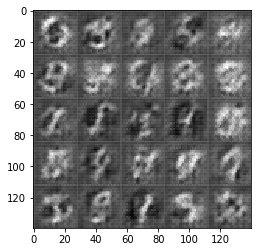

Epoch 1/2... Discriminator Loss: 1.3694... Generator Loss: 1.0860


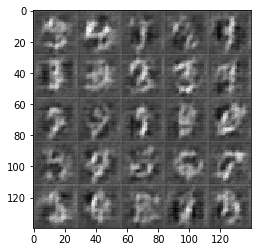

Epoch 1/2... Discriminator Loss: 0.8810... Generator Loss: 1.1201


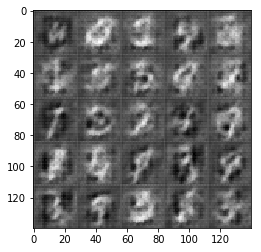

Epoch 1/2... Discriminator Loss: 2.9304... Generator Loss: 0.0942


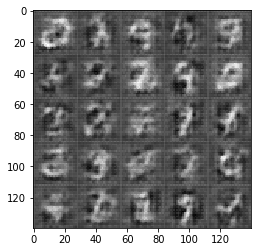

Epoch 1/2... Discriminator Loss: 1.9402... Generator Loss: 0.7733


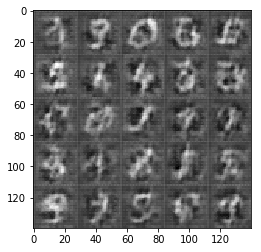

Epoch 1/2... Discriminator Loss: 1.5356... Generator Loss: 0.5897


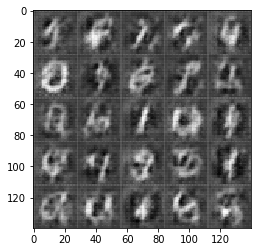

Epoch 1/2... Discriminator Loss: 1.1099... Generator Loss: 0.7135


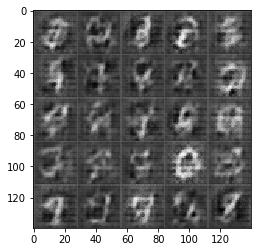

Epoch 1/2... Discriminator Loss: 2.3628... Generator Loss: 1.9602


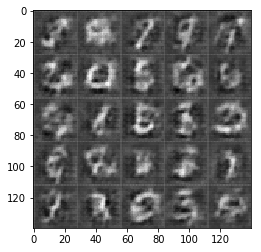

Epoch 1/2... Discriminator Loss: 1.1176... Generator Loss: 1.0838


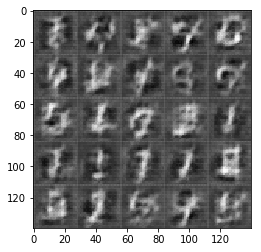

Epoch 1/2... Discriminator Loss: 1.6395... Generator Loss: 2.4407


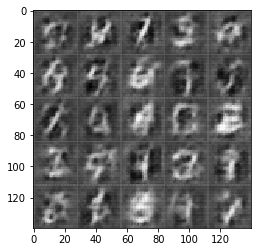

Epoch 1/2... Discriminator Loss: 2.2583... Generator Loss: 0.3637


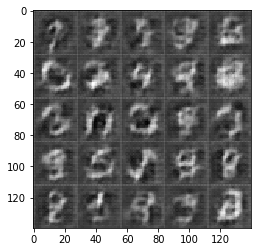

Epoch 1/2... Discriminator Loss: 3.1760... Generator Loss: 0.1294


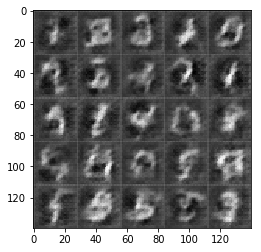

Epoch 1/2... Discriminator Loss: 2.6516... Generator Loss: 0.2870


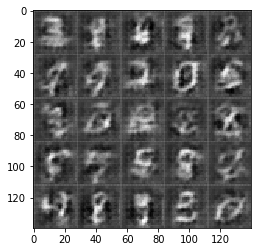

Epoch 1/2... Discriminator Loss: 1.9898... Generator Loss: 1.0136


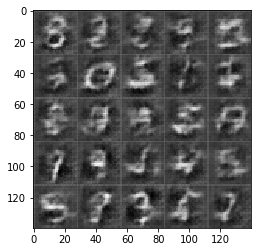

Epoch 1/2... Discriminator Loss: 1.6568... Generator Loss: 3.0218


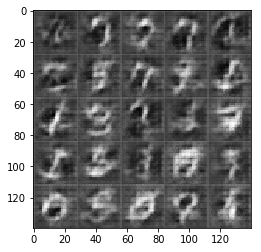

Epoch 1/2... Discriminator Loss: 2.6517... Generator Loss: 0.1677


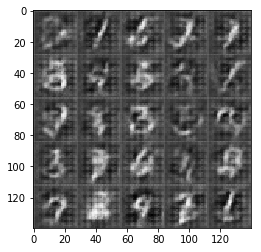

Epoch 1/2... Discriminator Loss: 1.9972... Generator Loss: 2.4180


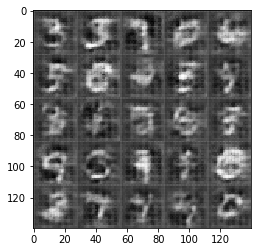

Epoch 1/2... Discriminator Loss: 1.1043... Generator Loss: 0.8527


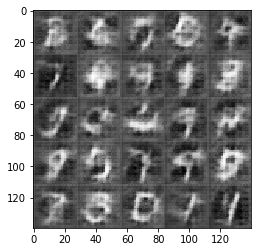

Epoch 1/2... Discriminator Loss: 1.8134... Generator Loss: 0.8551


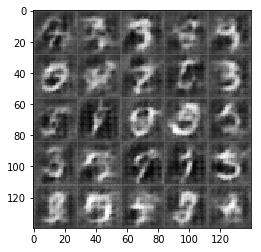

Epoch 1/2... Discriminator Loss: 1.0303... Generator Loss: 1.3487


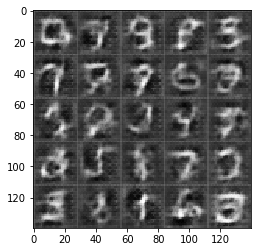

Epoch 1/2... Discriminator Loss: 1.2019... Generator Loss: 1.4245


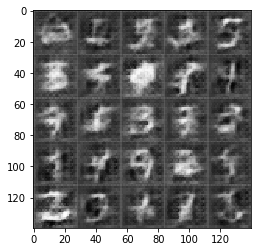

Epoch 1/2... Discriminator Loss: 1.6262... Generator Loss: 0.4363


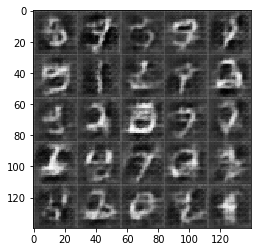

Epoch 1/2... Discriminator Loss: 2.0344... Generator Loss: 3.2308


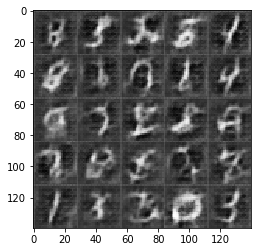

Epoch 1/2... Discriminator Loss: 0.9194... Generator Loss: 1.5355


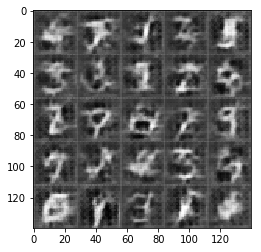

Epoch 1/2... Discriminator Loss: 1.0551... Generator Loss: 1.0267


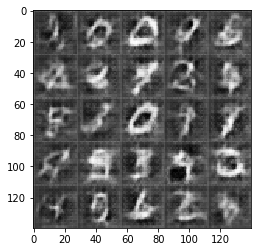

Epoch 1/2... Discriminator Loss: 1.0393... Generator Loss: 2.1487


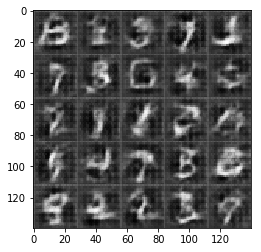

Epoch 1/2... Discriminator Loss: 1.1483... Generator Loss: 1.2346


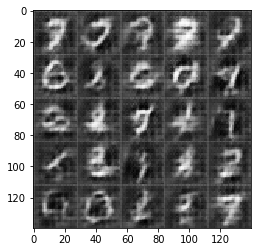

Epoch 1/2... Discriminator Loss: 1.1758... Generator Loss: 1.7474


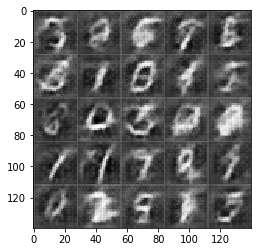

Epoch 1/2... Discriminator Loss: 1.2386... Generator Loss: 0.7255


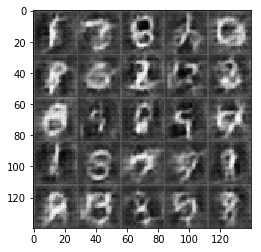

Epoch 1/2... Discriminator Loss: 2.4817... Generator Loss: 3.1268


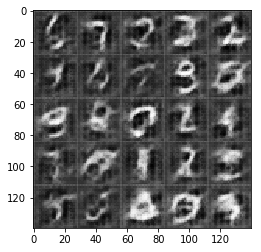

Epoch 1/2... Discriminator Loss: 1.4112... Generator Loss: 1.7744


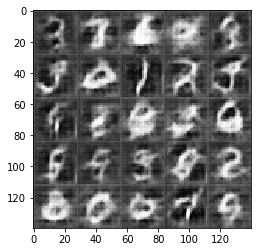

Epoch 1/2... Discriminator Loss: 0.9946... Generator Loss: 1.1082


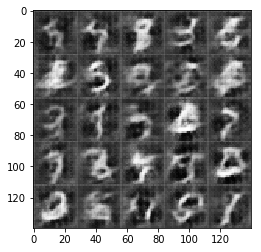

Epoch 1/2... Discriminator Loss: 2.2750... Generator Loss: 0.2674


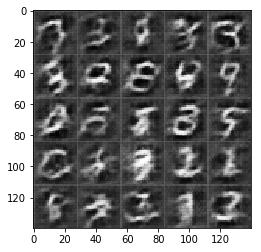

Epoch 1/2... Discriminator Loss: 1.3011... Generator Loss: 1.8701


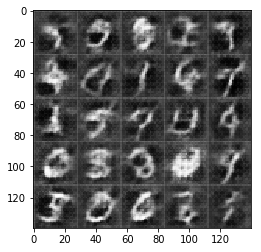

Epoch 1/2... Discriminator Loss: 2.2305... Generator Loss: 0.3313


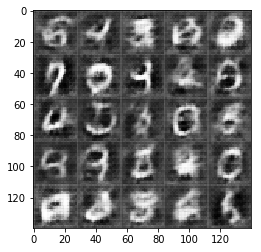

Epoch 1/2... Discriminator Loss: 2.2834... Generator Loss: 0.4886


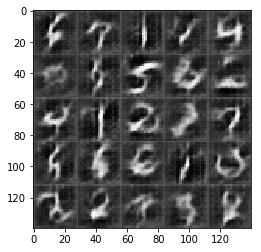

Epoch 1/2... Discriminator Loss: 1.6387... Generator Loss: 0.5717


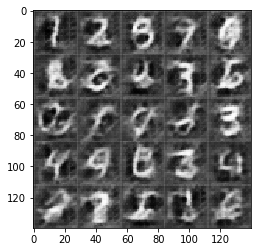

Epoch 1/2... Discriminator Loss: 1.0135... Generator Loss: 1.2257


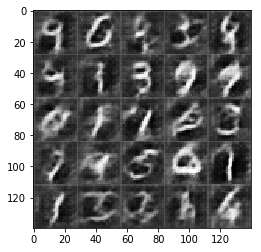

Epoch 1/2... Discriminator Loss: 1.5922... Generator Loss: 0.5683


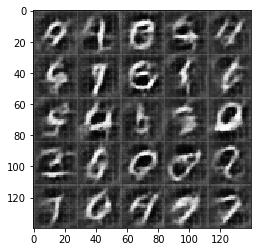

Epoch 1/2... Discriminator Loss: 1.0763... Generator Loss: 1.5957


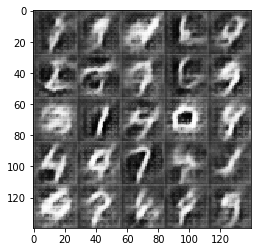

Epoch 1/2... Discriminator Loss: 2.3021... Generator Loss: 3.1985


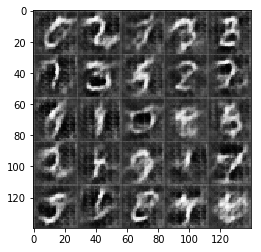

Epoch 1/2... Discriminator Loss: 1.4153... Generator Loss: 0.6872


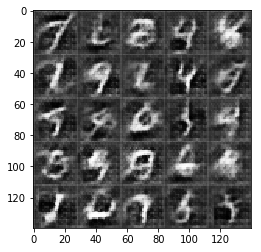

Epoch 1/2... Discriminator Loss: 1.2457... Generator Loss: 0.8040


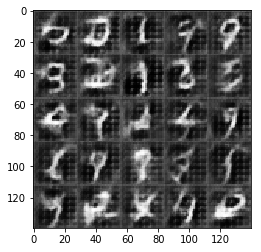

Epoch 1/2... Discriminator Loss: 1.5252... Generator Loss: 0.5500


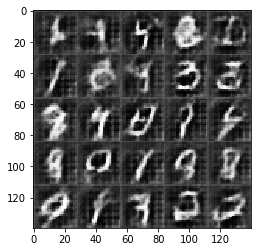

Epoch 1/2... Discriminator Loss: 2.2734... Generator Loss: 0.2512


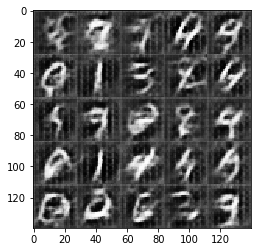

Epoch 1/2... Discriminator Loss: 1.3210... Generator Loss: 0.7455


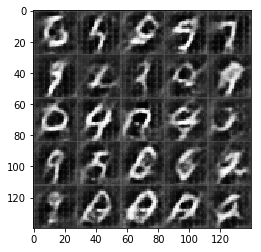

Epoch 1/2... Discriminator Loss: 1.0440... Generator Loss: 1.3890


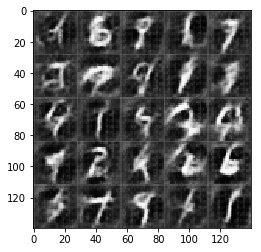

Epoch 1/2... Discriminator Loss: 1.2386... Generator Loss: 0.7815


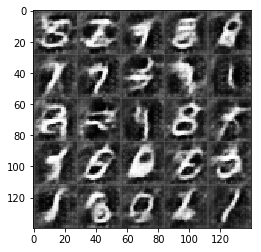

Epoch 1/2... Discriminator Loss: 1.8676... Generator Loss: 1.9146


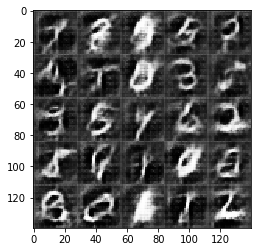

Epoch 1/2... Discriminator Loss: 0.9228... Generator Loss: 1.8328


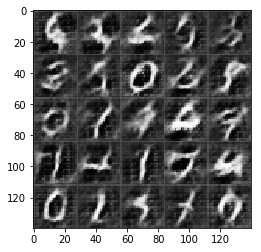

Epoch 1/2... Discriminator Loss: 1.1888... Generator Loss: 1.3283


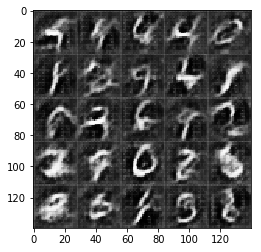

Epoch 1/2... Discriminator Loss: 1.9621... Generator Loss: 0.3479


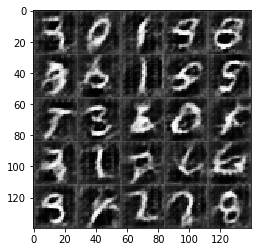

Epoch 1/2... Discriminator Loss: 1.0647... Generator Loss: 0.9173


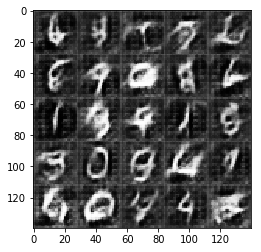

Epoch 1/2... Discriminator Loss: 0.9487... Generator Loss: 1.7998


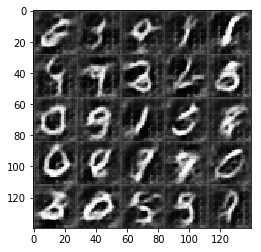

Epoch 1/2... Discriminator Loss: 1.1398... Generator Loss: 1.2337


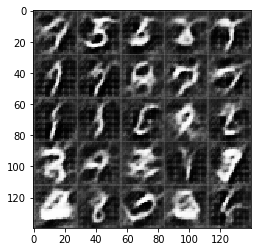

Epoch 1/2... Discriminator Loss: 1.1403... Generator Loss: 0.9138


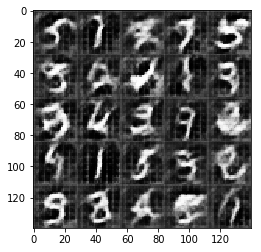

Epoch 1/2... Discriminator Loss: 0.9719... Generator Loss: 1.8298


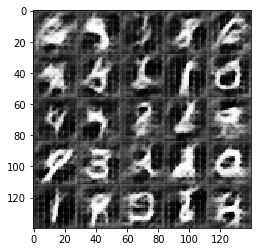

Epoch 1/2... Discriminator Loss: 0.9669... Generator Loss: 1.6115


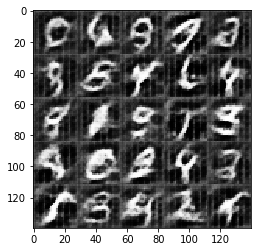

Epoch 1/2... Discriminator Loss: 1.5588... Generator Loss: 0.7185


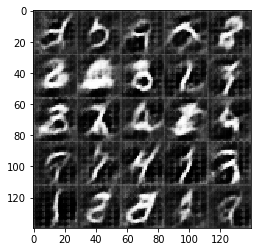

Epoch 1/2... Discriminator Loss: 0.9821... Generator Loss: 1.3266


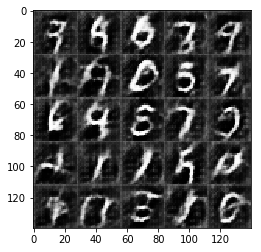

Epoch 1/2... Discriminator Loss: 2.4158... Generator Loss: 0.3203


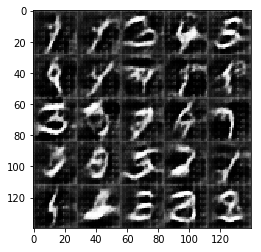

Epoch 1/2... Discriminator Loss: 1.3375... Generator Loss: 1.5849


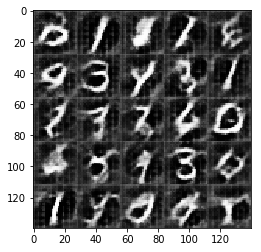

Epoch 1/2... Discriminator Loss: 1.1322... Generator Loss: 0.8889


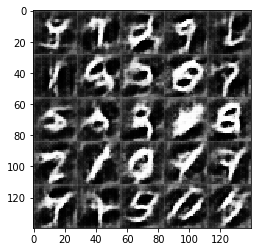

Epoch 1/2... Discriminator Loss: 2.7116... Generator Loss: 0.2134


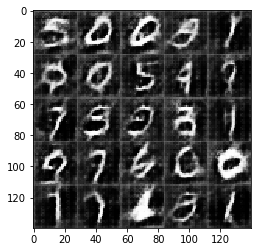

Epoch 1/2... Discriminator Loss: 1.2404... Generator Loss: 1.1203


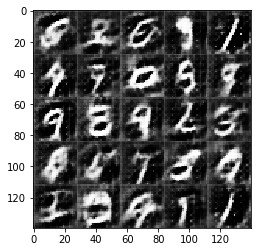

Epoch 1/2... Discriminator Loss: 1.9158... Generator Loss: 0.5763


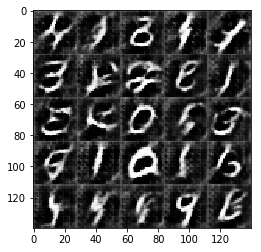

Epoch 1/2... Discriminator Loss: 1.2242... Generator Loss: 1.0521


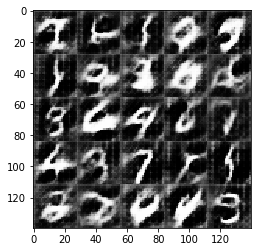

Epoch 1/2... Discriminator Loss: 0.7315... Generator Loss: 1.8224


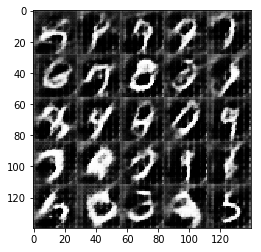

Epoch 1/2... Discriminator Loss: 2.2169... Generator Loss: 4.2661


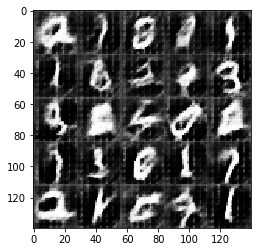

Epoch 1/2... Discriminator Loss: 2.0230... Generator Loss: 0.3908


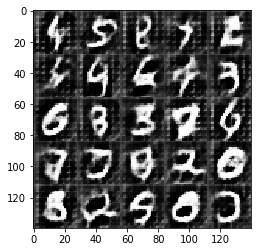

Epoch 1/2... Discriminator Loss: 2.4600... Generator Loss: 0.2748


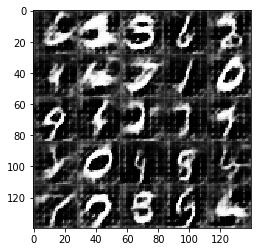

Epoch 1/2... Discriminator Loss: 0.8917... Generator Loss: 1.4651


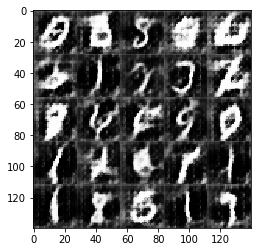

Epoch 1/2... Discriminator Loss: 0.9826... Generator Loss: 1.3093


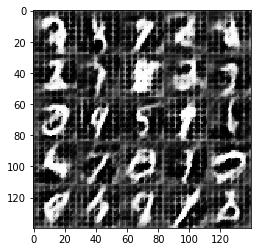

Epoch 1/2... Discriminator Loss: 1.0489... Generator Loss: 1.0744


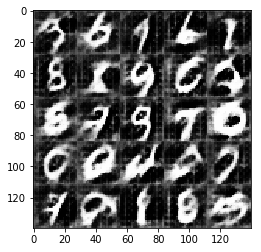

Epoch 1/2... Discriminator Loss: 1.7952... Generator Loss: 0.4501


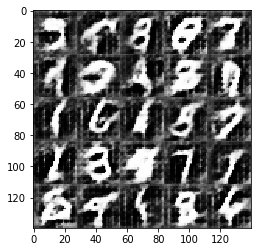

Epoch 1/2... Discriminator Loss: 0.9585... Generator Loss: 1.8951


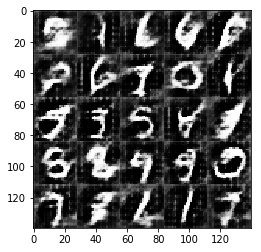

Epoch 1/2... Discriminator Loss: 2.1017... Generator Loss: 0.3684


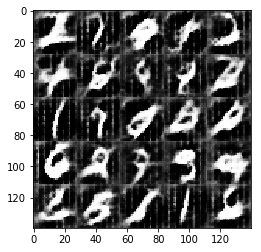

Epoch 1/2... Discriminator Loss: 1.3698... Generator Loss: 1.4163


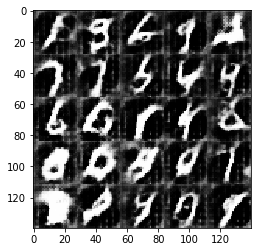

Epoch 1/2... Discriminator Loss: 1.1407... Generator Loss: 2.6431


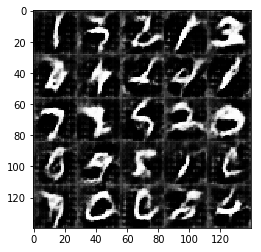

Epoch 1/2... Discriminator Loss: 1.0938... Generator Loss: 1.3885


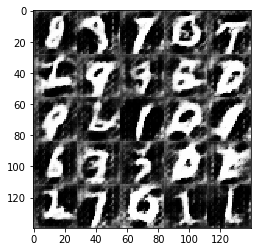

Epoch 1/2... Discriminator Loss: 1.7719... Generator Loss: 0.5136


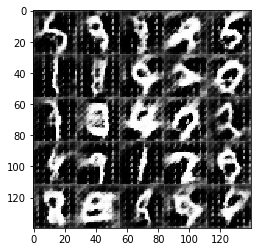

Epoch 1/2... Discriminator Loss: 1.0142... Generator Loss: 0.9150


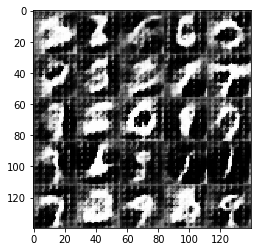

Epoch 1/2... Discriminator Loss: 1.2657... Generator Loss: 1.0447


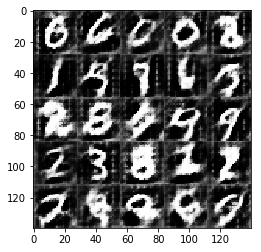

Epoch 1/2... Discriminator Loss: 0.8185... Generator Loss: 1.3523


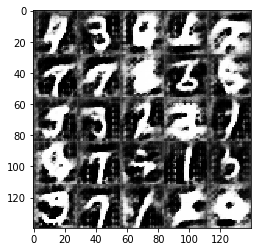

Epoch 1/2... Discriminator Loss: 1.2401... Generator Loss: 0.9386


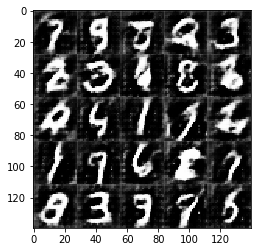

Epoch 1/2... Discriminator Loss: 1.1092... Generator Loss: 2.4481


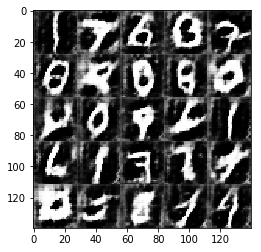

Epoch 1/2... Discriminator Loss: 0.9444... Generator Loss: 1.2176


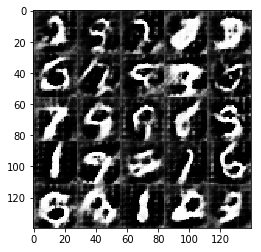

Epoch 1/2... Discriminator Loss: 1.8234... Generator Loss: 0.5686


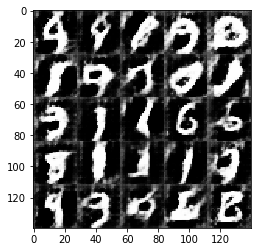

Epoch 1/2... Discriminator Loss: 0.9733... Generator Loss: 1.6933


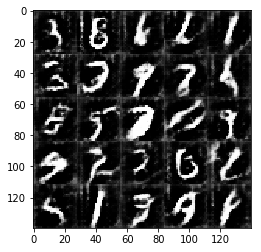

Epoch 1/2... Discriminator Loss: 1.1665... Generator Loss: 0.7649


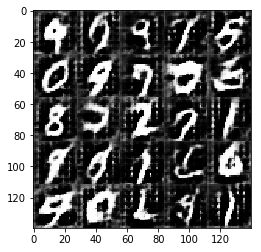

Epoch 1/2... Discriminator Loss: 1.5059... Generator Loss: 2.9724


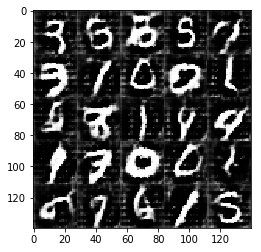

Epoch 1/2... Discriminator Loss: 1.0843... Generator Loss: 0.9441


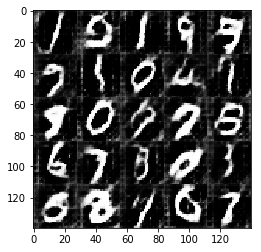

Epoch 1/2... Discriminator Loss: 1.3205... Generator Loss: 0.8846


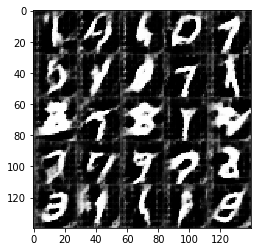

Epoch 1/2... Discriminator Loss: 2.2879... Generator Loss: 0.2671


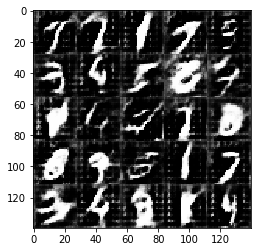

Epoch 1/2... Discriminator Loss: 1.3081... Generator Loss: 2.1997


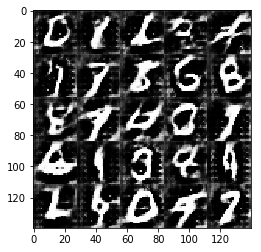

Epoch 1/2... Discriminator Loss: 1.5073... Generator Loss: 0.7524


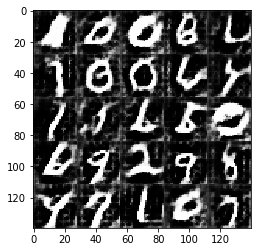

Epoch 1/2... Discriminator Loss: 2.7562... Generator Loss: 0.1634


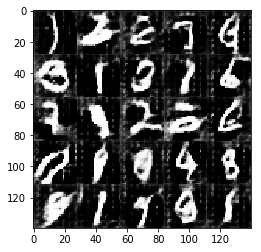

Epoch 1/2... Discriminator Loss: 1.9940... Generator Loss: 0.3883


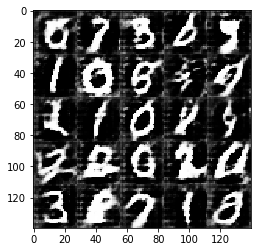

Epoch 1/2... Discriminator Loss: 1.8524... Generator Loss: 0.4331


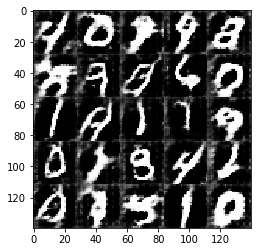

Epoch 1/2... Discriminator Loss: 0.9784... Generator Loss: 0.9976


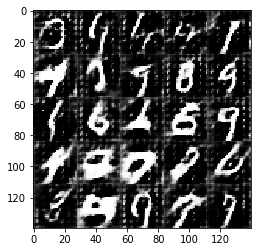

Epoch 1/2... Discriminator Loss: 1.4662... Generator Loss: 0.5722


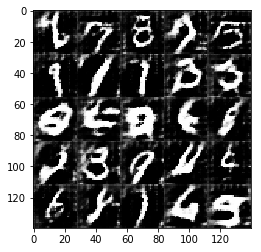

Epoch 1/2... Discriminator Loss: 1.0619... Generator Loss: 0.9389


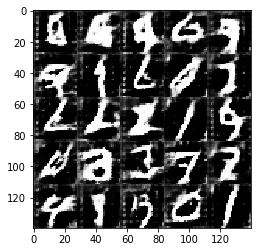

Epoch 1/2... Discriminator Loss: 2.2333... Generator Loss: 3.8509


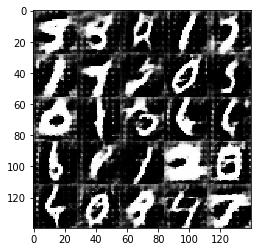

Epoch 1/2... Discriminator Loss: 1.0236... Generator Loss: 1.0731


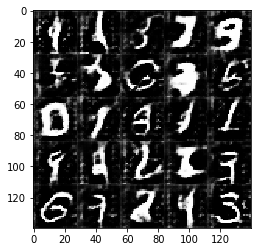

Epoch 1/2... Discriminator Loss: 0.9225... Generator Loss: 1.9282


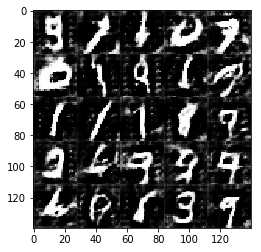

Epoch 1/2... Discriminator Loss: 1.2068... Generator Loss: 1.0511


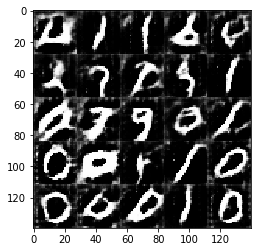

Epoch 1/2... Discriminator Loss: 1.3326... Generator Loss: 0.7818


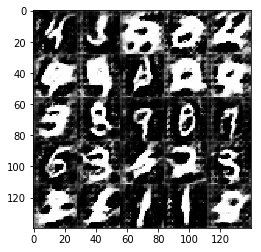

Epoch 1/2... Discriminator Loss: 1.6769... Generator Loss: 0.5393


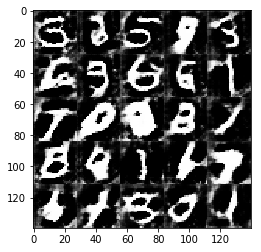

Epoch 1/2... Discriminator Loss: 1.3764... Generator Loss: 1.6047


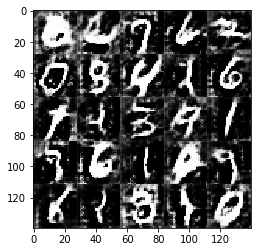

Epoch 1/2... Discriminator Loss: 1.9873... Generator Loss: 0.4386


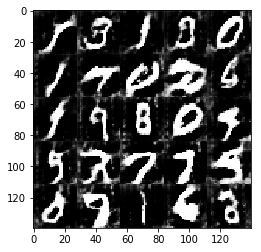

Epoch 1/2... Discriminator Loss: 1.2039... Generator Loss: 0.8409


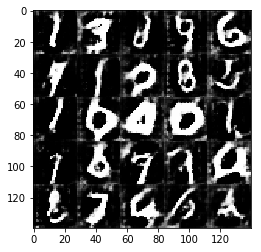

Epoch 1/2... Discriminator Loss: 0.9942... Generator Loss: 1.3815


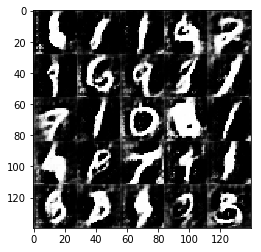

Epoch 1/2... Discriminator Loss: 1.2518... Generator Loss: 1.5353


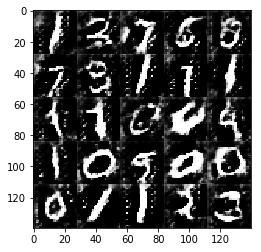

Epoch 1/2... Discriminator Loss: 2.4501... Generator Loss: 0.3823


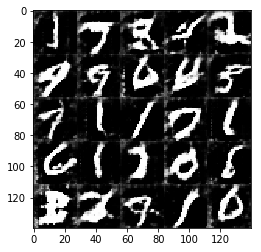

Epoch 1/2... Discriminator Loss: 2.2113... Generator Loss: 0.3064


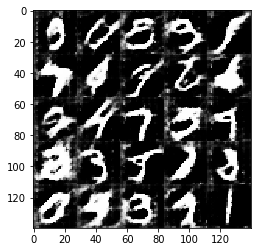

Epoch 1/2... Discriminator Loss: 0.9939... Generator Loss: 1.6240


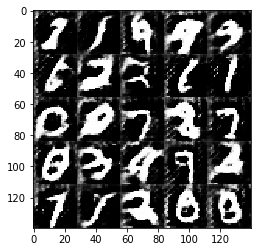

Epoch 1/2... Discriminator Loss: 1.1420... Generator Loss: 1.0913


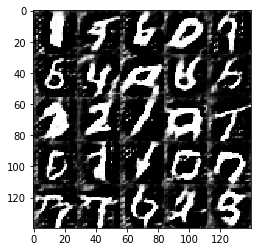

Epoch 1/2... Discriminator Loss: 0.8451... Generator Loss: 1.3837


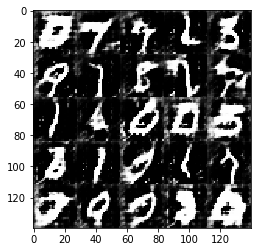

Epoch 1/2... Discriminator Loss: 1.4407... Generator Loss: 0.5934


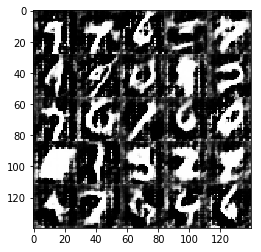

Epoch 1/2... Discriminator Loss: 2.1331... Generator Loss: 0.2668


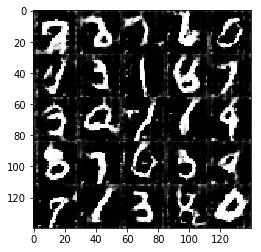

Epoch 1/2... Discriminator Loss: 1.6044... Generator Loss: 0.9944


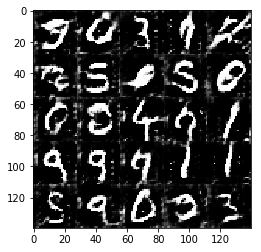

Epoch 1/2... Discriminator Loss: 0.8468... Generator Loss: 1.3305


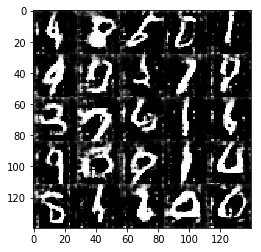

Epoch 1/2... Discriminator Loss: 1.1572... Generator Loss: 1.1818


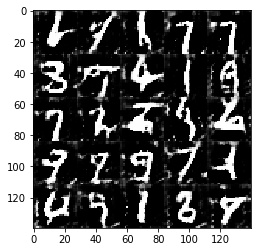

Epoch 1/2... Discriminator Loss: 1.1161... Generator Loss: 0.9127


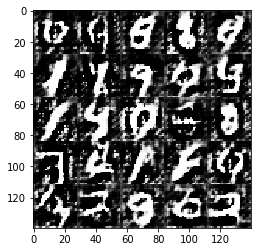

Epoch 1/2... Discriminator Loss: 1.3017... Generator Loss: 0.9660


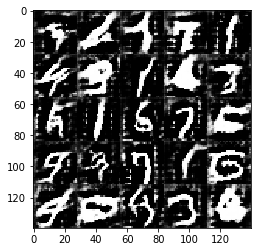

Epoch 1/2... Discriminator Loss: 2.7518... Generator Loss: 0.1398


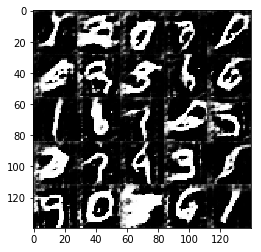

Epoch 1/2... Discriminator Loss: 1.0333... Generator Loss: 2.5645


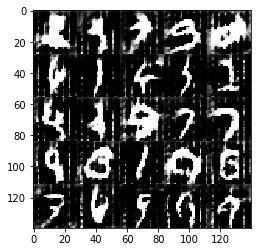

Epoch 1/2... Discriminator Loss: 0.9235... Generator Loss: 1.1216


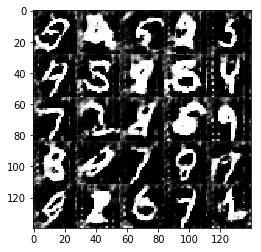

Epoch 1/2... Discriminator Loss: 1.2389... Generator Loss: 1.0805


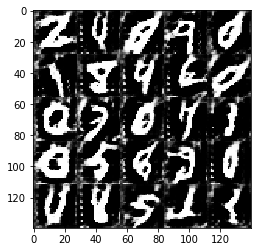

Epoch 1/2... Discriminator Loss: 1.2043... Generator Loss: 0.9151


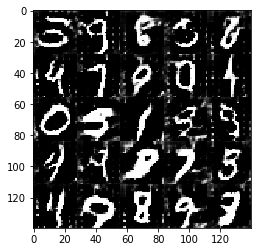

Epoch 1/2... Discriminator Loss: 0.6883... Generator Loss: 1.7056


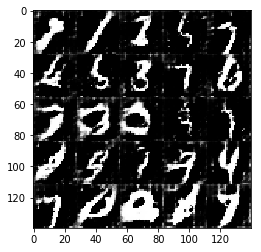

Epoch 1/2... Discriminator Loss: 2.8708... Generator Loss: 0.2456


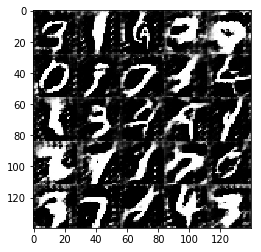

Epoch 1/2... Discriminator Loss: 1.5569... Generator Loss: 0.6046


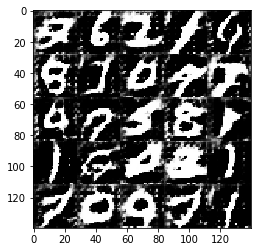

Epoch 1/2... Discriminator Loss: 1.0614... Generator Loss: 1.1301


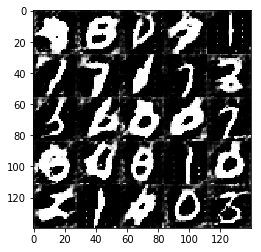

Epoch 1/2... Discriminator Loss: 0.9962... Generator Loss: 1.0716


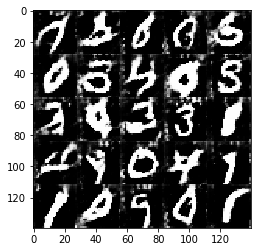

Epoch 1/2... Discriminator Loss: 1.1135... Generator Loss: 0.8899


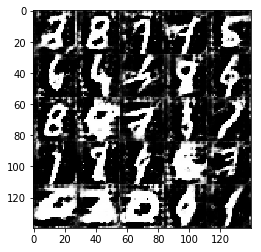

Epoch 1/2... Discriminator Loss: 1.6662... Generator Loss: 0.4101


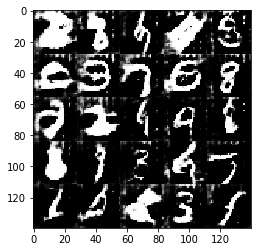

Epoch 1/2... Discriminator Loss: 1.6407... Generator Loss: 0.5262


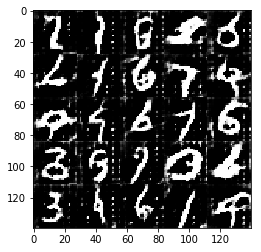

Epoch 1/2... Discriminator Loss: 1.1366... Generator Loss: 2.0198


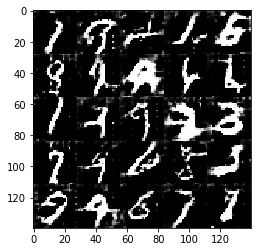

Epoch 1/2... Discriminator Loss: 1.0608... Generator Loss: 0.8805


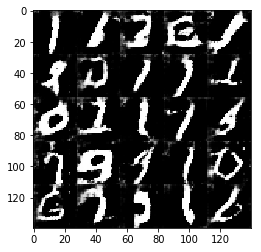

Epoch 1/2... Discriminator Loss: 2.1297... Generator Loss: 0.2689


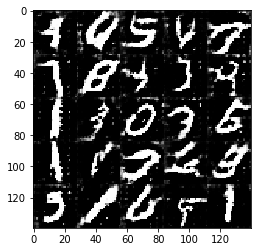

Epoch 1/2... Discriminator Loss: 1.5057... Generator Loss: 0.7819


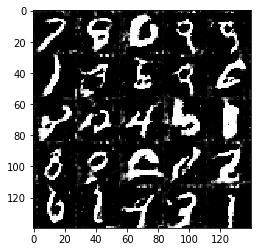

Epoch 1/2... Discriminator Loss: 1.1085... Generator Loss: 1.5341


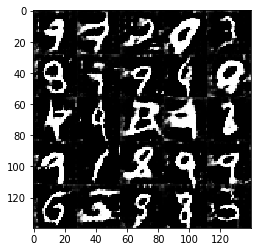

Epoch 2/2... Discriminator Loss: 0.7864... Generator Loss: 1.5019


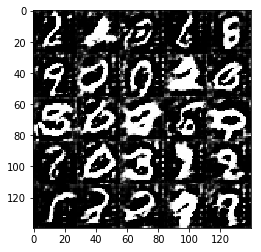

Epoch 2/2... Discriminator Loss: 1.2873... Generator Loss: 0.8066


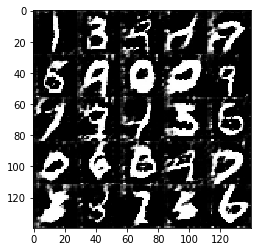

Epoch 2/2... Discriminator Loss: 1.3851... Generator Loss: 0.6237


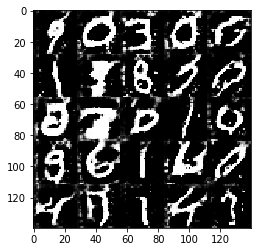

Epoch 2/2... Discriminator Loss: 2.0967... Generator Loss: 0.3378


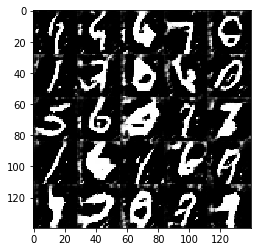

Epoch 2/2... Discriminator Loss: 1.9815... Generator Loss: 0.3407


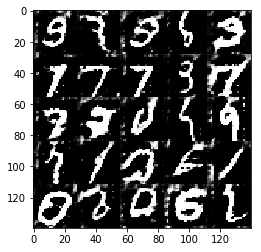

Epoch 2/2... Discriminator Loss: 1.3600... Generator Loss: 0.8076


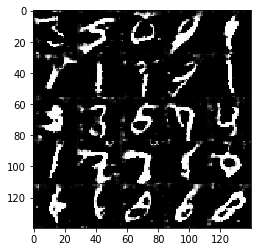

Epoch 2/2... Discriminator Loss: 1.2141... Generator Loss: 0.8674


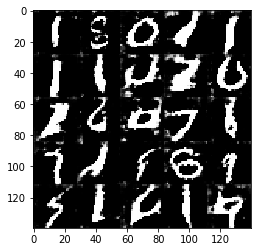

Epoch 2/2... Discriminator Loss: 0.8946... Generator Loss: 1.4386


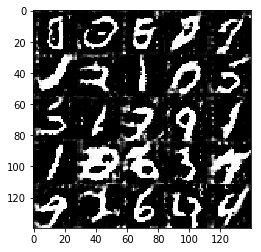

Epoch 2/2... Discriminator Loss: 1.1880... Generator Loss: 0.8897


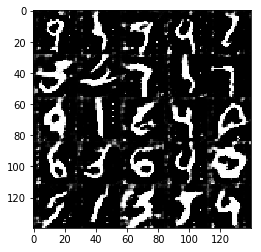

Epoch 2/2... Discriminator Loss: 1.9640... Generator Loss: 0.6943


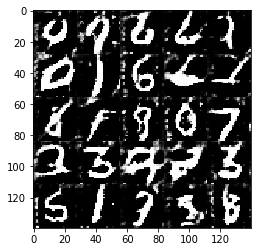

Epoch 2/2... Discriminator Loss: 1.2583... Generator Loss: 0.7801


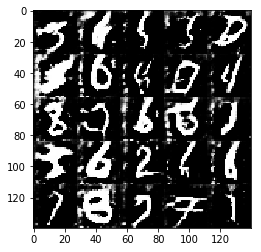

Epoch 2/2... Discriminator Loss: 0.6908... Generator Loss: 1.6959


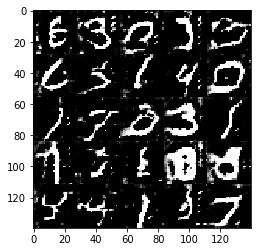

Epoch 2/2... Discriminator Loss: 1.4660... Generator Loss: 0.7762


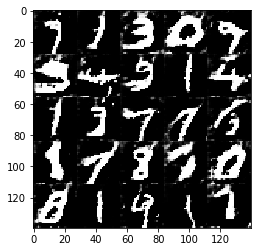

Epoch 2/2... Discriminator Loss: 1.2232... Generator Loss: 0.8231


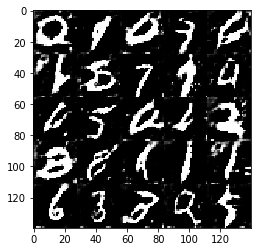

Epoch 2/2... Discriminator Loss: 0.6690... Generator Loss: 1.8075


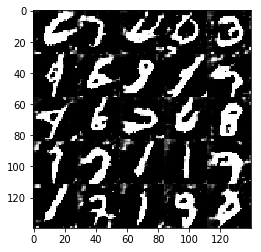

Epoch 2/2... Discriminator Loss: 1.0035... Generator Loss: 1.0736


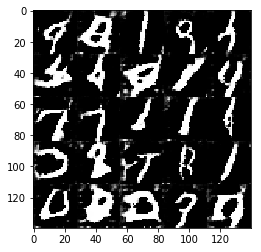

Epoch 2/2... Discriminator Loss: 3.6518... Generator Loss: 0.0870


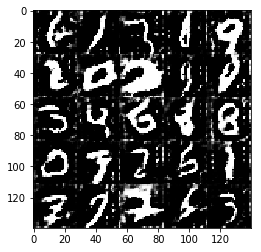

Epoch 2/2... Discriminator Loss: 1.1137... Generator Loss: 0.8457


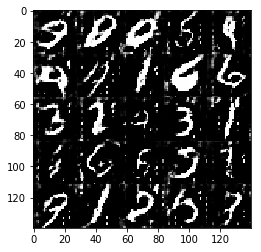

Epoch 2/2... Discriminator Loss: 0.8527... Generator Loss: 1.1934


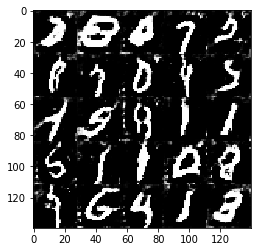

Epoch 2/2... Discriminator Loss: 0.7700... Generator Loss: 1.6414


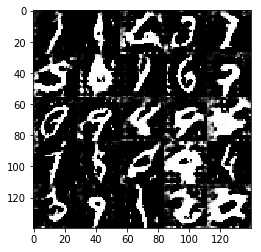

Epoch 2/2... Discriminator Loss: 1.0191... Generator Loss: 1.0694


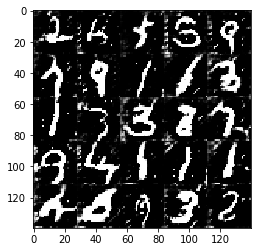

Epoch 2/2... Discriminator Loss: 0.8651... Generator Loss: 2.7596


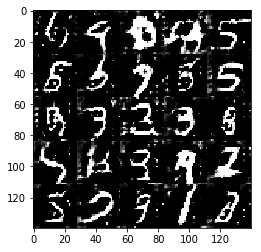

Epoch 2/2... Discriminator Loss: 1.3667... Generator Loss: 0.6483


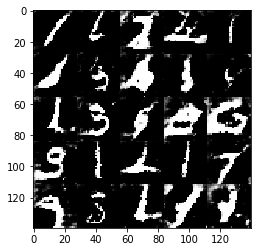

Epoch 2/2... Discriminator Loss: 1.7026... Generator Loss: 0.6352


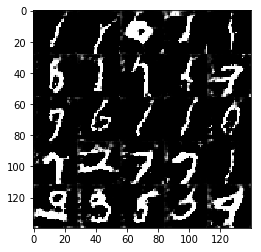

Epoch 2/2... Discriminator Loss: 0.7438... Generator Loss: 1.6119


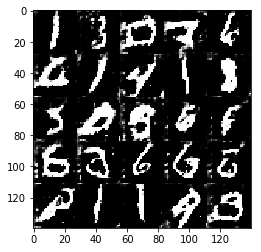

Epoch 2/2... Discriminator Loss: 0.9193... Generator Loss: 1.2199


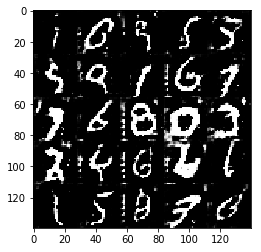

Epoch 2/2... Discriminator Loss: 1.0263... Generator Loss: 1.3241


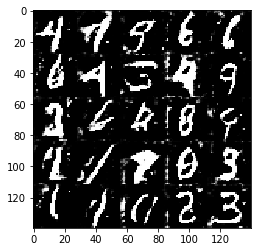

Epoch 2/2... Discriminator Loss: 1.7465... Generator Loss: 1.6456


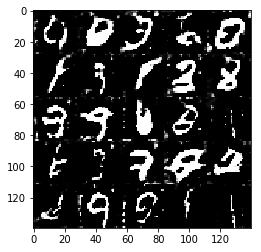

Epoch 2/2... Discriminator Loss: 1.0785... Generator Loss: 0.8683


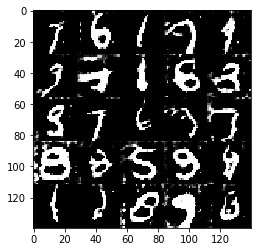

Epoch 2/2... Discriminator Loss: 1.5979... Generator Loss: 0.5449


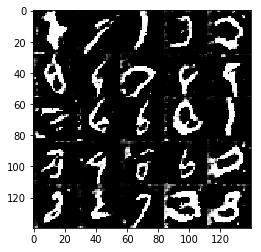

Epoch 2/2... Discriminator Loss: 1.4243... Generator Loss: 0.6683


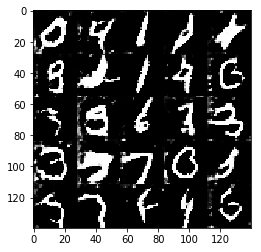

Epoch 2/2... Discriminator Loss: 2.0033... Generator Loss: 0.3602


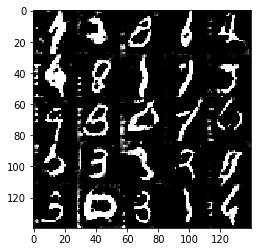

Epoch 2/2... Discriminator Loss: 1.6344... Generator Loss: 0.4635


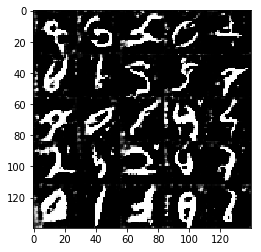

Epoch 2/2... Discriminator Loss: 1.3552... Generator Loss: 0.6993


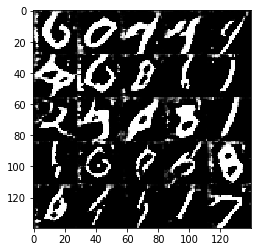

Epoch 2/2... Discriminator Loss: 1.2247... Generator Loss: 0.8258


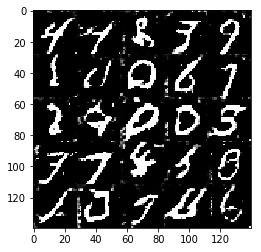

Epoch 2/2... Discriminator Loss: 1.5537... Generator Loss: 0.6803


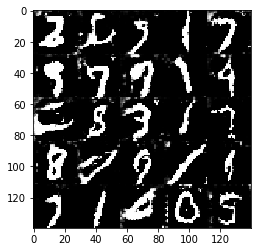

Epoch 2/2... Discriminator Loss: 0.9067... Generator Loss: 1.4142


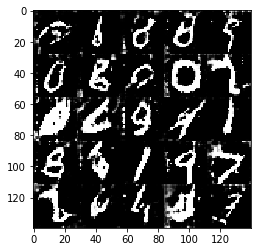

Epoch 2/2... Discriminator Loss: 1.3140... Generator Loss: 0.7438


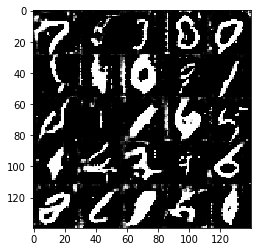

Epoch 2/2... Discriminator Loss: 1.6025... Generator Loss: 0.4525


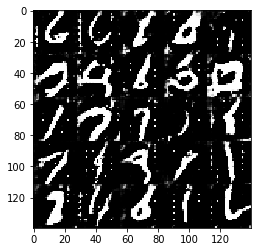

Epoch 2/2... Discriminator Loss: 0.7105... Generator Loss: 2.0319


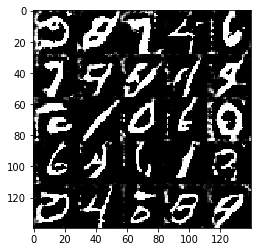

Epoch 2/2... Discriminator Loss: 2.1456... Generator Loss: 0.3011


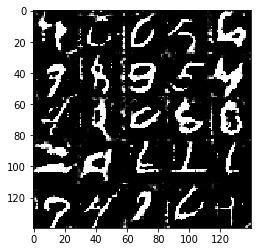

Epoch 2/2... Discriminator Loss: 0.8223... Generator Loss: 1.4500


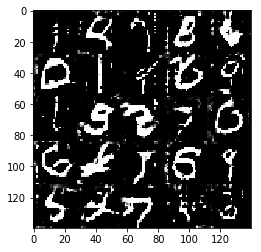

Epoch 2/2... Discriminator Loss: 0.5128... Generator Loss: 2.8697


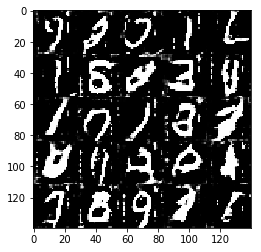

Epoch 2/2... Discriminator Loss: 1.0604... Generator Loss: 1.0173


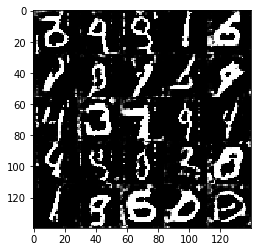

Epoch 2/2... Discriminator Loss: 0.7837... Generator Loss: 1.5118


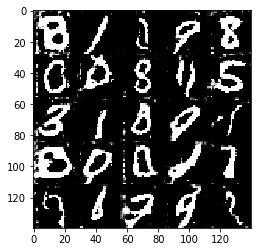

Epoch 2/2... Discriminator Loss: 0.6481... Generator Loss: 2.1668


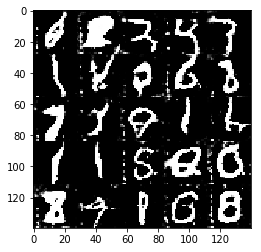

Epoch 2/2... Discriminator Loss: 0.8084... Generator Loss: 1.5661


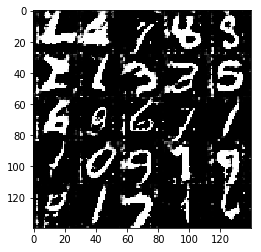

Epoch 2/2... Discriminator Loss: 0.8723... Generator Loss: 2.5271


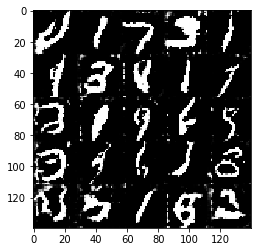

Epoch 2/2... Discriminator Loss: 0.6217... Generator Loss: 2.0111


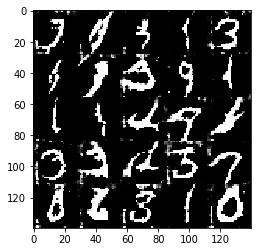

Epoch 2/2... Discriminator Loss: 0.7365... Generator Loss: 1.5930


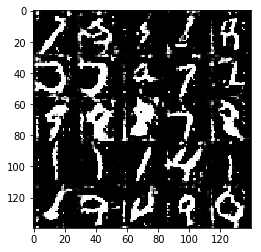

Epoch 2/2... Discriminator Loss: 2.2788... Generator Loss: 0.3132


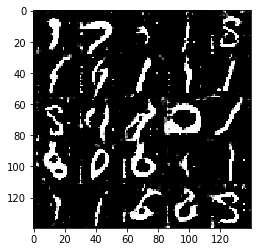

Epoch 2/2... Discriminator Loss: 0.6122... Generator Loss: 1.9113


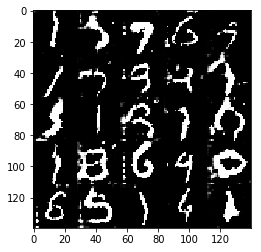

Epoch 2/2... Discriminator Loss: 0.9071... Generator Loss: 1.2045


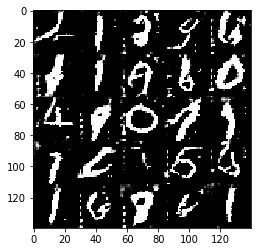

Epoch 2/2... Discriminator Loss: 0.7213... Generator Loss: 2.1636


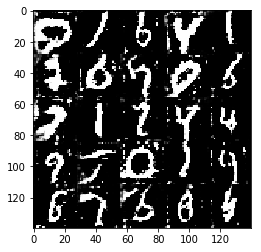

Epoch 2/2... Discriminator Loss: 0.9540... Generator Loss: 1.4958


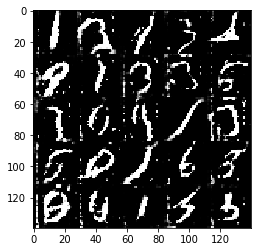

Epoch 2/2... Discriminator Loss: 0.8683... Generator Loss: 1.7351


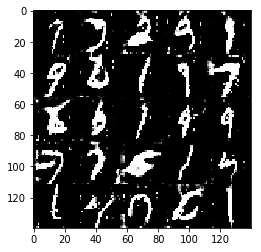

Epoch 2/2... Discriminator Loss: 0.6842... Generator Loss: 1.6506


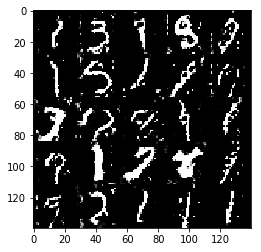

Epoch 2/2... Discriminator Loss: 0.9651... Generator Loss: 1.1622


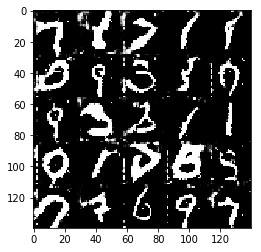

Epoch 2/2... Discriminator Loss: 1.0248... Generator Loss: 2.5601


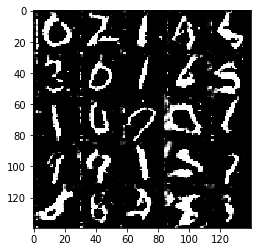

Epoch 2/2... Discriminator Loss: 1.2872... Generator Loss: 0.6227


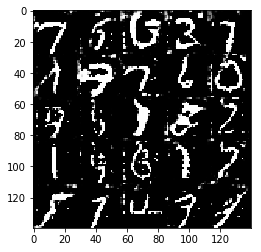

Epoch 2/2... Discriminator Loss: 1.2501... Generator Loss: 0.8573


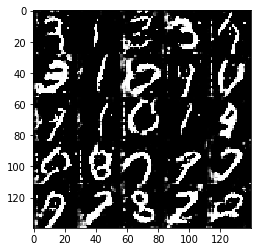

Epoch 2/2... Discriminator Loss: 1.8498... Generator Loss: 0.6923


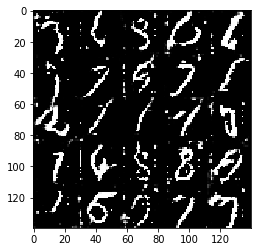

Epoch 2/2... Discriminator Loss: 0.8709... Generator Loss: 1.7727


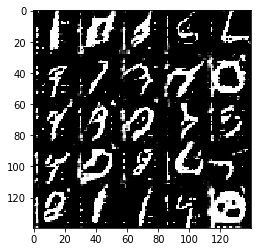

Epoch 2/2... Discriminator Loss: 0.7814... Generator Loss: 1.6627


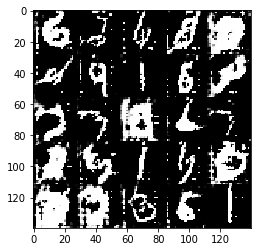

Epoch 2/2... Discriminator Loss: 0.9528... Generator Loss: 1.6834


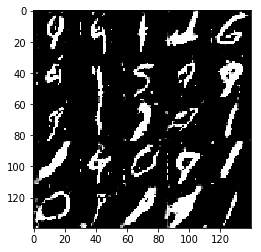

Epoch 2/2... Discriminator Loss: 0.7995... Generator Loss: 1.6195


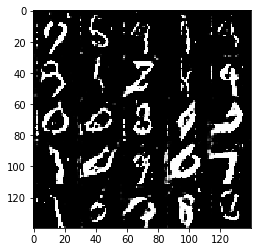

Epoch 2/2... Discriminator Loss: 3.6014... Generator Loss: 0.1121


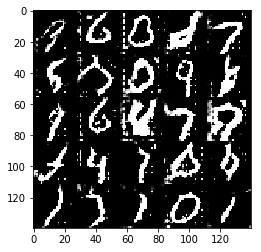

Epoch 2/2... Discriminator Loss: 1.8994... Generator Loss: 0.3768


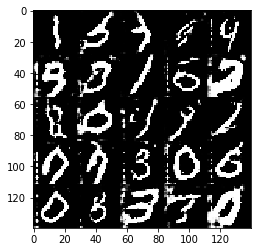

Epoch 2/2... Discriminator Loss: 1.2504... Generator Loss: 1.0090


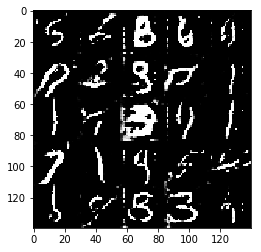

Epoch 2/2... Discriminator Loss: 0.7890... Generator Loss: 1.5937


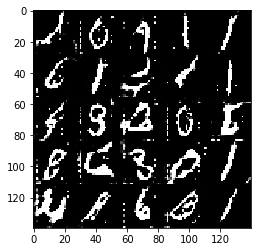

Epoch 2/2... Discriminator Loss: 0.7882... Generator Loss: 1.3483


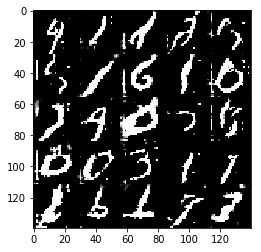

Epoch 2/2... Discriminator Loss: 2.0840... Generator Loss: 0.5254


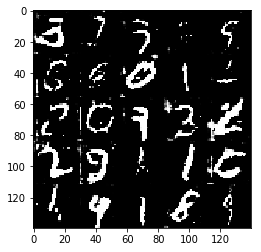

Epoch 2/2... Discriminator Loss: 0.6934... Generator Loss: 1.7787


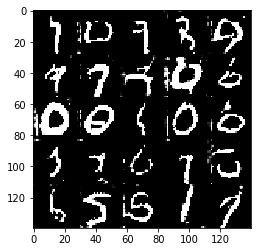

Epoch 2/2... Discriminator Loss: 0.5354... Generator Loss: 2.4948


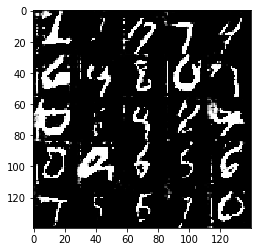

Epoch 2/2... Discriminator Loss: 1.5519... Generator Loss: 0.9933


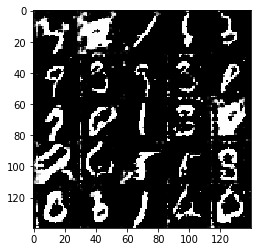

Epoch 2/2... Discriminator Loss: 0.9479... Generator Loss: 1.2160


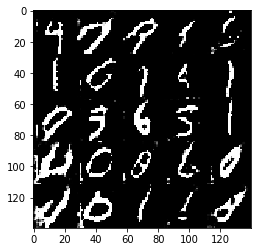

Epoch 2/2... Discriminator Loss: 0.9579... Generator Loss: 1.9417


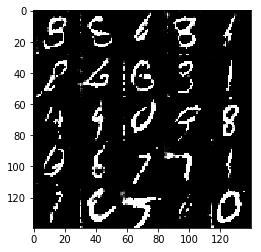

Epoch 2/2... Discriminator Loss: 1.7073... Generator Loss: 0.6241


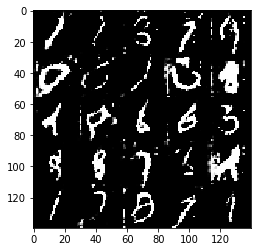

Epoch 2/2... Discriminator Loss: 1.3107... Generator Loss: 0.5932


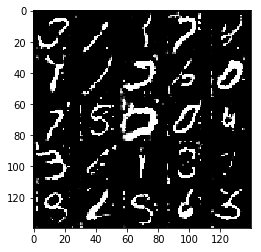

Epoch 2/2... Discriminator Loss: 0.9191... Generator Loss: 1.4294


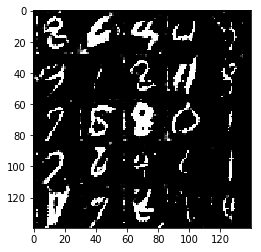

Epoch 2/2... Discriminator Loss: 1.0001... Generator Loss: 0.9872


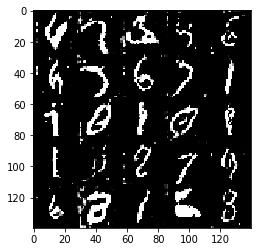

Epoch 2/2... Discriminator Loss: 2.4138... Generator Loss: 0.3391


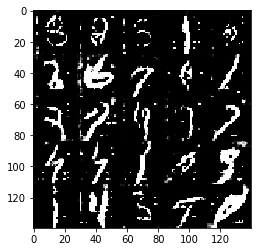

Epoch 2/2... Discriminator Loss: 1.7473... Generator Loss: 1.1731


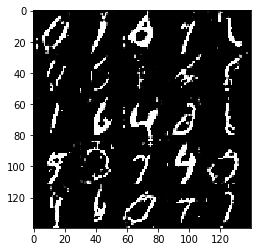

Epoch 2/2... Discriminator Loss: 1.2238... Generator Loss: 0.7429


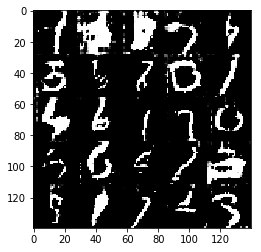

Epoch 2/2... Discriminator Loss: 0.8926... Generator Loss: 1.3271


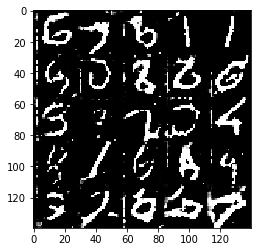

Epoch 2/2... Discriminator Loss: 1.8943... Generator Loss: 0.4150


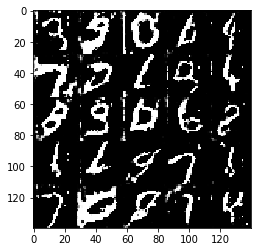

Epoch 2/2... Discriminator Loss: 1.0814... Generator Loss: 0.9735


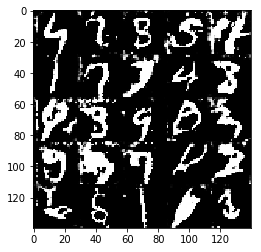

Epoch 2/2... Discriminator Loss: 1.2578... Generator Loss: 0.7545


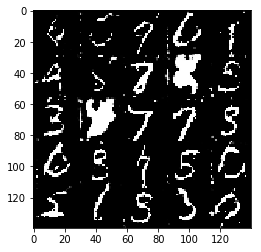

Epoch 2/2... Discriminator Loss: 1.1418... Generator Loss: 4.3982


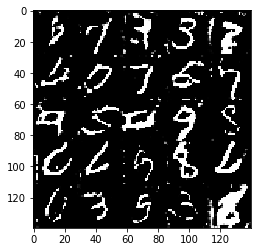

Epoch 2/2... Discriminator Loss: 1.2795... Generator Loss: 5.3618


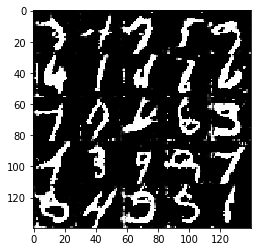

Epoch 2/2... Discriminator Loss: 1.0594... Generator Loss: 1.5075


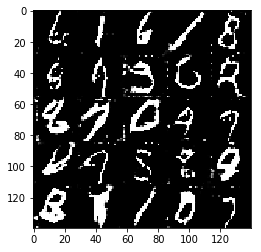

Epoch 2/2... Discriminator Loss: 1.0330... Generator Loss: 1.3884


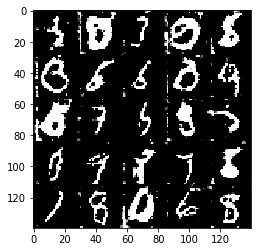

Epoch 2/2... Discriminator Loss: 0.6821... Generator Loss: 2.0418


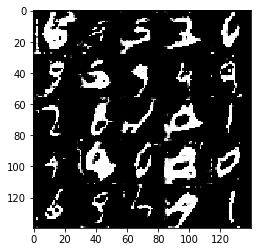

Epoch 2/2... Discriminator Loss: 0.6856... Generator Loss: 1.9799


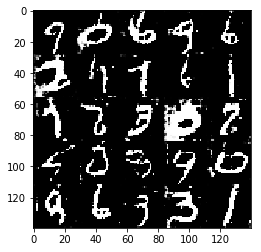

Epoch 2/2... Discriminator Loss: 0.9726... Generator Loss: 1.2402


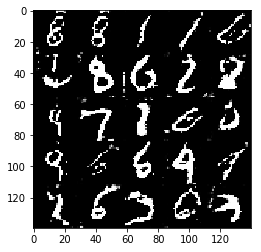

Epoch 2/2... Discriminator Loss: 0.7840... Generator Loss: 2.1464


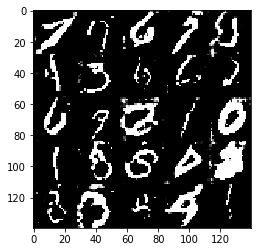

Epoch 2/2... Discriminator Loss: 0.9157... Generator Loss: 1.0959


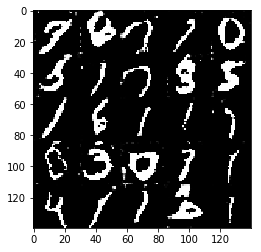

Epoch 2/2... Discriminator Loss: 0.8443... Generator Loss: 2.9287


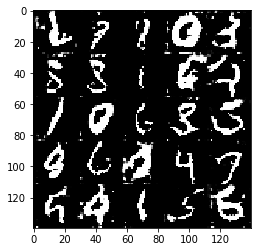

Epoch 2/2... Discriminator Loss: 1.4479... Generator Loss: 0.6507


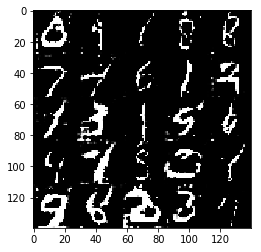

Epoch 2/2... Discriminator Loss: 0.8649... Generator Loss: 1.2677


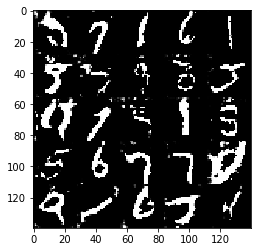

Epoch 2/2... Discriminator Loss: 0.7073... Generator Loss: 1.7199


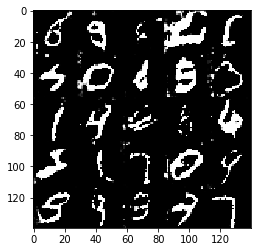

Epoch 2/2... Discriminator Loss: 1.7508... Generator Loss: 0.4752


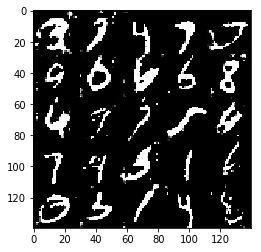

Epoch 2/2... Discriminator Loss: 0.8681... Generator Loss: 1.4199


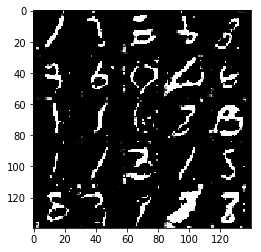

Epoch 2/2... Discriminator Loss: 0.6906... Generator Loss: 2.0806


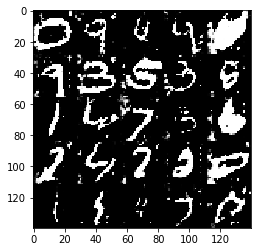

Epoch 2/2... Discriminator Loss: 0.7333... Generator Loss: 1.9495


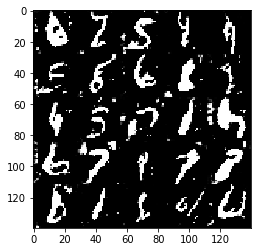

Epoch 2/2... Discriminator Loss: 0.7056... Generator Loss: 2.2337


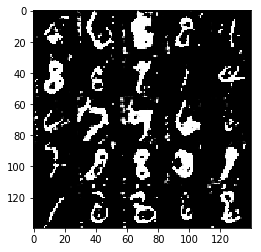

Epoch 2/2... Discriminator Loss: 0.9947... Generator Loss: 0.9077


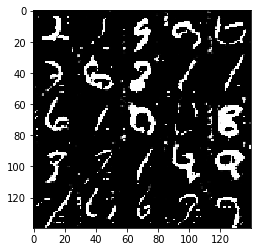

Epoch 2/2... Discriminator Loss: 0.8592... Generator Loss: 1.3400


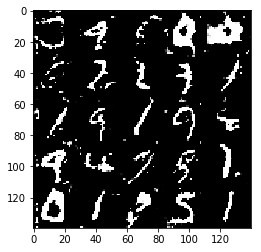

Epoch 2/2... Discriminator Loss: 1.0741... Generator Loss: 0.8783


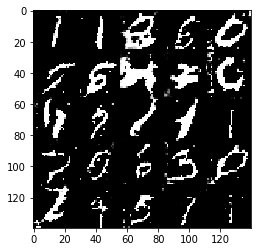

Epoch 2/2... Discriminator Loss: 1.3304... Generator Loss: 1.6097


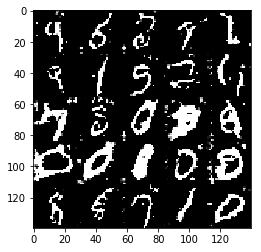

Epoch 2/2... Discriminator Loss: 2.7587... Generator Loss: 0.3340


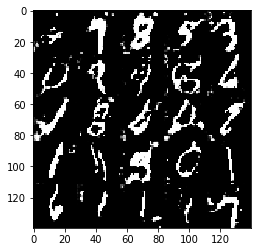

Epoch 2/2... Discriminator Loss: 1.6920... Generator Loss: 0.4598


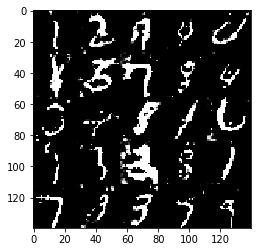

Epoch 2/2... Discriminator Loss: 2.0280... Generator Loss: 0.4397


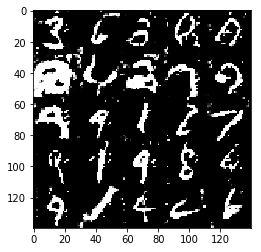

Epoch 2/2... Discriminator Loss: 1.6617... Generator Loss: 0.7838


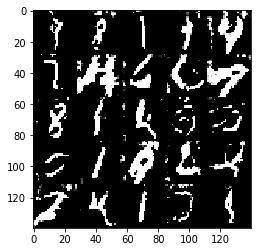

Epoch 2/2... Discriminator Loss: 0.9595... Generator Loss: 1.2944


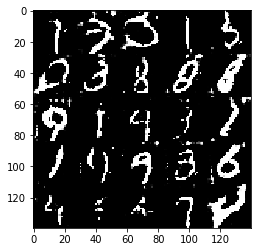

Epoch 2/2... Discriminator Loss: 0.7535... Generator Loss: 1.6208


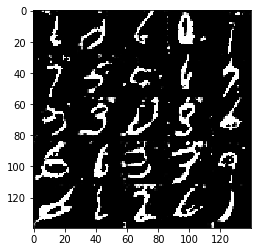

Epoch 2/2... Discriminator Loss: 1.1253... Generator Loss: 0.9328


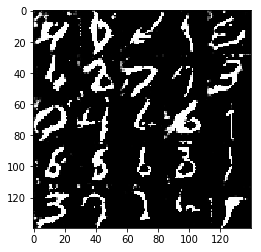

Epoch 2/2... Discriminator Loss: 1.2609... Generator Loss: 0.8202


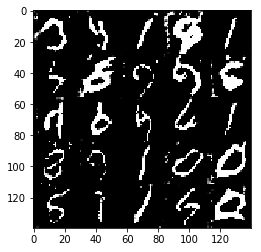

Epoch 2/2... Discriminator Loss: 0.7842... Generator Loss: 1.1728


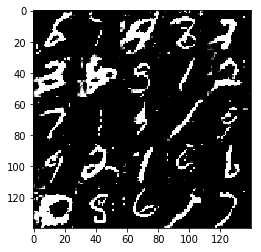

Epoch 2/2... Discriminator Loss: 1.8111... Generator Loss: 0.5507


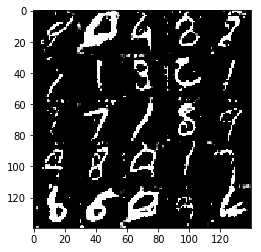

Epoch 2/2... Discriminator Loss: 1.2022... Generator Loss: 0.9162


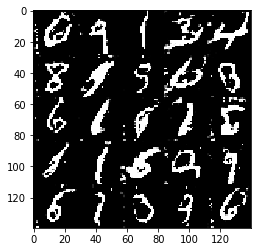

Epoch 2/2... Discriminator Loss: 1.3777... Generator Loss: 0.7312


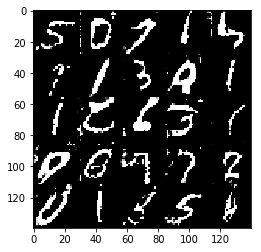

Epoch 2/2... Discriminator Loss: 2.0066... Generator Loss: 0.3610


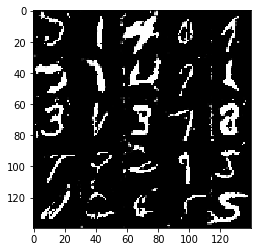

Epoch 2/2... Discriminator Loss: 1.0239... Generator Loss: 1.0230


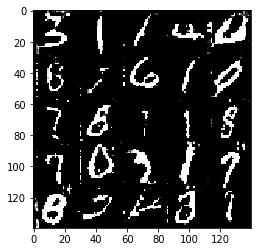

Epoch 2/2... Discriminator Loss: 0.8331... Generator Loss: 1.2929


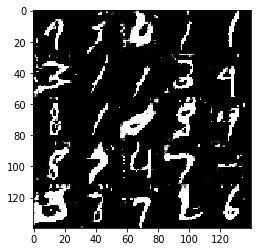

Epoch 2/2... Discriminator Loss: 1.1367... Generator Loss: 0.8413


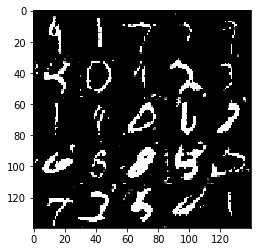

Epoch 2/2... Discriminator Loss: 1.0551... Generator Loss: 1.1871


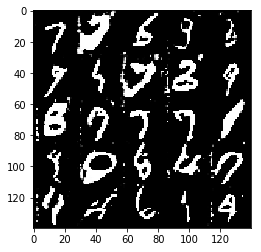

Epoch 2/2... Discriminator Loss: 0.9079... Generator Loss: 1.1972


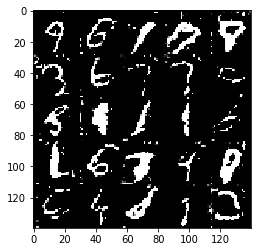

Epoch 2/2... Discriminator Loss: 0.8940... Generator Loss: 1.3670


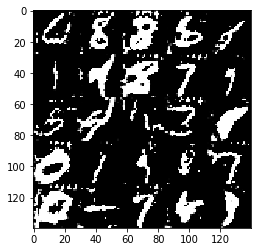

Epoch 2/2... Discriminator Loss: 1.4133... Generator Loss: 0.6739


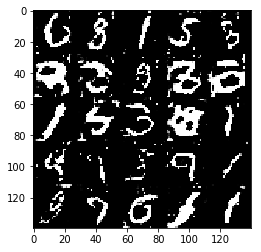

Epoch 2/2... Discriminator Loss: 0.9936... Generator Loss: 1.4391


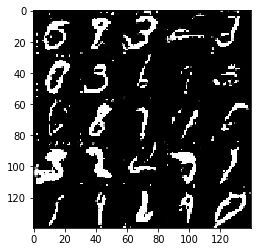

Epoch 2/2... Discriminator Loss: 1.0105... Generator Loss: 1.1684


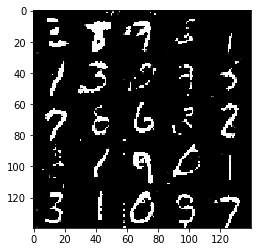

Epoch 2/2... Discriminator Loss: 0.7182... Generator Loss: 1.7120


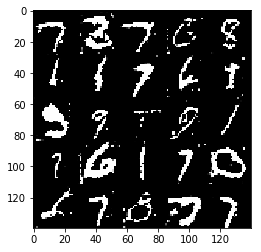

Epoch 2/2... Discriminator Loss: 1.0540... Generator Loss: 0.8815


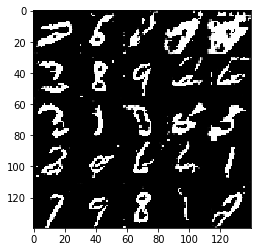

Epoch 2/2... Discriminator Loss: 0.9519... Generator Loss: 2.5508


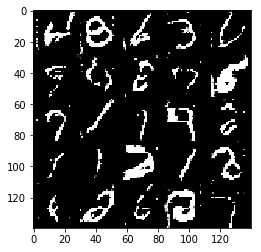

Epoch 2/2... Discriminator Loss: 1.9266... Generator Loss: 0.5015


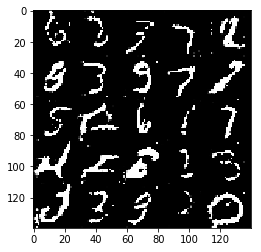

Epoch 2/2... Discriminator Loss: 0.7506... Generator Loss: 1.4245


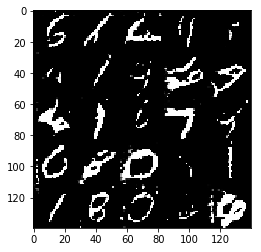

Epoch 2/2... Discriminator Loss: 1.3694... Generator Loss: 0.6929


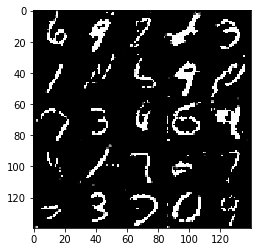

Epoch 2/2... Discriminator Loss: 1.4992... Generator Loss: 0.6034


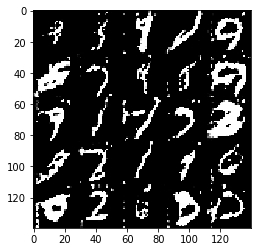

Epoch 2/2... Discriminator Loss: 0.6921... Generator Loss: 1.6221


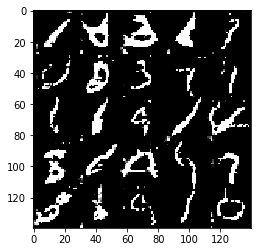

Epoch 2/2... Discriminator Loss: 0.9542... Generator Loss: 1.0506


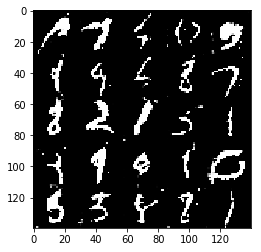

Epoch 2/2... Discriminator Loss: 1.9844... Generator Loss: 4.1257


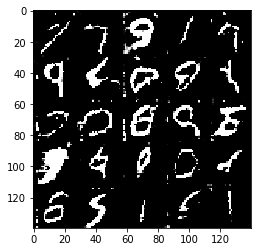

Epoch 2/2... Discriminator Loss: 2.3255... Generator Loss: 0.2383


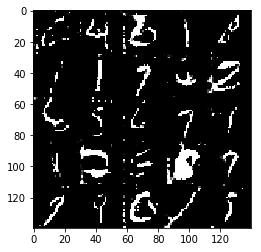

Epoch 2/2... Discriminator Loss: 1.0388... Generator Loss: 1.0614


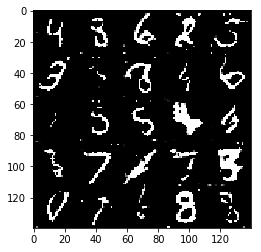

Epoch 2/2... Discriminator Loss: 1.4813... Generator Loss: 0.6151


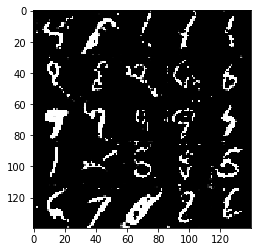

Epoch 2/2... Discriminator Loss: 0.7182... Generator Loss: 1.9203


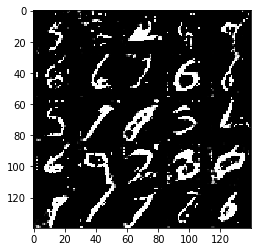

Epoch 2/2... Discriminator Loss: 1.1163... Generator Loss: 0.8668


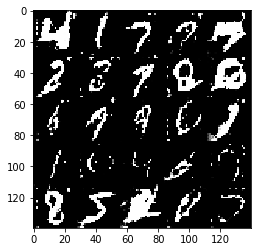

Epoch 2/2... Discriminator Loss: 0.8666... Generator Loss: 1.4389


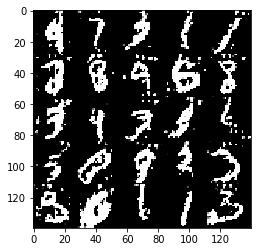

Epoch 2/2... Discriminator Loss: 0.5189... Generator Loss: 2.5324


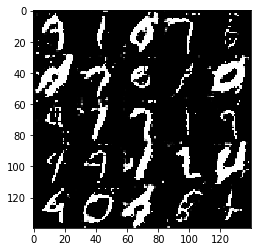

Epoch 2/2... Discriminator Loss: 1.5781... Generator Loss: 0.6679


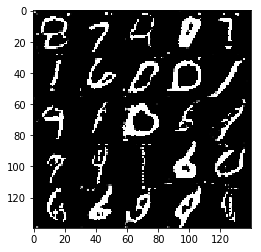

Epoch 2/2... Discriminator Loss: 1.1545... Generator Loss: 2.7751


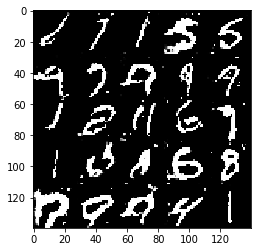

Epoch 2/2... Discriminator Loss: 0.9529... Generator Loss: 1.1210


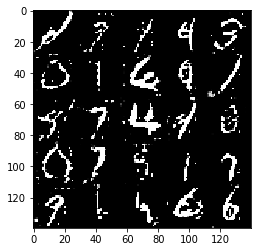

Epoch 2/2... Discriminator Loss: 0.7200... Generator Loss: 1.5462


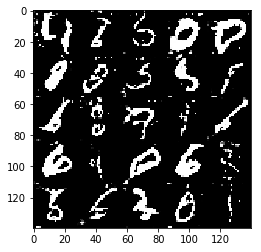

Epoch 2/2... Discriminator Loss: 0.8421... Generator Loss: 1.5183


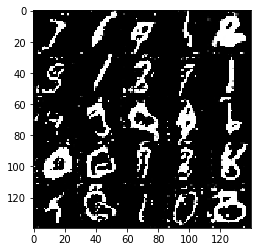

Epoch 2/2... Discriminator Loss: 1.4447... Generator Loss: 0.7708


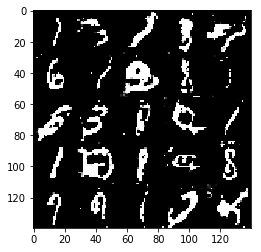

Epoch 2/2... Discriminator Loss: 0.8379... Generator Loss: 1.2729


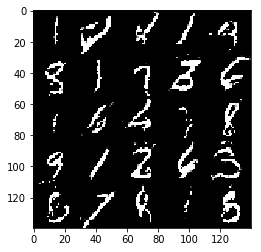

Epoch 2/2... Discriminator Loss: 0.7481... Generator Loss: 1.9094


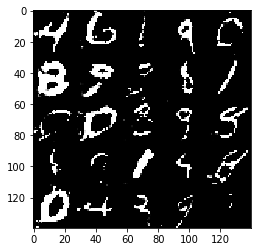

Epoch 2/2... Discriminator Loss: 1.0244... Generator Loss: 1.4291


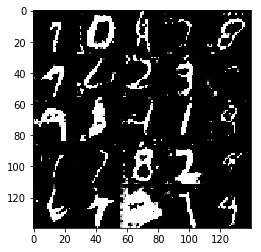

Epoch 2/2... Discriminator Loss: 1.6972... Generator Loss: 0.5885


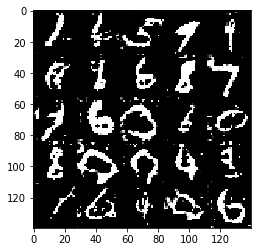

Epoch 2/2... Discriminator Loss: 3.0959... Generator Loss: 0.1539


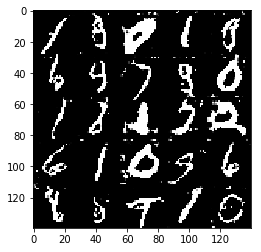

Epoch 2/2... Discriminator Loss: 2.5431... Generator Loss: 4.8422


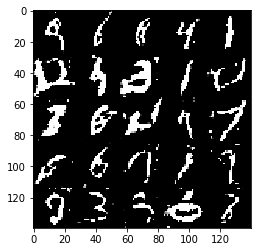

Epoch 2/2... Discriminator Loss: 0.9853... Generator Loss: 2.4585


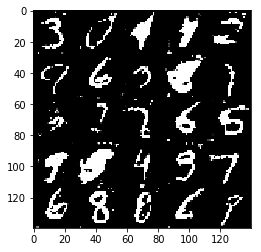

Epoch 2/2... Discriminator Loss: 0.7055... Generator Loss: 1.5730


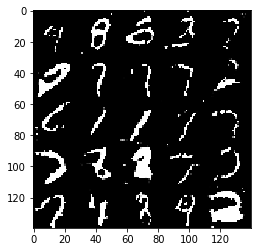

Epoch 2/2... Discriminator Loss: 0.8752... Generator Loss: 1.9007


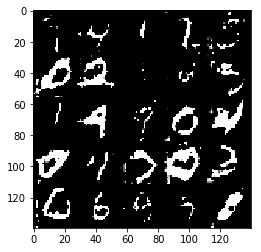

Epoch 2/2... Discriminator Loss: 0.9167... Generator Loss: 1.2206


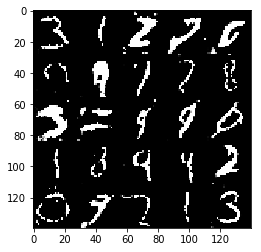

Epoch 2/2... Discriminator Loss: 0.9112... Generator Loss: 1.2477


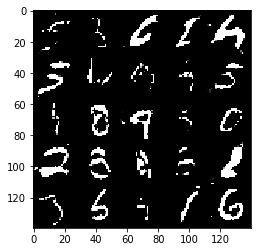

Epoch 2/2... Discriminator Loss: 1.3533... Generator Loss: 0.7418


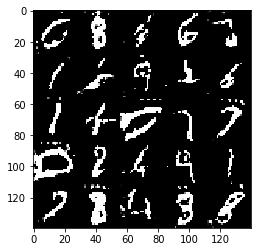

Epoch 2/2... Discriminator Loss: 0.7250... Generator Loss: 1.5776


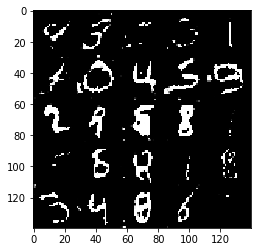

Epoch 2/2... Discriminator Loss: 0.8002... Generator Loss: 3.4462


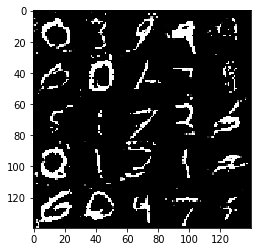

Epoch 2/2... Discriminator Loss: 1.7920... Generator Loss: 0.5479


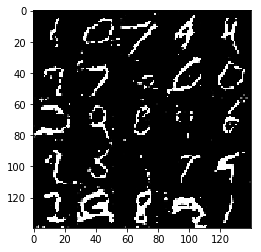

Epoch 2/2... Discriminator Loss: 1.7037... Generator Loss: 0.4592


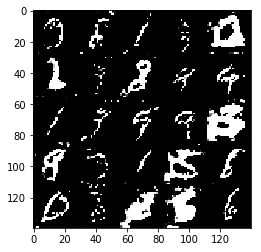

Epoch 2/2... Discriminator Loss: 1.3108... Generator Loss: 1.0704


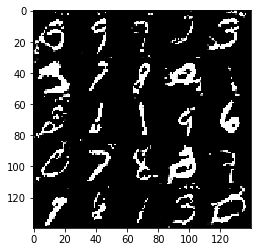

Epoch 2/2... Discriminator Loss: 1.0224... Generator Loss: 1.1180


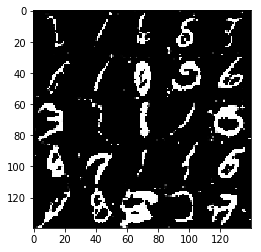

Epoch 2/2... Discriminator Loss: 0.6873... Generator Loss: 2.0704


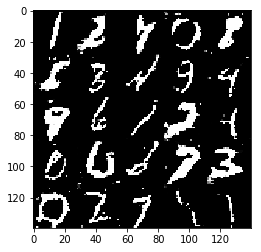

Epoch 2/2... Discriminator Loss: 1.2652... Generator Loss: 1.9002


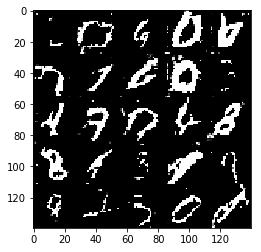

Epoch 2/2... Discriminator Loss: 1.0057... Generator Loss: 1.0204


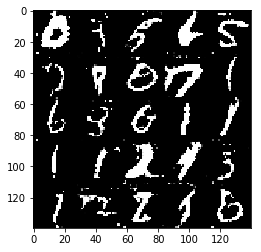

Epoch 2/2... Discriminator Loss: 1.4294... Generator Loss: 0.6457


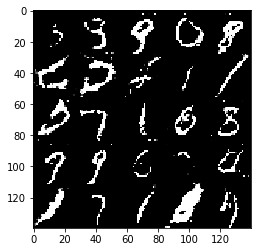

Epoch 2/2... Discriminator Loss: 0.6655... Generator Loss: 2.6429


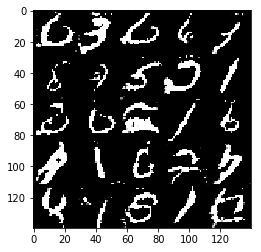

Epoch 2/2... Discriminator Loss: 0.9645... Generator Loss: 1.0879


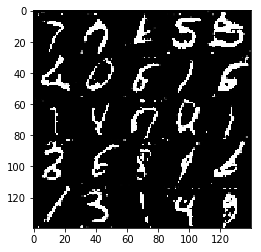

Epoch 2/2... Discriminator Loss: 0.7680... Generator Loss: 3.0487


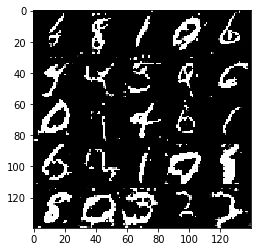

Epoch 2/2... Discriminator Loss: 1.5097... Generator Loss: 0.6106


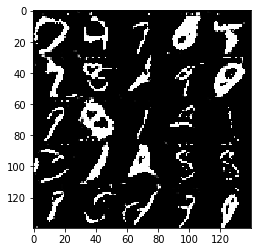

Epoch 2/2... Discriminator Loss: 1.1032... Generator Loss: 1.1521


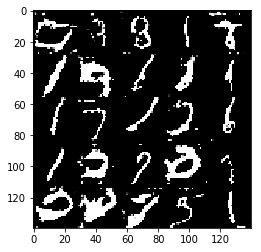

Epoch 2/2... Discriminator Loss: 0.7121... Generator Loss: 1.8069


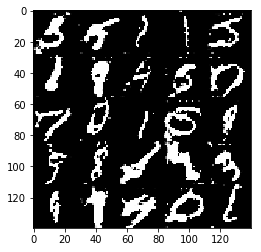

Epoch 2/2... Discriminator Loss: 0.9280... Generator Loss: 1.0576


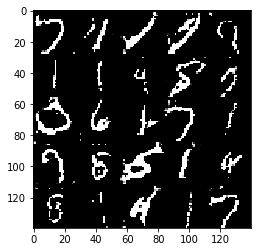

Epoch 2/2... Discriminator Loss: 0.7861... Generator Loss: 2.4726


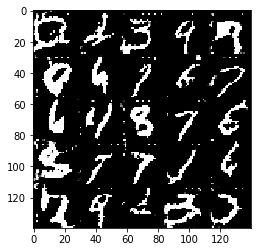

Epoch 2/2... Discriminator Loss: 1.4342... Generator Loss: 0.5931


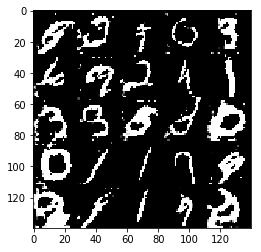

Epoch 2/2... Discriminator Loss: 0.8203... Generator Loss: 1.9958


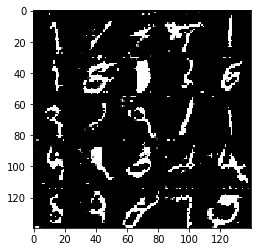

Epoch 2/2... Discriminator Loss: 1.1706... Generator Loss: 4.3603


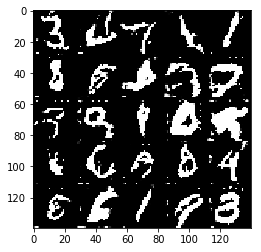

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 4.2353... Generator Loss: 1.0928


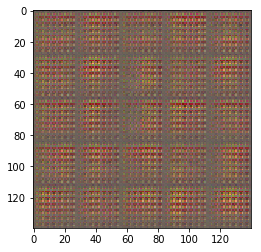

Epoch 1/1... Discriminator Loss: 2.6069... Generator Loss: 1.1657


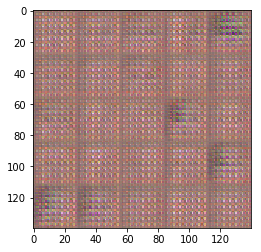

Epoch 1/1... Discriminator Loss: 1.7437... Generator Loss: 0.6422


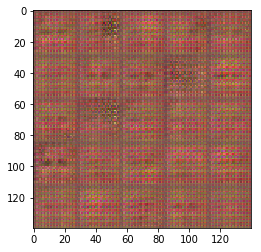

Epoch 1/1... Discriminator Loss: 5.1119... Generator Loss: 0.0544


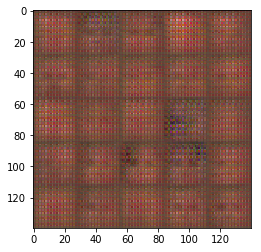

Epoch 1/1... Discriminator Loss: 0.7068... Generator Loss: 3.7102


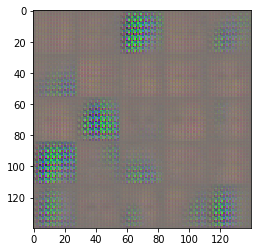

Epoch 1/1... Discriminator Loss: 0.6116... Generator Loss: 3.0479


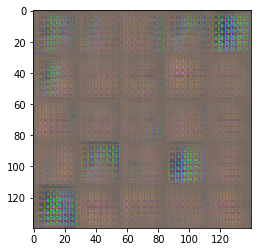

Epoch 1/1... Discriminator Loss: 1.1222... Generator Loss: 3.3141


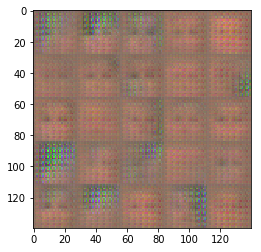

Epoch 1/1... Discriminator Loss: 1.6669... Generator Loss: 4.2464


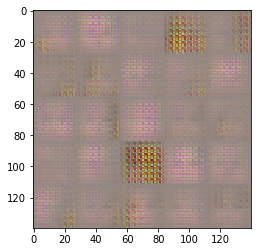

Epoch 1/1... Discriminator Loss: 2.6037... Generator Loss: 2.3480


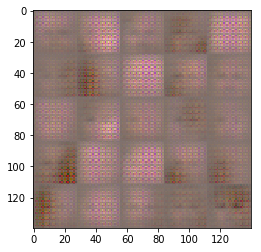

Epoch 1/1... Discriminator Loss: 0.9742... Generator Loss: 1.6773


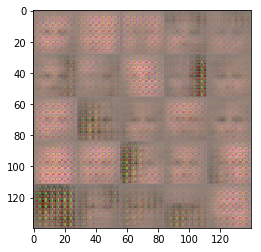

Epoch 1/1... Discriminator Loss: 1.5597... Generator Loss: 1.0923


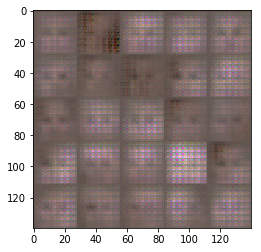

Epoch 1/1... Discriminator Loss: 1.1074... Generator Loss: 1.2099


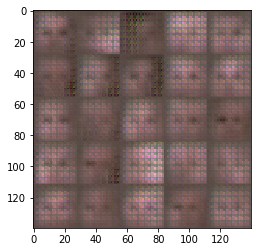

Epoch 1/1... Discriminator Loss: 3.7854... Generator Loss: 3.6852


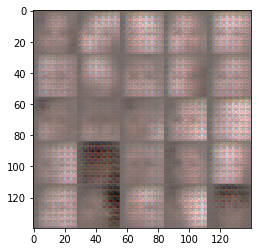

Epoch 1/1... Discriminator Loss: 1.9533... Generator Loss: 3.9980


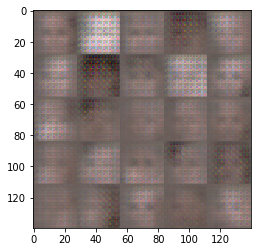

Epoch 1/1... Discriminator Loss: 2.7168... Generator Loss: 1.3193


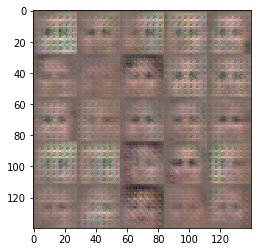

Epoch 1/1... Discriminator Loss: 1.5389... Generator Loss: 2.3909


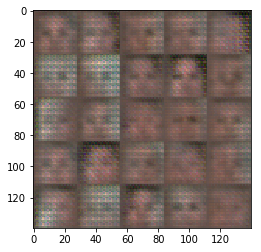

Epoch 1/1... Discriminator Loss: 1.1304... Generator Loss: 1.0366


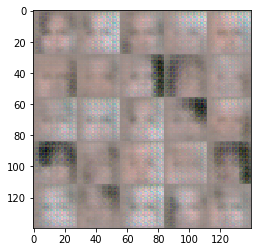

Epoch 1/1... Discriminator Loss: 1.3405... Generator Loss: 1.3640


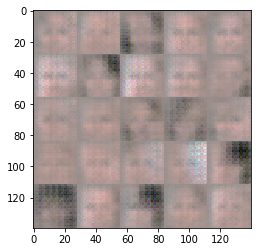

Epoch 1/1... Discriminator Loss: 1.6885... Generator Loss: 2.1868


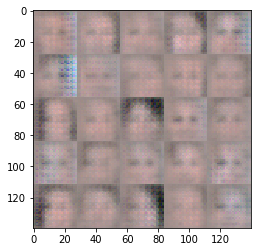

Epoch 1/1... Discriminator Loss: 0.5856... Generator Loss: 2.7022


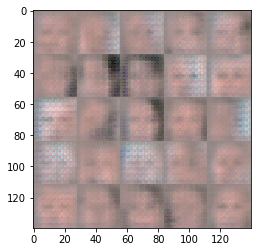

Epoch 1/1... Discriminator Loss: 2.8559... Generator Loss: 0.8870


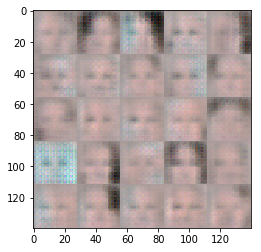

Epoch 1/1... Discriminator Loss: 3.4760... Generator Loss: 3.5823


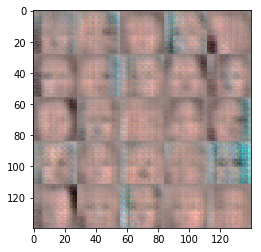

Epoch 1/1... Discriminator Loss: 1.5817... Generator Loss: 1.0852


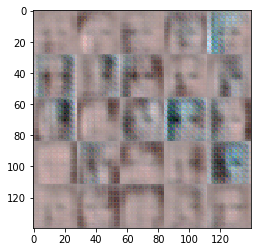

Epoch 1/1... Discriminator Loss: 2.1818... Generator Loss: 0.3624


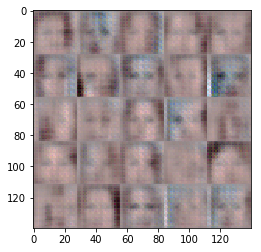

Epoch 1/1... Discriminator Loss: 1.6197... Generator Loss: 2.2053


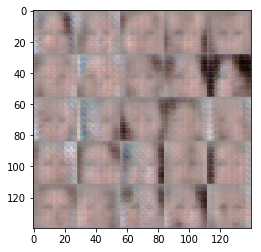

Epoch 1/1... Discriminator Loss: 1.6638... Generator Loss: 3.5565


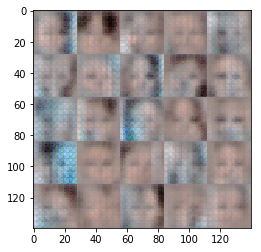

Epoch 1/1... Discriminator Loss: 1.5251... Generator Loss: 1.4684


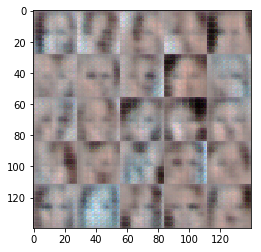

Epoch 1/1... Discriminator Loss: 2.1088... Generator Loss: 0.4169


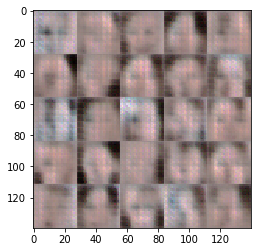

Epoch 1/1... Discriminator Loss: 1.3758... Generator Loss: 1.4182


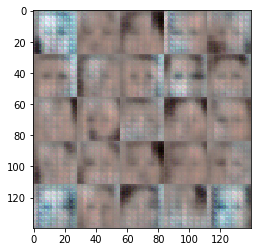

Epoch 1/1... Discriminator Loss: 3.2727... Generator Loss: 0.6113


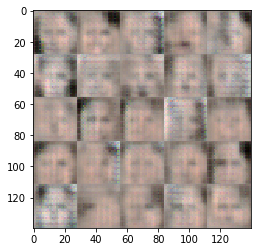

Epoch 1/1... Discriminator Loss: 1.3939... Generator Loss: 0.6237


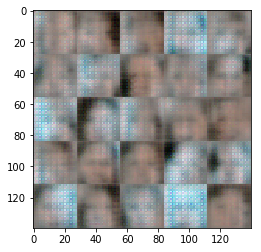

Epoch 1/1... Discriminator Loss: 0.9540... Generator Loss: 2.2856


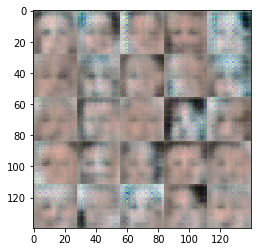

Epoch 1/1... Discriminator Loss: 1.6232... Generator Loss: 1.8568


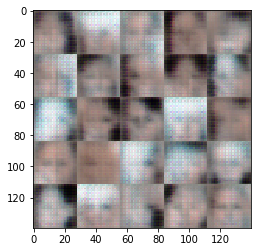

Epoch 1/1... Discriminator Loss: 1.3007... Generator Loss: 1.3427


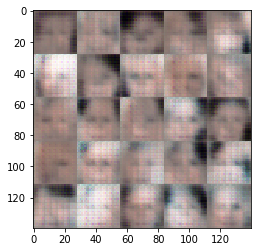

Epoch 1/1... Discriminator Loss: 1.6626... Generator Loss: 1.5692


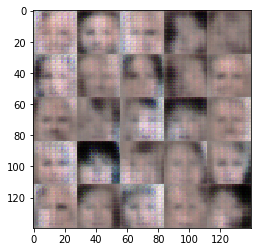

Epoch 1/1... Discriminator Loss: 1.0972... Generator Loss: 1.0118


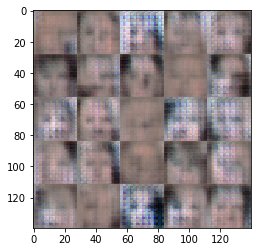

Epoch 1/1... Discriminator Loss: 1.0734... Generator Loss: 1.3082


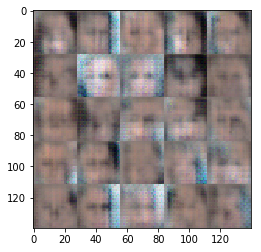

Epoch 1/1... Discriminator Loss: 1.9116... Generator Loss: 4.0501


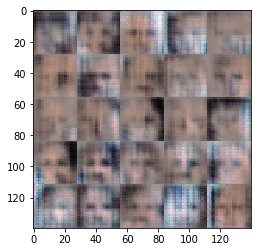

Epoch 1/1... Discriminator Loss: 1.0076... Generator Loss: 1.2357


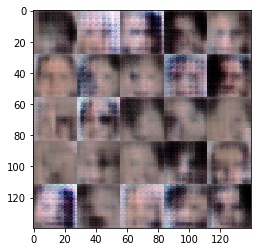

Epoch 1/1... Discriminator Loss: 0.7552... Generator Loss: 1.5155


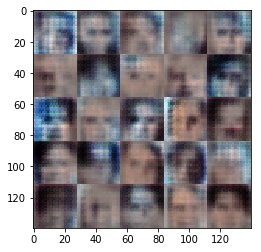

Epoch 1/1... Discriminator Loss: 0.8149... Generator Loss: 1.1583


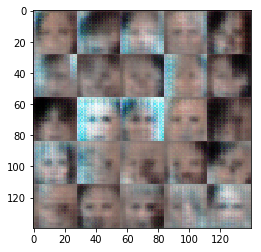

Epoch 1/1... Discriminator Loss: 1.6350... Generator Loss: 0.5442


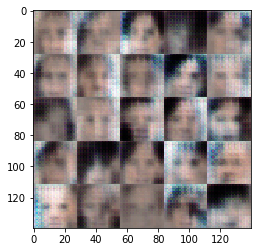

Epoch 1/1... Discriminator Loss: 0.8236... Generator Loss: 1.2124


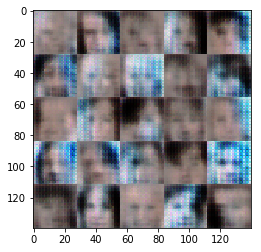

Epoch 1/1... Discriminator Loss: 1.0742... Generator Loss: 1.2872


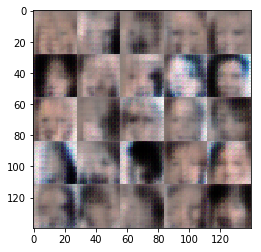

Epoch 1/1... Discriminator Loss: 1.4420... Generator Loss: 0.6921


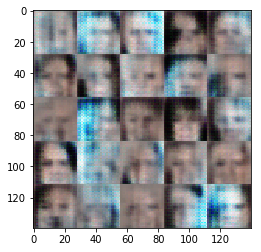

Epoch 1/1... Discriminator Loss: 0.7537... Generator Loss: 1.3864


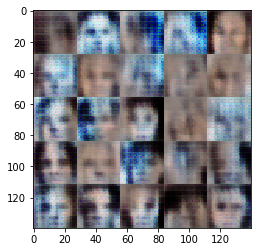

Epoch 1/1... Discriminator Loss: 1.4899... Generator Loss: 0.6319


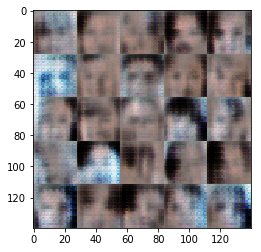

Epoch 1/1... Discriminator Loss: 1.5044... Generator Loss: 0.9458


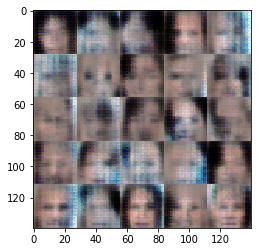

Epoch 1/1... Discriminator Loss: 1.4289... Generator Loss: 0.7131


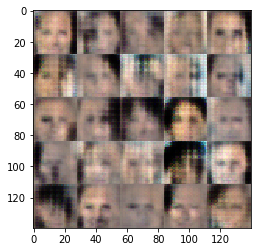

Epoch 1/1... Discriminator Loss: 0.7180... Generator Loss: 2.2895


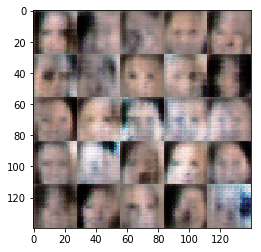

Epoch 1/1... Discriminator Loss: 0.9147... Generator Loss: 1.0166


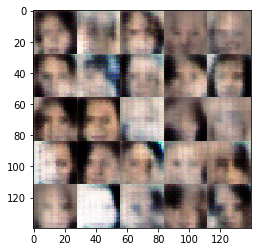

Epoch 1/1... Discriminator Loss: 0.7350... Generator Loss: 1.8548


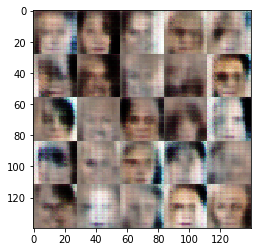

Epoch 1/1... Discriminator Loss: 0.9220... Generator Loss: 1.3568


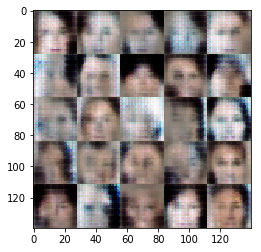

Epoch 1/1... Discriminator Loss: 0.9158... Generator Loss: 1.0566


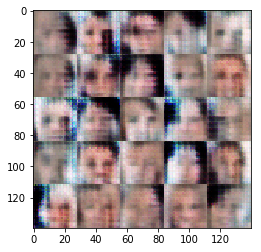

Epoch 1/1... Discriminator Loss: 0.6306... Generator Loss: 1.7138


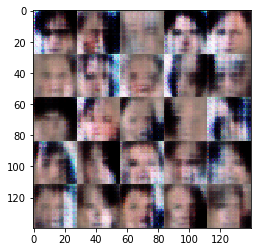

Epoch 1/1... Discriminator Loss: 0.9002... Generator Loss: 1.4653


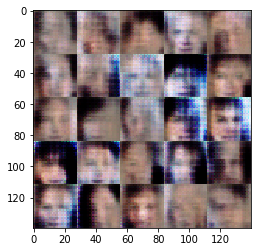

Epoch 1/1... Discriminator Loss: 1.5356... Generator Loss: 2.8338


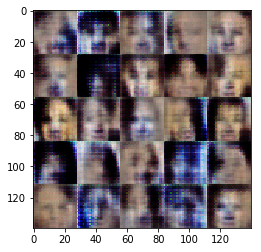

Epoch 1/1... Discriminator Loss: 0.8897... Generator Loss: 0.9922


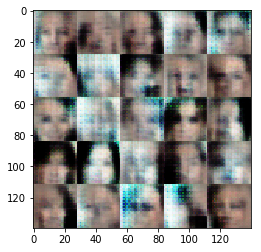

Epoch 1/1... Discriminator Loss: 0.8934... Generator Loss: 1.5296


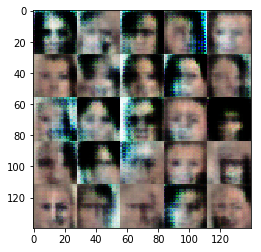

Epoch 1/1... Discriminator Loss: 1.2554... Generator Loss: 0.6943


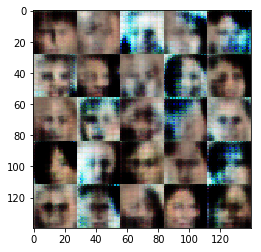

Epoch 1/1... Discriminator Loss: 0.4663... Generator Loss: 3.7849


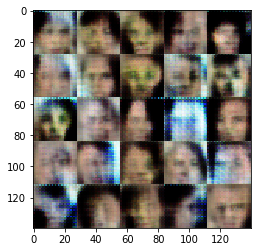

Epoch 1/1... Discriminator Loss: 0.6863... Generator Loss: 2.3199


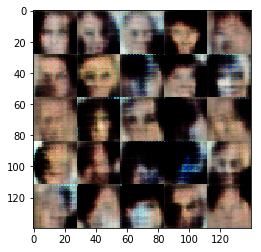

Epoch 1/1... Discriminator Loss: 0.9792... Generator Loss: 1.0609


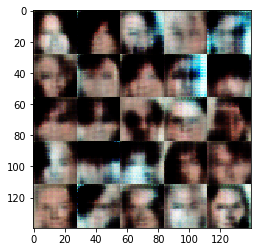

Epoch 1/1... Discriminator Loss: 0.8813... Generator Loss: 2.3580


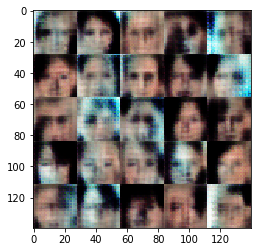

Epoch 1/1... Discriminator Loss: 0.9893... Generator Loss: 1.4705


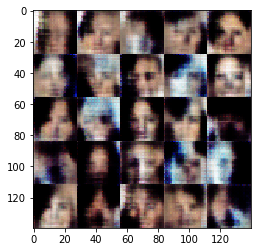

Epoch 1/1... Discriminator Loss: 1.1379... Generator Loss: 0.8043


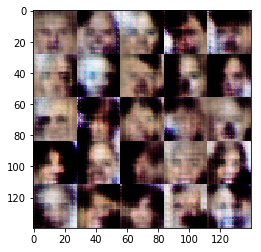

Epoch 1/1... Discriminator Loss: 3.5355... Generator Loss: 4.2446


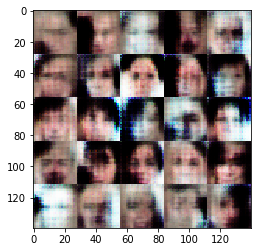

Epoch 1/1... Discriminator Loss: 2.8854... Generator Loss: 0.3680


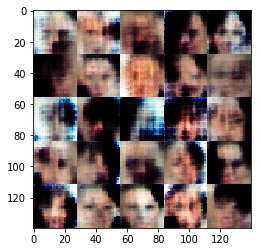

Epoch 1/1... Discriminator Loss: 0.9516... Generator Loss: 1.1291


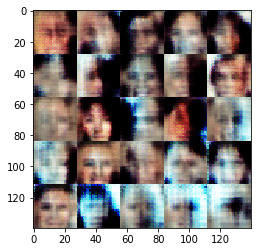

Epoch 1/1... Discriminator Loss: 1.7226... Generator Loss: 0.4666


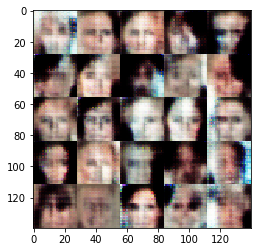

Epoch 1/1... Discriminator Loss: 1.9347... Generator Loss: 0.3041


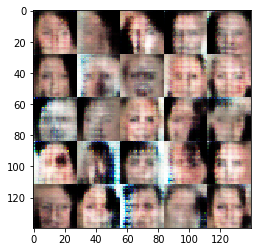

Epoch 1/1... Discriminator Loss: 1.2400... Generator Loss: 1.2577


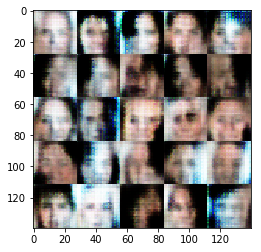

Epoch 1/1... Discriminator Loss: 1.0712... Generator Loss: 0.8283


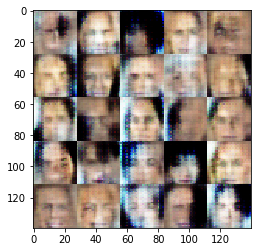

Epoch 1/1... Discriminator Loss: 1.1230... Generator Loss: 1.0471


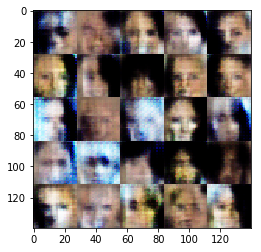

Epoch 1/1... Discriminator Loss: 0.5378... Generator Loss: 2.4445


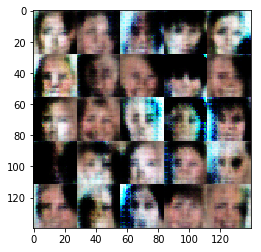

Epoch 1/1... Discriminator Loss: 0.8331... Generator Loss: 1.7669


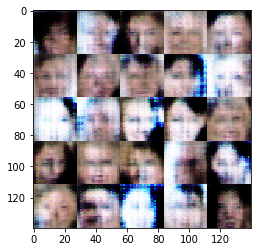

Epoch 1/1... Discriminator Loss: 1.4972... Generator Loss: 2.6231


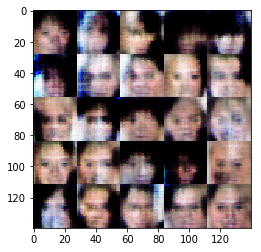

Epoch 1/1... Discriminator Loss: 1.1016... Generator Loss: 2.0403


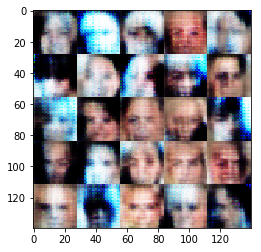

Epoch 1/1... Discriminator Loss: 0.8192... Generator Loss: 1.2541


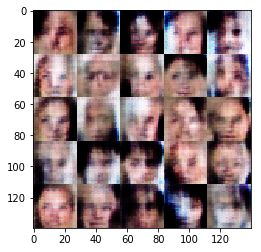

Epoch 1/1... Discriminator Loss: 0.5133... Generator Loss: 2.8299


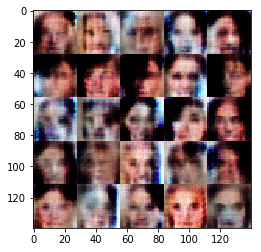

Epoch 1/1... Discriminator Loss: 1.0308... Generator Loss: 1.0659


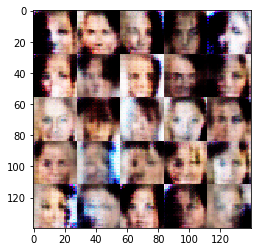

Epoch 1/1... Discriminator Loss: 1.0528... Generator Loss: 1.2989


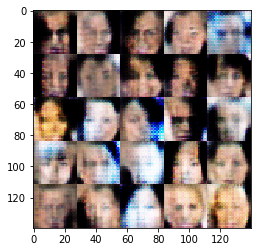

Epoch 1/1... Discriminator Loss: 0.6640... Generator Loss: 2.1443


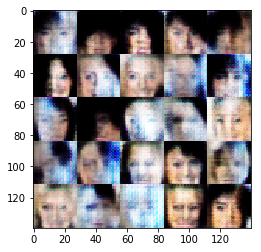

Epoch 1/1... Discriminator Loss: 0.5274... Generator Loss: 2.7574


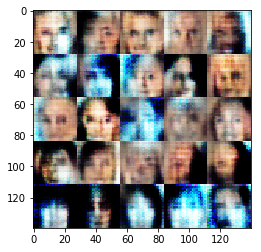

Epoch 1/1... Discriminator Loss: 1.3026... Generator Loss: 0.9578


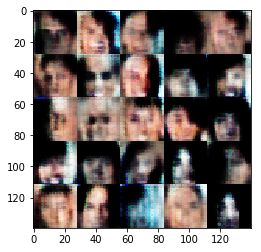

Epoch 1/1... Discriminator Loss: 1.8510... Generator Loss: 0.8639


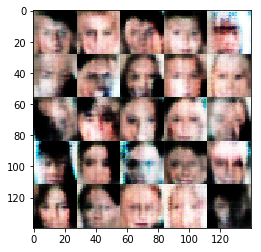

Epoch 1/1... Discriminator Loss: 1.2835... Generator Loss: 1.4976


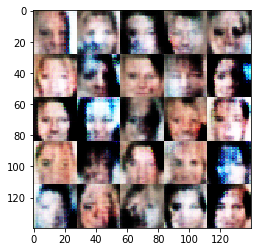

Epoch 1/1... Discriminator Loss: 1.7047... Generator Loss: 0.3677


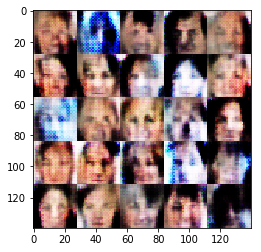

Epoch 1/1... Discriminator Loss: 0.9061... Generator Loss: 0.9529


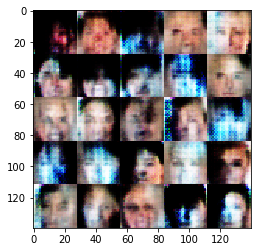

Epoch 1/1... Discriminator Loss: 1.5113... Generator Loss: 0.4524


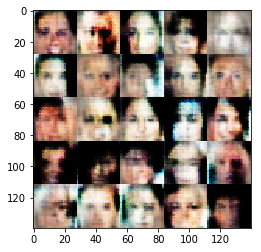

Epoch 1/1... Discriminator Loss: 1.2627... Generator Loss: 0.9547


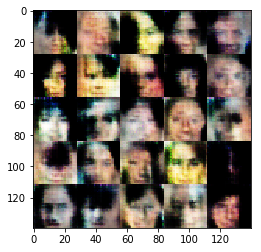

Epoch 1/1... Discriminator Loss: 1.4369... Generator Loss: 2.2821


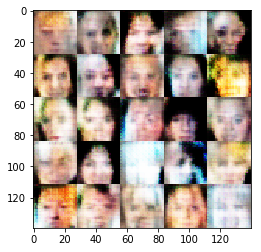

Epoch 1/1... Discriminator Loss: 1.7997... Generator Loss: 0.3407


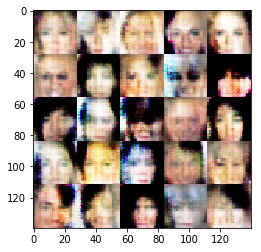

Epoch 1/1... Discriminator Loss: 1.3536... Generator Loss: 1.4279


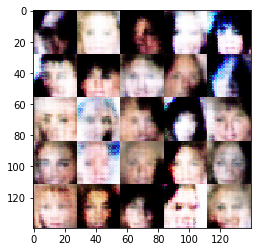

Epoch 1/1... Discriminator Loss: 1.4165... Generator Loss: 0.8578


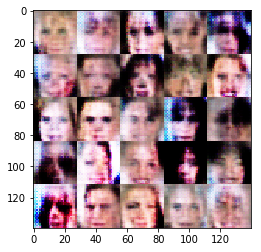

Epoch 1/1... Discriminator Loss: 1.0673... Generator Loss: 1.5253


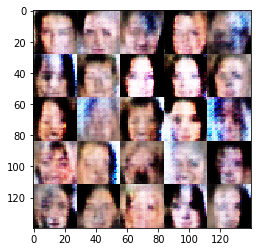

Epoch 1/1... Discriminator Loss: 1.5383... Generator Loss: 0.4109


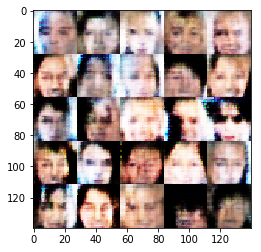

Epoch 1/1... Discriminator Loss: 1.5293... Generator Loss: 0.6985


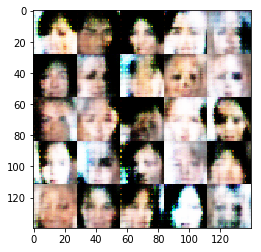

Epoch 1/1... Discriminator Loss: 1.3354... Generator Loss: 0.9461


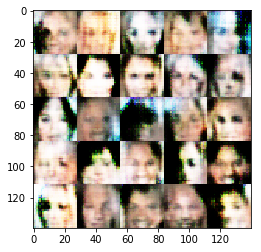

Epoch 1/1... Discriminator Loss: 1.2411... Generator Loss: 0.6839


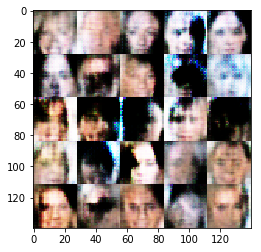

Epoch 1/1... Discriminator Loss: 0.9181... Generator Loss: 0.9131


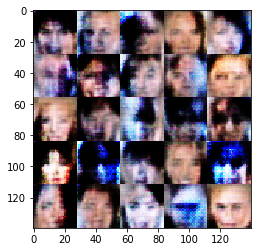

Epoch 1/1... Discriminator Loss: 0.7862... Generator Loss: 1.6658


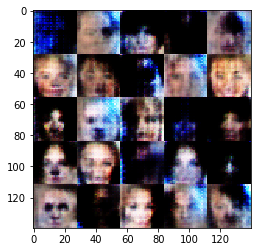

Epoch 1/1... Discriminator Loss: 0.8102... Generator Loss: 1.3663


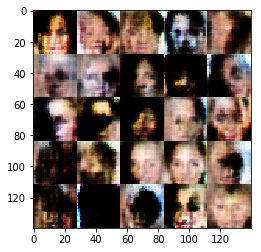

Epoch 1/1... Discriminator Loss: 1.4941... Generator Loss: 0.6739


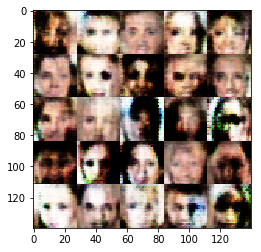

Epoch 1/1... Discriminator Loss: 1.3930... Generator Loss: 0.6864


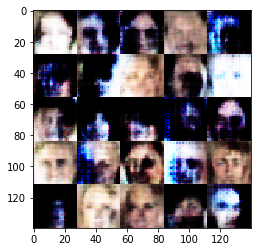

Epoch 1/1... Discriminator Loss: 1.0738... Generator Loss: 0.7876


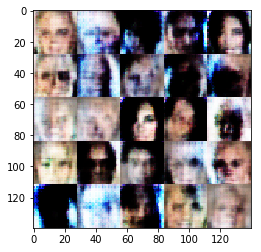

Epoch 1/1... Discriminator Loss: 1.3233... Generator Loss: 1.2422


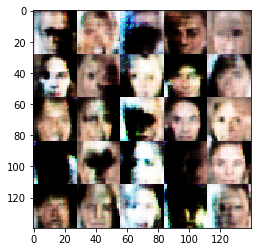

Epoch 1/1... Discriminator Loss: 1.2112... Generator Loss: 0.7818


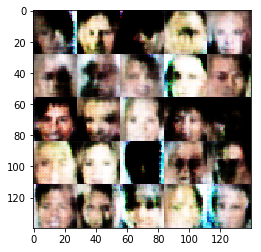

Epoch 1/1... Discriminator Loss: 1.1010... Generator Loss: 0.9663


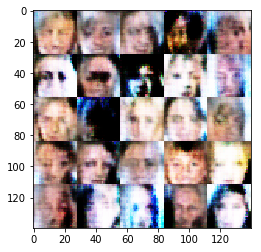

Epoch 1/1... Discriminator Loss: 1.0965... Generator Loss: 1.2194


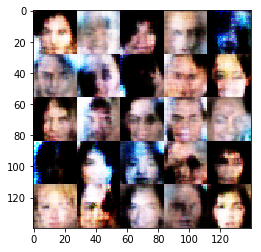

Epoch 1/1... Discriminator Loss: 1.1813... Generator Loss: 1.5104


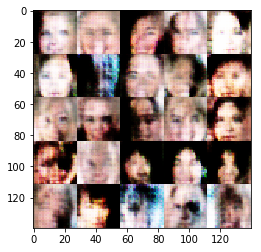

Epoch 1/1... Discriminator Loss: 1.2349... Generator Loss: 0.9825


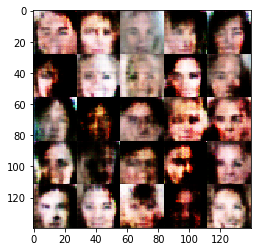

Epoch 1/1... Discriminator Loss: 1.0298... Generator Loss: 1.0013


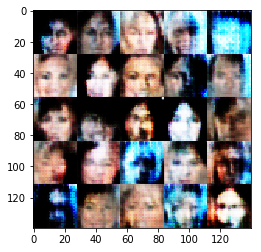

Epoch 1/1... Discriminator Loss: 1.3024... Generator Loss: 1.4968


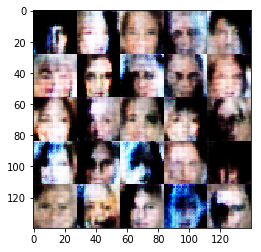

Epoch 1/1... Discriminator Loss: 1.7145... Generator Loss: 1.8119


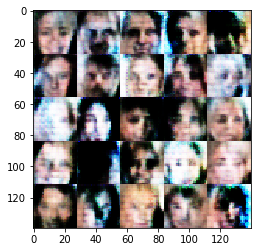

Epoch 1/1... Discriminator Loss: 1.2180... Generator Loss: 0.9178


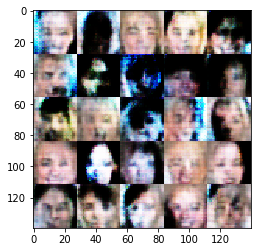

Epoch 1/1... Discriminator Loss: 1.3284... Generator Loss: 0.8601


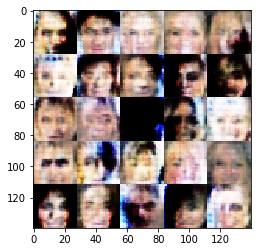

Epoch 1/1... Discriminator Loss: 1.3859... Generator Loss: 1.1917


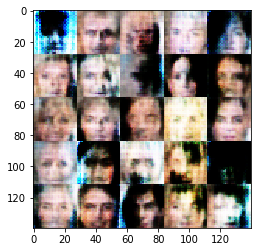

Epoch 1/1... Discriminator Loss: 1.4494... Generator Loss: 0.8991


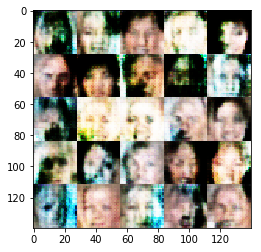

Epoch 1/1... Discriminator Loss: 1.0237... Generator Loss: 1.2074


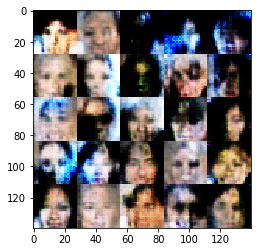

Epoch 1/1... Discriminator Loss: 1.3844... Generator Loss: 0.7336


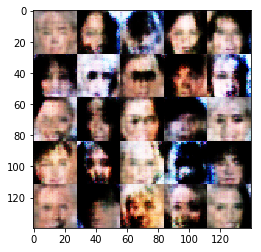

Epoch 1/1... Discriminator Loss: 1.4354... Generator Loss: 0.5180


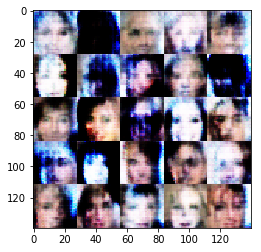

Epoch 1/1... Discriminator Loss: 1.5170... Generator Loss: 0.9053


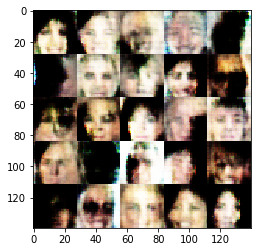

Epoch 1/1... Discriminator Loss: 1.1468... Generator Loss: 0.9250


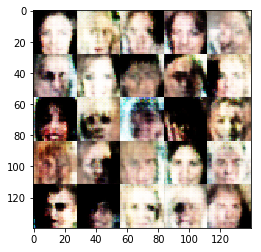

Epoch 1/1... Discriminator Loss: 1.5287... Generator Loss: 1.1127


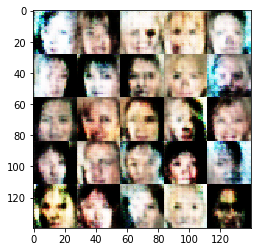

Epoch 1/1... Discriminator Loss: 1.2736... Generator Loss: 0.7446


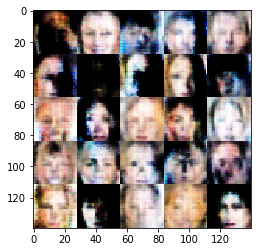

Epoch 1/1... Discriminator Loss: 1.1278... Generator Loss: 1.0769


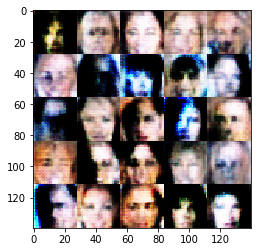

Epoch 1/1... Discriminator Loss: 0.8306... Generator Loss: 1.4498


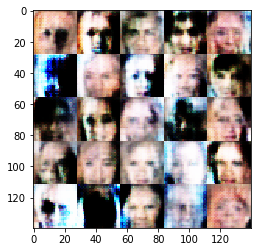

Epoch 1/1... Discriminator Loss: 1.6773... Generator Loss: 0.6587


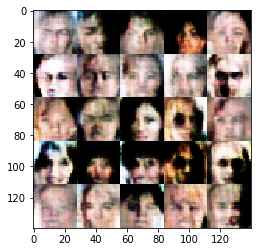

Epoch 1/1... Discriminator Loss: 1.1337... Generator Loss: 0.7970


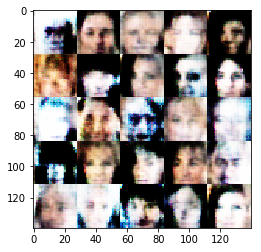

Epoch 1/1... Discriminator Loss: 1.0378... Generator Loss: 0.8630


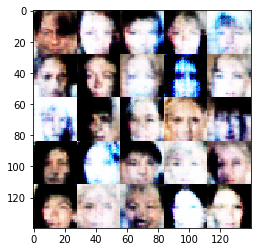

Epoch 1/1... Discriminator Loss: 1.2358... Generator Loss: 1.7397


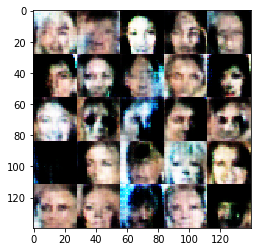

Epoch 1/1... Discriminator Loss: 0.9201... Generator Loss: 1.3223


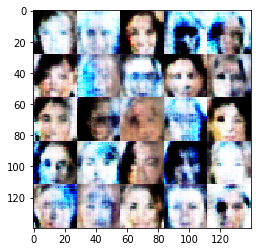

Epoch 1/1... Discriminator Loss: 1.5034... Generator Loss: 0.5160


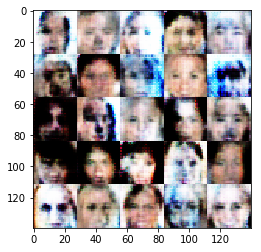

Epoch 1/1... Discriminator Loss: 1.1416... Generator Loss: 1.2796


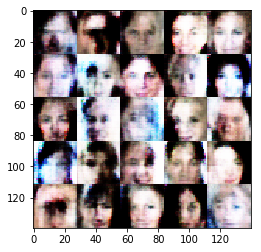

Epoch 1/1... Discriminator Loss: 0.9754... Generator Loss: 1.0876


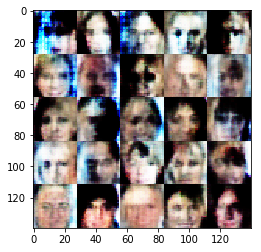

Epoch 1/1... Discriminator Loss: 1.2466... Generator Loss: 0.9543


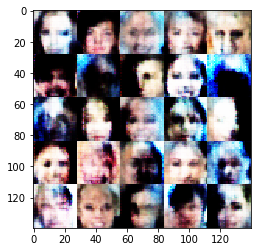

Epoch 1/1... Discriminator Loss: 2.1198... Generator Loss: 0.3785


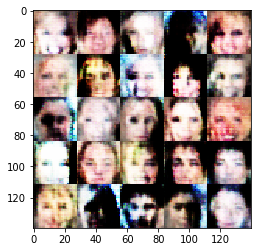

Epoch 1/1... Discriminator Loss: 1.0912... Generator Loss: 0.8912


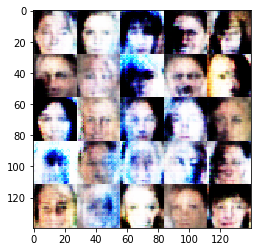

Epoch 1/1... Discriminator Loss: 0.9050... Generator Loss: 1.1988


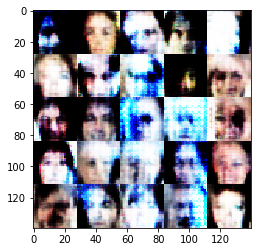

Epoch 1/1... Discriminator Loss: 1.5290... Generator Loss: 1.9901


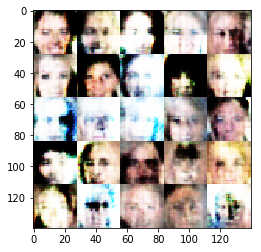

Epoch 1/1... Discriminator Loss: 1.1191... Generator Loss: 0.9217


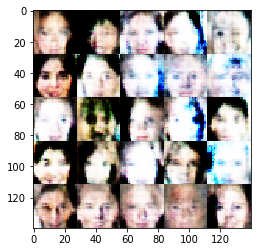

Epoch 1/1... Discriminator Loss: 1.1165... Generator Loss: 1.7482


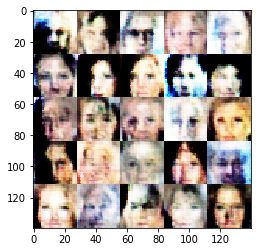

Epoch 1/1... Discriminator Loss: 1.1744... Generator Loss: 1.7322


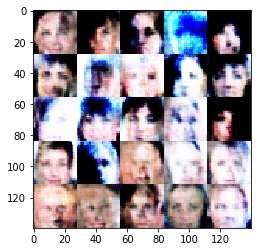

Epoch 1/1... Discriminator Loss: 1.2546... Generator Loss: 1.8707


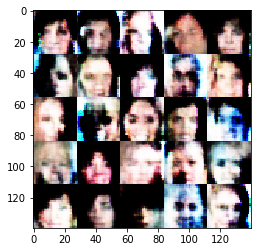

Epoch 1/1... Discriminator Loss: 0.6335... Generator Loss: 1.9056


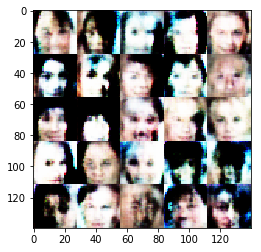

Epoch 1/1... Discriminator Loss: 1.5965... Generator Loss: 0.4985


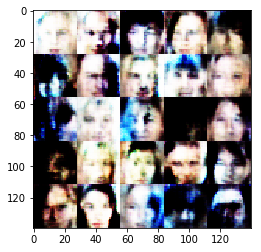

Epoch 1/1... Discriminator Loss: 3.6387... Generator Loss: 3.6677


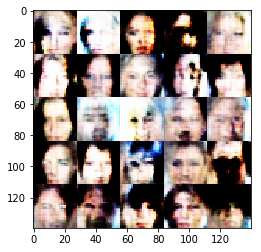

Epoch 1/1... Discriminator Loss: 0.8335... Generator Loss: 1.3069


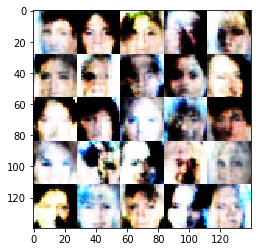

Epoch 1/1... Discriminator Loss: 0.9996... Generator Loss: 1.0695


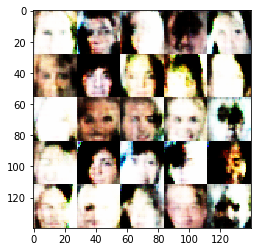

Epoch 1/1... Discriminator Loss: 0.9326... Generator Loss: 1.2368


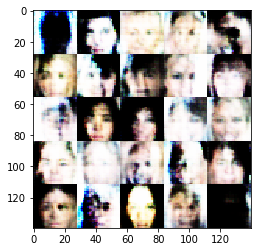

Epoch 1/1... Discriminator Loss: 0.8789... Generator Loss: 1.5029


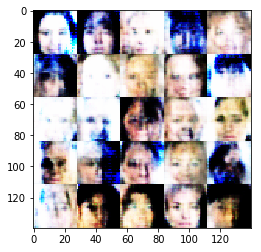

Epoch 1/1... Discriminator Loss: 1.1835... Generator Loss: 0.8640


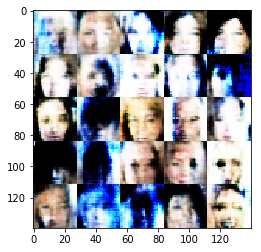

Epoch 1/1... Discriminator Loss: 1.1730... Generator Loss: 2.3267


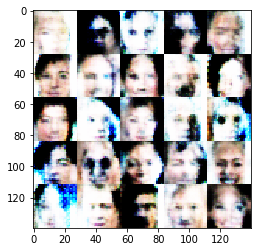

Epoch 1/1... Discriminator Loss: 0.7766... Generator Loss: 1.1573


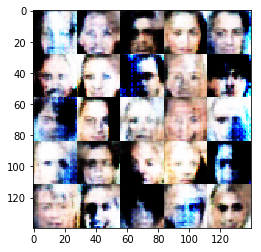

Epoch 1/1... Discriminator Loss: 1.3414... Generator Loss: 1.0330


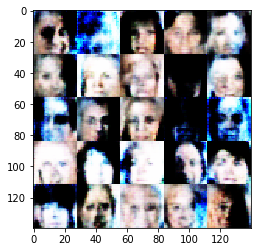

Epoch 1/1... Discriminator Loss: 1.0533... Generator Loss: 1.1207


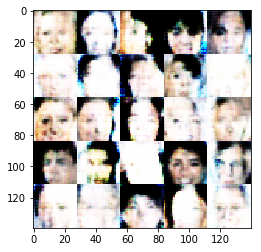

Epoch 1/1... Discriminator Loss: 1.2735... Generator Loss: 0.8605


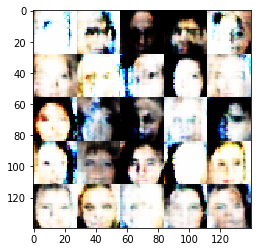

Epoch 1/1... Discriminator Loss: 1.0555... Generator Loss: 0.8308


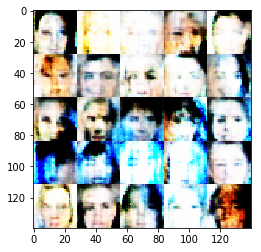

Epoch 1/1... Discriminator Loss: 1.3109... Generator Loss: 0.6494


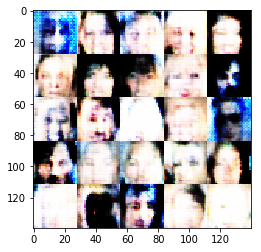

Epoch 1/1... Discriminator Loss: 0.9523... Generator Loss: 0.9571


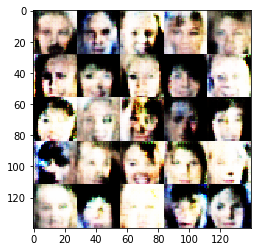

Epoch 1/1... Discriminator Loss: 0.9701... Generator Loss: 0.9923


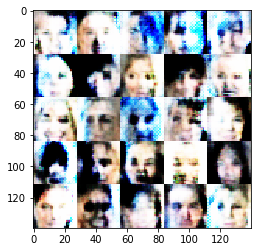

Epoch 1/1... Discriminator Loss: 2.0355... Generator Loss: 2.8879


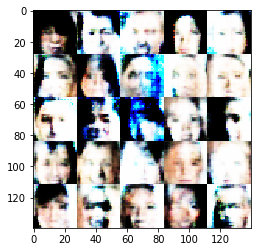

Epoch 1/1... Discriminator Loss: 1.2381... Generator Loss: 1.5367


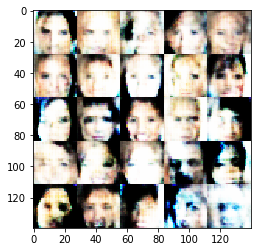

Epoch 1/1... Discriminator Loss: 0.7009... Generator Loss: 1.8364


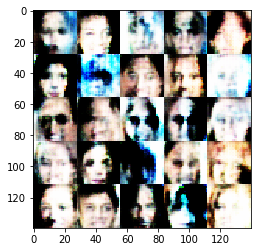

Epoch 1/1... Discriminator Loss: 0.5326... Generator Loss: 1.8483


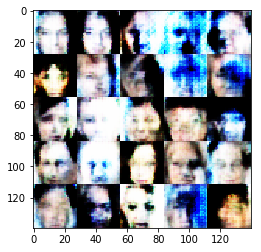

Epoch 1/1... Discriminator Loss: 1.0448... Generator Loss: 1.7713


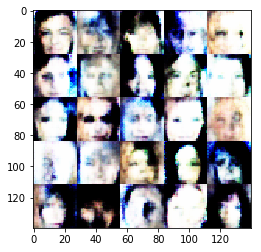

Epoch 1/1... Discriminator Loss: 2.0119... Generator Loss: 0.5559


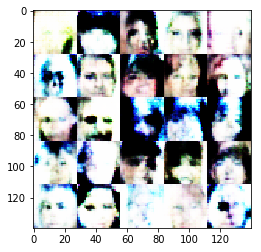

Epoch 1/1... Discriminator Loss: 1.3079... Generator Loss: 0.8752


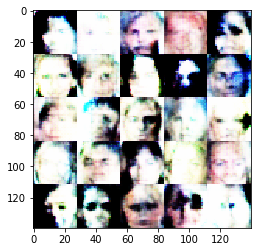

Epoch 1/1... Discriminator Loss: 0.9173... Generator Loss: 1.1050


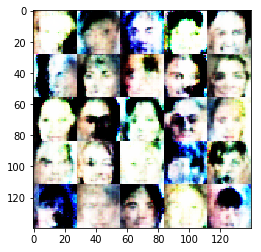

Epoch 1/1... Discriminator Loss: 0.9689... Generator Loss: 1.0907


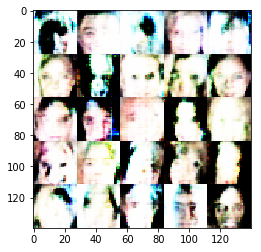

Epoch 1/1... Discriminator Loss: 1.0419... Generator Loss: 1.0807


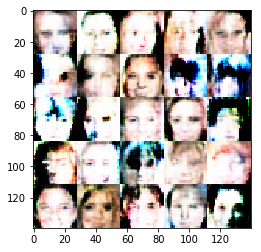

Epoch 1/1... Discriminator Loss: 1.1004... Generator Loss: 0.7087


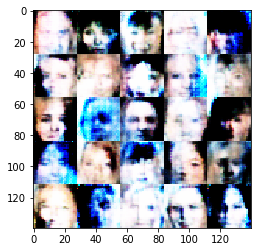

Epoch 1/1... Discriminator Loss: 2.9177... Generator Loss: 3.0526


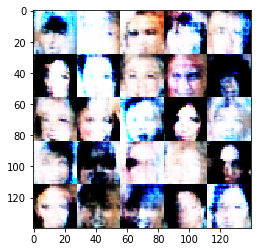

Epoch 1/1... Discriminator Loss: 0.6901... Generator Loss: 1.4390


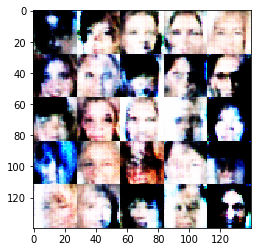

Epoch 1/1... Discriminator Loss: 0.9597... Generator Loss: 0.8982


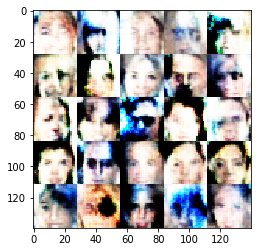

Epoch 1/1... Discriminator Loss: 0.6213... Generator Loss: 2.0821


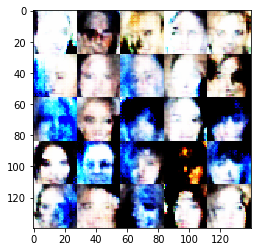

Epoch 1/1... Discriminator Loss: 2.6404... Generator Loss: 3.8222


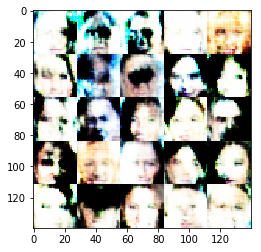

Epoch 1/1... Discriminator Loss: 0.9735... Generator Loss: 1.1878


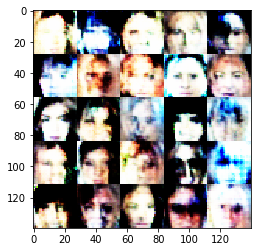

Epoch 1/1... Discriminator Loss: 0.9640... Generator Loss: 1.6771


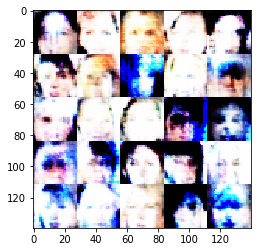

Epoch 1/1... Discriminator Loss: 0.9318... Generator Loss: 1.2816


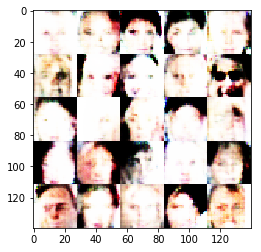

Epoch 1/1... Discriminator Loss: 0.7398... Generator Loss: 1.4419


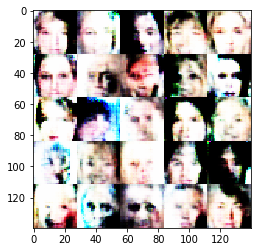

Epoch 1/1... Discriminator Loss: 1.0495... Generator Loss: 0.8992


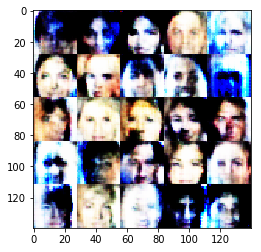

Epoch 1/1... Discriminator Loss: 1.4576... Generator Loss: 0.6364


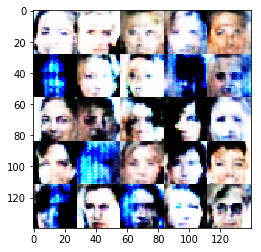

Epoch 1/1... Discriminator Loss: 1.3653... Generator Loss: 0.8161


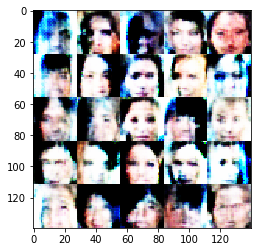

Epoch 1/1... Discriminator Loss: 1.1109... Generator Loss: 0.7240


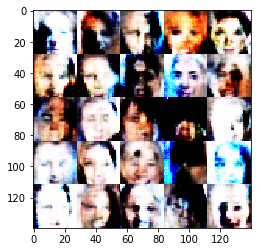

Epoch 1/1... Discriminator Loss: 1.0144... Generator Loss: 1.9440


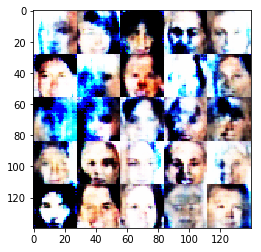

Epoch 1/1... Discriminator Loss: 1.2266... Generator Loss: 1.1591


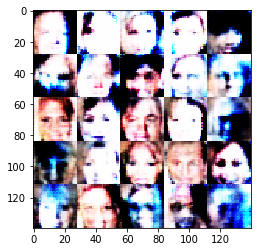

Epoch 1/1... Discriminator Loss: 0.7069... Generator Loss: 1.4868


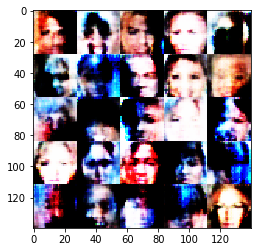

Epoch 1/1... Discriminator Loss: 0.7752... Generator Loss: 1.2082


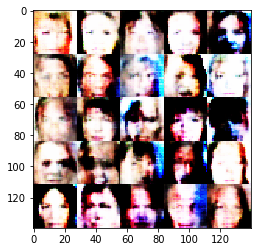

Epoch 1/1... Discriminator Loss: 1.3166... Generator Loss: 1.1325


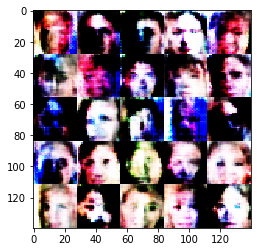

Epoch 1/1... Discriminator Loss: 2.3217... Generator Loss: 2.9947


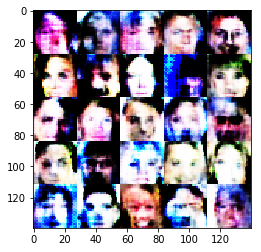

Epoch 1/1... Discriminator Loss: 0.9947... Generator Loss: 1.1801


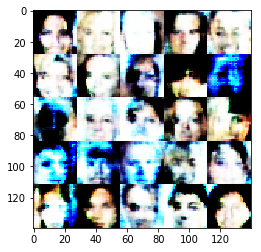

Epoch 1/1... Discriminator Loss: 1.0634... Generator Loss: 0.9172


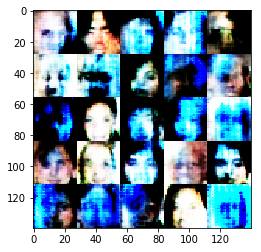

Epoch 1/1... Discriminator Loss: 0.9618... Generator Loss: 1.7627


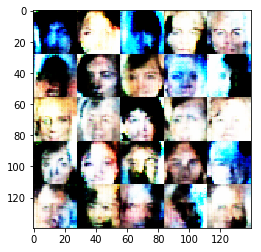

Epoch 1/1... Discriminator Loss: 1.1409... Generator Loss: 1.1509


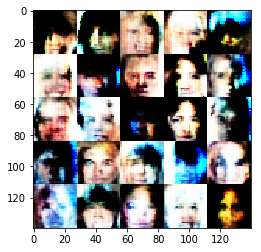

Epoch 1/1... Discriminator Loss: 0.8863... Generator Loss: 1.1835


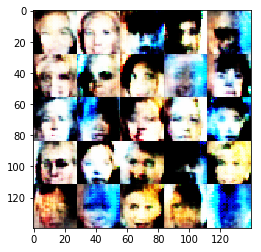

Epoch 1/1... Discriminator Loss: 1.1875... Generator Loss: 0.6895


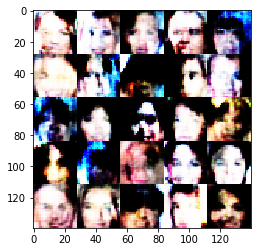

Epoch 1/1... Discriminator Loss: 1.3266... Generator Loss: 0.6302


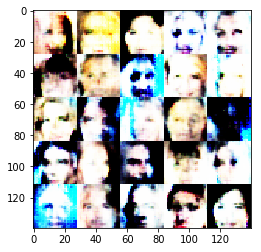

Epoch 1/1... Discriminator Loss: 0.7186... Generator Loss: 1.5366


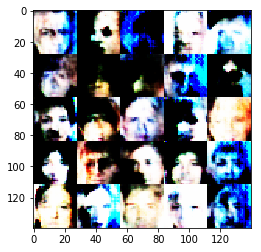

Epoch 1/1... Discriminator Loss: 2.2158... Generator Loss: 0.2975


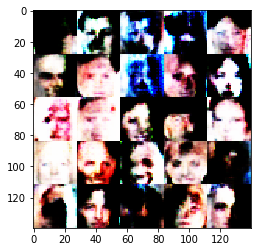

Epoch 1/1... Discriminator Loss: 1.4415... Generator Loss: 0.8617


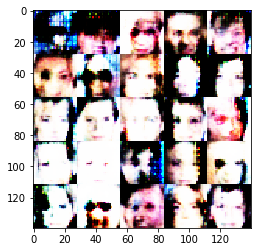

Epoch 1/1... Discriminator Loss: 1.0773... Generator Loss: 1.3055


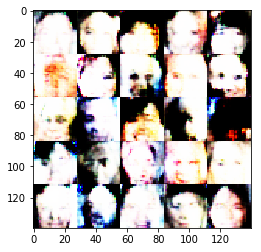

Epoch 1/1... Discriminator Loss: 1.3098... Generator Loss: 0.7414


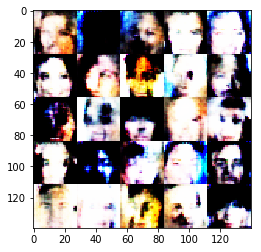

Epoch 1/1... Discriminator Loss: 1.1673... Generator Loss: 1.1861


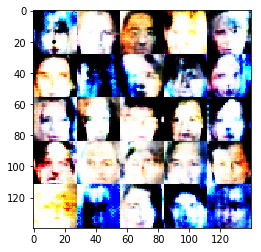

Epoch 1/1... Discriminator Loss: 1.4971... Generator Loss: 0.6283


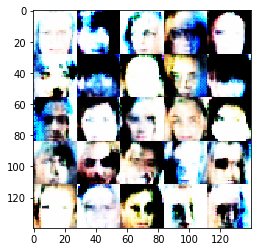

Epoch 1/1... Discriminator Loss: 1.0444... Generator Loss: 1.1865


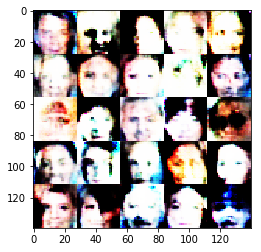

Epoch 1/1... Discriminator Loss: 1.1450... Generator Loss: 0.9246


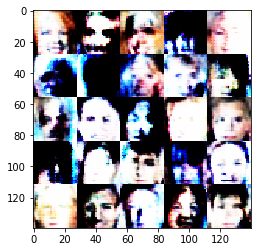

Epoch 1/1... Discriminator Loss: 1.1522... Generator Loss: 1.2206


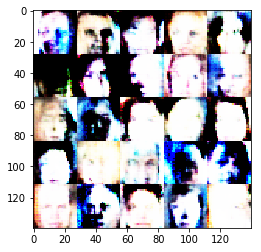

Epoch 1/1... Discriminator Loss: 1.0792... Generator Loss: 1.1240


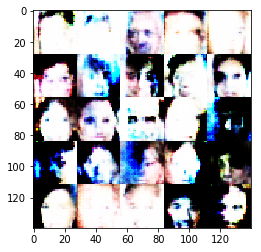

Epoch 1/1... Discriminator Loss: 1.0699... Generator Loss: 0.9702


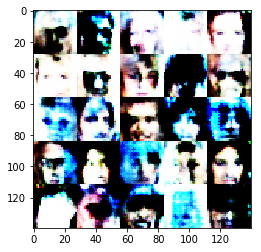

Epoch 1/1... Discriminator Loss: 1.2476... Generator Loss: 0.7101


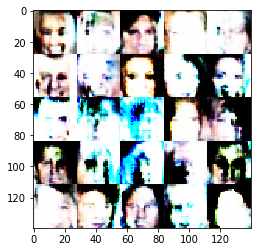

Epoch 1/1... Discriminator Loss: 1.3141... Generator Loss: 1.1144


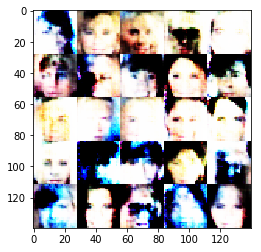

Epoch 1/1... Discriminator Loss: 1.2274... Generator Loss: 1.1615


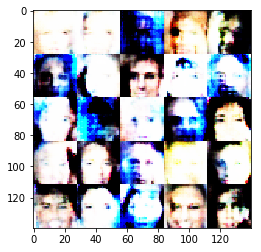

Epoch 1/1... Discriminator Loss: 1.9159... Generator Loss: 0.3995


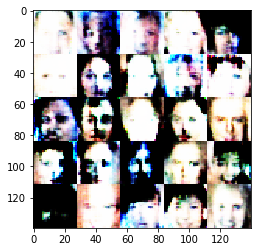

Epoch 1/1... Discriminator Loss: 1.4891... Generator Loss: 1.1899


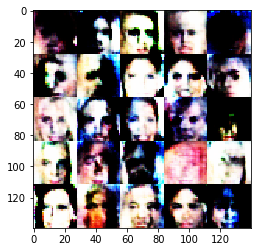

Epoch 1/1... Discriminator Loss: 1.4283... Generator Loss: 0.4891


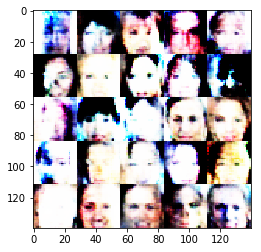

Epoch 1/1... Discriminator Loss: 1.3103... Generator Loss: 0.8176


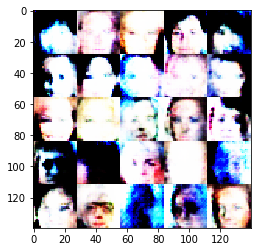

Epoch 1/1... Discriminator Loss: 1.0162... Generator Loss: 1.3630


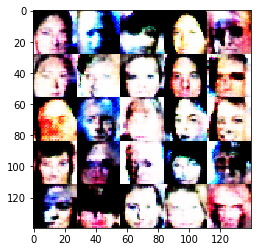

Epoch 1/1... Discriminator Loss: 1.4422... Generator Loss: 0.5931


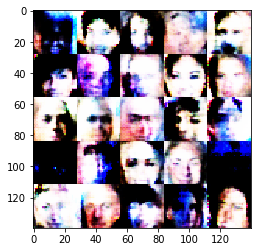

Epoch 1/1... Discriminator Loss: 0.8237... Generator Loss: 1.1317


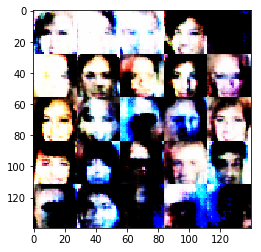

Epoch 1/1... Discriminator Loss: 0.9841... Generator Loss: 1.6018


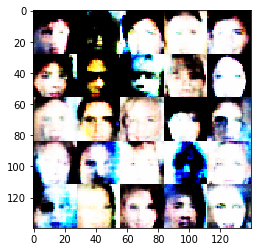

Epoch 1/1... Discriminator Loss: 1.1833... Generator Loss: 0.6987


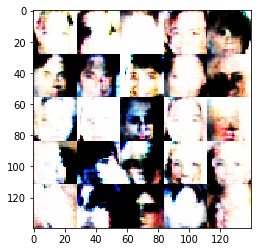

Epoch 1/1... Discriminator Loss: 1.0430... Generator Loss: 1.1505


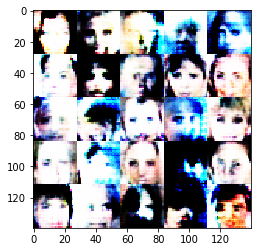

Epoch 1/1... Discriminator Loss: 1.0857... Generator Loss: 0.8695


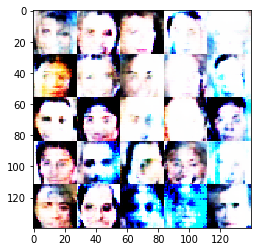

Epoch 1/1... Discriminator Loss: 1.7610... Generator Loss: 0.4182


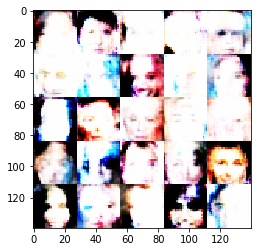

Epoch 1/1... Discriminator Loss: 1.4356... Generator Loss: 0.8100


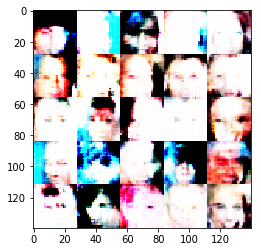

Epoch 1/1... Discriminator Loss: 0.9307... Generator Loss: 1.5805


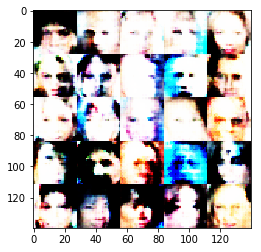

Epoch 1/1... Discriminator Loss: 0.5740... Generator Loss: 1.8651


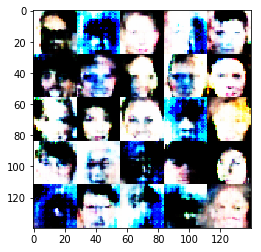

Epoch 1/1... Discriminator Loss: 0.6872... Generator Loss: 1.6294


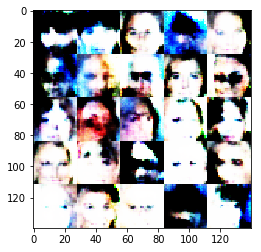

Epoch 1/1... Discriminator Loss: 1.0457... Generator Loss: 0.9048


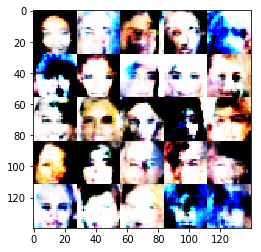

Epoch 1/1... Discriminator Loss: 1.3022... Generator Loss: 0.6026


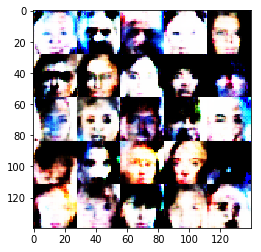

Epoch 1/1... Discriminator Loss: 1.2844... Generator Loss: 2.1333


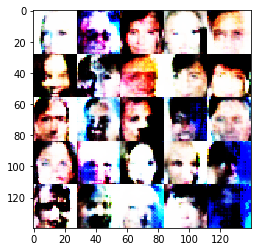

Epoch 1/1... Discriminator Loss: 0.8168... Generator Loss: 1.1749


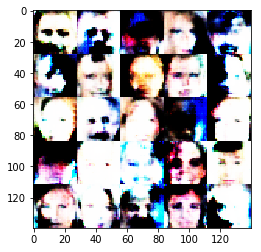

Epoch 1/1... Discriminator Loss: 0.9459... Generator Loss: 1.6352


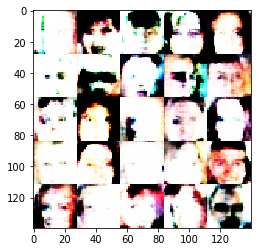

Epoch 1/1... Discriminator Loss: 0.8422... Generator Loss: 2.2319


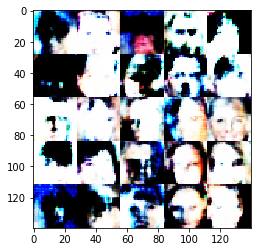

Epoch 1/1... Discriminator Loss: 0.6388... Generator Loss: 1.6492


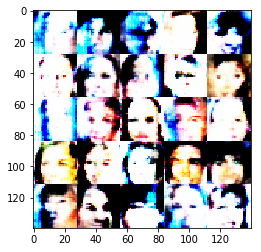

Epoch 1/1... Discriminator Loss: 1.0244... Generator Loss: 1.4031


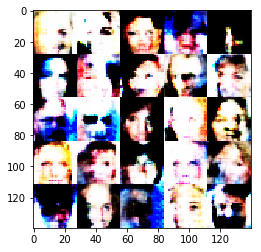

Epoch 1/1... Discriminator Loss: 1.7513... Generator Loss: 0.3927


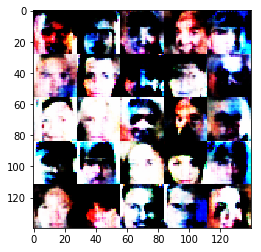

Epoch 1/1... Discriminator Loss: 1.3580... Generator Loss: 0.9218


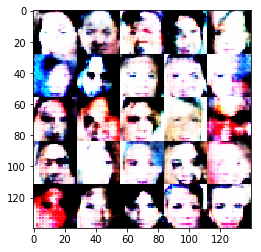

Epoch 1/1... Discriminator Loss: 1.2679... Generator Loss: 1.2530


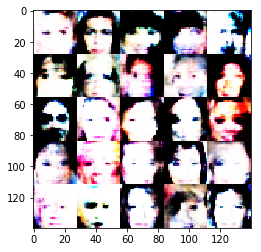

Epoch 1/1... Discriminator Loss: 1.1147... Generator Loss: 0.8057


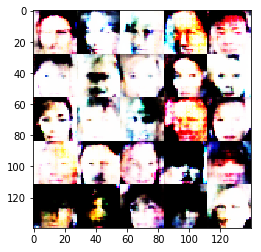

Epoch 1/1... Discriminator Loss: 0.9157... Generator Loss: 1.3747


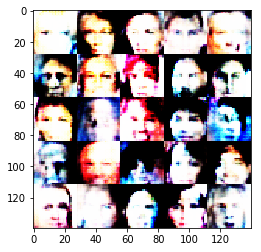

Epoch 1/1... Discriminator Loss: 1.3306... Generator Loss: 0.5991


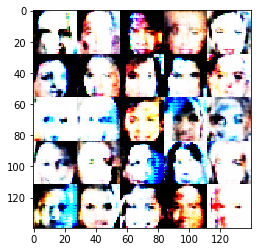

Epoch 1/1... Discriminator Loss: 1.1822... Generator Loss: 0.9448


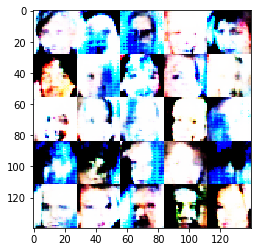

Epoch 1/1... Discriminator Loss: 1.4633... Generator Loss: 2.0202


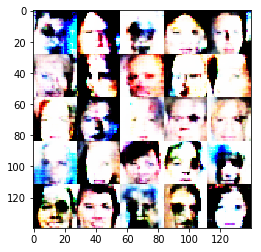

Epoch 1/1... Discriminator Loss: 1.0121... Generator Loss: 0.9197


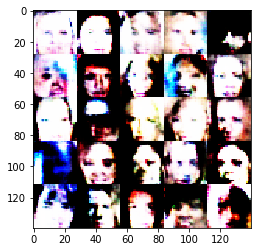

Epoch 1/1... Discriminator Loss: 0.8830... Generator Loss: 1.3214


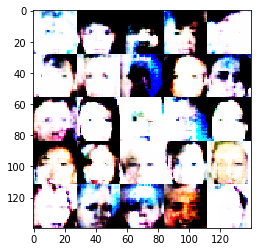

Epoch 1/1... Discriminator Loss: 1.3464... Generator Loss: 1.4363


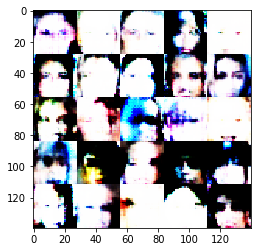

Epoch 1/1... Discriminator Loss: 0.9767... Generator Loss: 1.2184


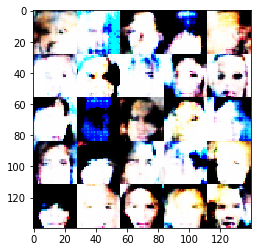

Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 0.8561


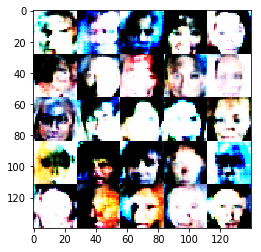

Epoch 1/1... Discriminator Loss: 0.6831... Generator Loss: 1.6513


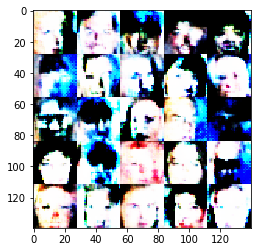

Epoch 1/1... Discriminator Loss: 1.9541... Generator Loss: 1.5339


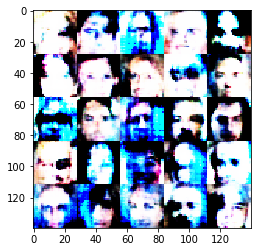

Epoch 1/1... Discriminator Loss: 0.8211... Generator Loss: 1.6635


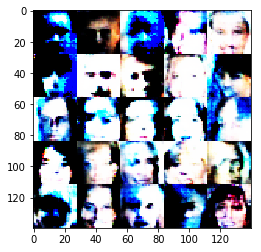

Epoch 1/1... Discriminator Loss: 1.3776... Generator Loss: 0.6053


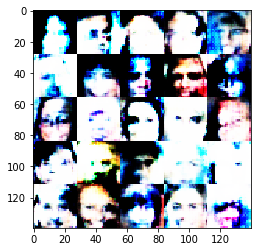

Epoch 1/1... Discriminator Loss: 0.7316... Generator Loss: 1.6459


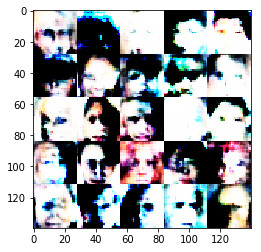

Epoch 1/1... Discriminator Loss: 1.0687... Generator Loss: 3.0206


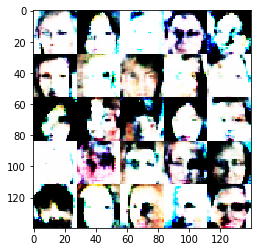

Epoch 1/1... Discriminator Loss: 1.9241... Generator Loss: 2.4172


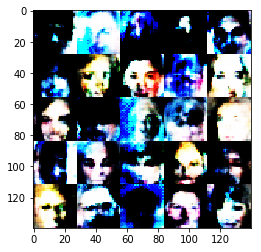

Epoch 1/1... Discriminator Loss: 0.6819... Generator Loss: 1.3891


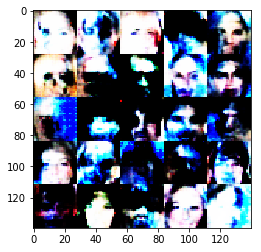

Epoch 1/1... Discriminator Loss: 0.7566... Generator Loss: 1.7525


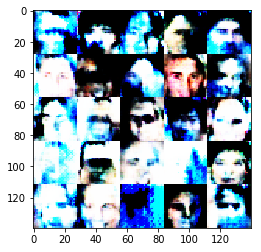

Epoch 1/1... Discriminator Loss: 1.3266... Generator Loss: 1.5563


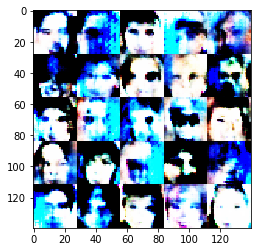

Epoch 1/1... Discriminator Loss: 1.6648... Generator Loss: 0.5890


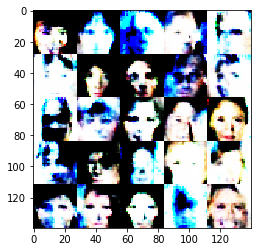

Epoch 1/1... Discriminator Loss: 1.0251... Generator Loss: 1.2444


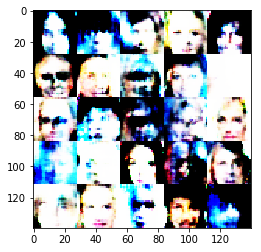

Epoch 1/1... Discriminator Loss: 2.1566... Generator Loss: 0.2334


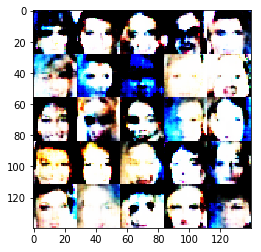

Epoch 1/1... Discriminator Loss: 0.4543... Generator Loss: 2.6233


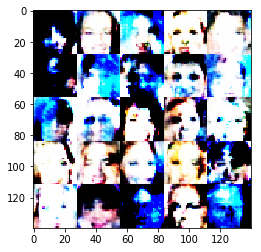

Epoch 1/1... Discriminator Loss: 0.9833... Generator Loss: 1.0411


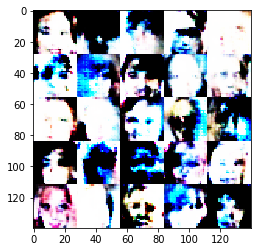

Epoch 1/1... Discriminator Loss: 1.3954... Generator Loss: 0.6156


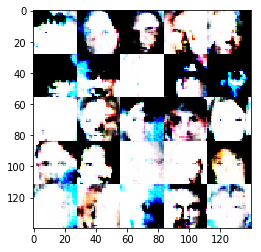

Epoch 1/1... Discriminator Loss: 1.2248... Generator Loss: 0.6566


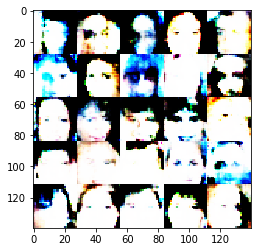

Epoch 1/1... Discriminator Loss: 0.7746... Generator Loss: 1.5303


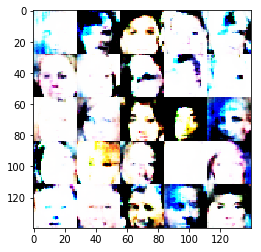

Epoch 1/1... Discriminator Loss: 0.5133... Generator Loss: 2.3948


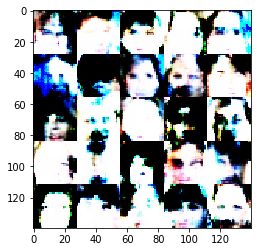

Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 1.6680


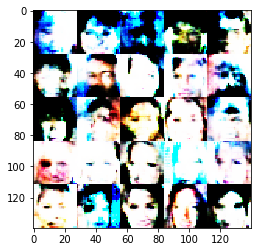

Epoch 1/1... Discriminator Loss: 0.7805... Generator Loss: 2.3436


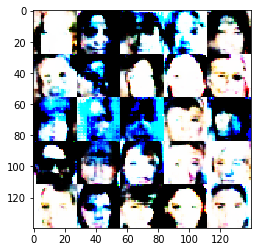

Epoch 1/1... Discriminator Loss: 1.6923... Generator Loss: 0.3688


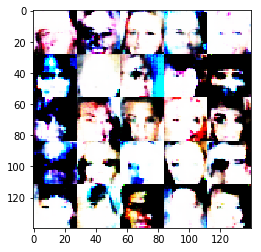

Epoch 1/1... Discriminator Loss: 1.5097... Generator Loss: 2.1276


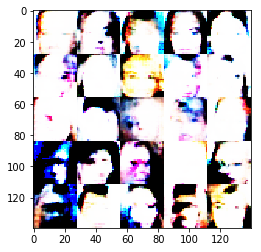

Epoch 1/1... Discriminator Loss: 0.9392... Generator Loss: 1.0236


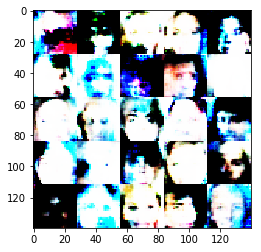

Epoch 1/1... Discriminator Loss: 0.9986... Generator Loss: 1.2020


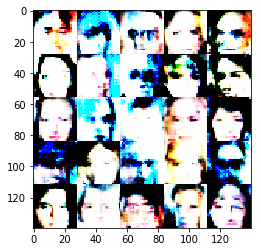

Epoch 1/1... Discriminator Loss: 0.7560... Generator Loss: 1.3559


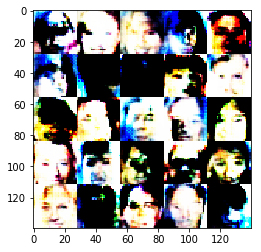

Epoch 1/1... Discriminator Loss: 0.5609... Generator Loss: 2.0938


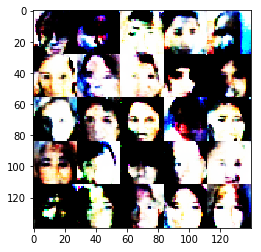

Epoch 1/1... Discriminator Loss: 0.5571... Generator Loss: 2.1269


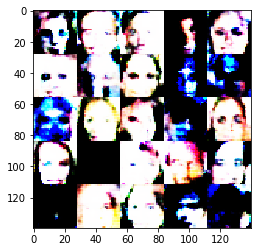

Epoch 1/1... Discriminator Loss: 0.9809... Generator Loss: 1.1574


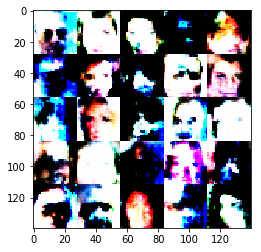

Epoch 1/1... Discriminator Loss: 0.4299... Generator Loss: 3.1751


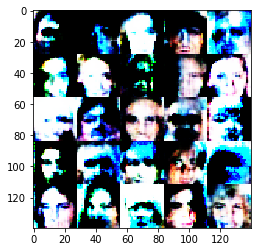

Epoch 1/1... Discriminator Loss: 0.6220... Generator Loss: 1.6875


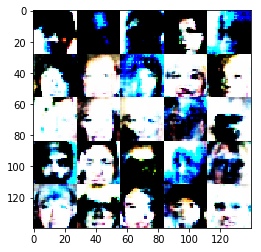

Epoch 1/1... Discriminator Loss: 1.2837... Generator Loss: 0.7812


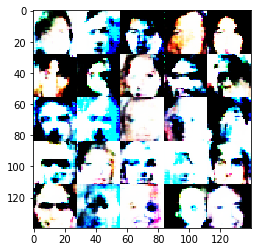

Epoch 1/1... Discriminator Loss: 0.6452... Generator Loss: 1.8195


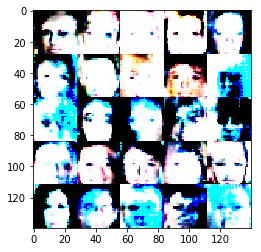

Epoch 1/1... Discriminator Loss: 0.8593... Generator Loss: 2.5838


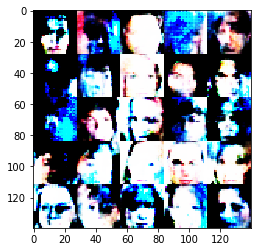

Epoch 1/1... Discriminator Loss: 0.5972... Generator Loss: 2.8050


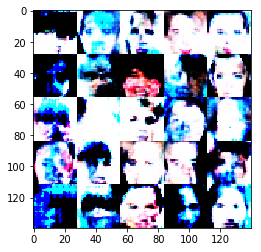

Epoch 1/1... Discriminator Loss: 0.3900... Generator Loss: 4.1631


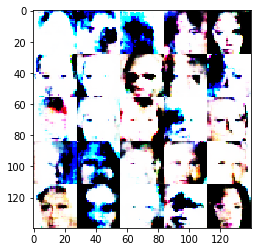

Epoch 1/1... Discriminator Loss: 1.2319... Generator Loss: 0.7671


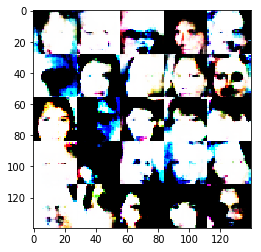

Epoch 1/1... Discriminator Loss: 1.1163... Generator Loss: 1.1732


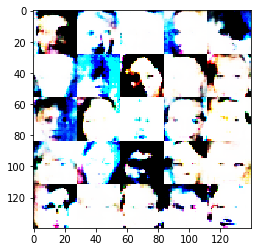

Epoch 1/1... Discriminator Loss: 0.9279... Generator Loss: 1.5569


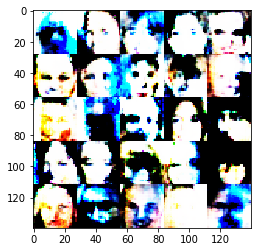

Epoch 1/1... Discriminator Loss: 0.8600... Generator Loss: 2.0763


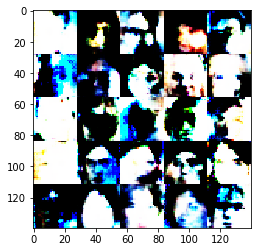

Epoch 1/1... Discriminator Loss: 0.9108... Generator Loss: 1.3036


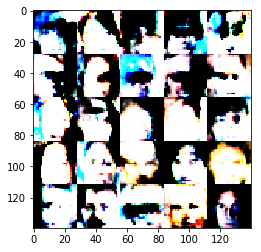

Epoch 1/1... Discriminator Loss: 2.9596... Generator Loss: 3.5293


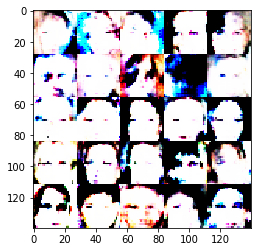

Epoch 1/1... Discriminator Loss: 0.9442... Generator Loss: 0.9513


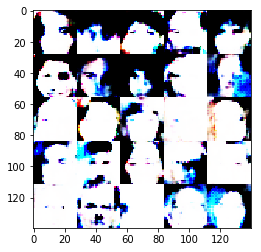

Epoch 1/1... Discriminator Loss: 1.1870... Generator Loss: 0.7116


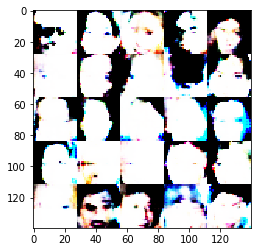

Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 1.2724


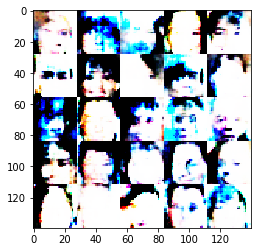

Epoch 1/1... Discriminator Loss: 0.5385... Generator Loss: 2.2086


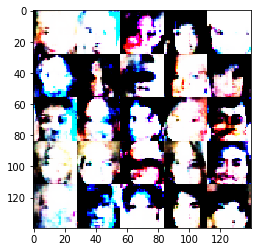

Epoch 1/1... Discriminator Loss: 1.3112... Generator Loss: 0.9717


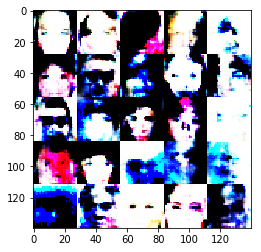

Epoch 1/1... Discriminator Loss: 1.4643... Generator Loss: 0.5818


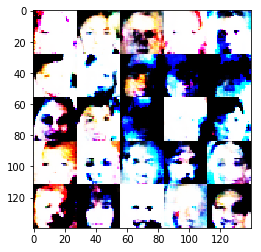

Epoch 1/1... Discriminator Loss: 0.9847... Generator Loss: 0.9108


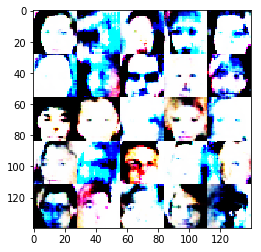

Epoch 1/1... Discriminator Loss: 1.0733... Generator Loss: 1.4461


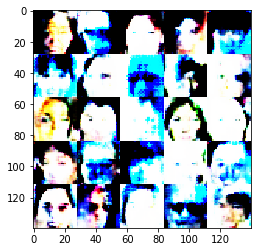

Epoch 1/1... Discriminator Loss: 0.5867... Generator Loss: 1.8957


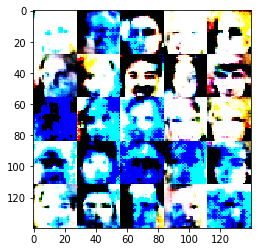

Epoch 1/1... Discriminator Loss: 0.6695... Generator Loss: 1.5935


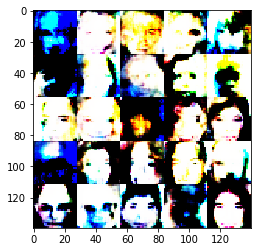

Epoch 1/1... Discriminator Loss: 0.5319... Generator Loss: 2.2406


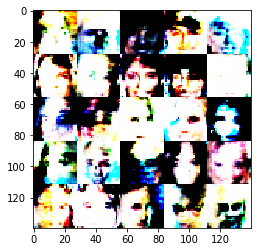

Epoch 1/1... Discriminator Loss: 1.0907... Generator Loss: 1.3190


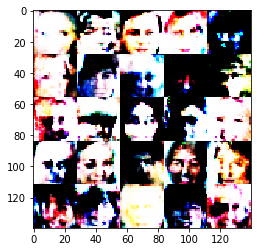

Epoch 1/1... Discriminator Loss: 0.6113... Generator Loss: 2.7849


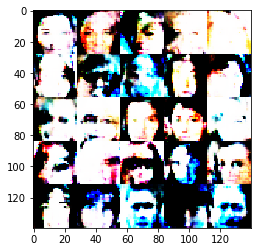

Epoch 1/1... Discriminator Loss: 0.6143... Generator Loss: 1.8155


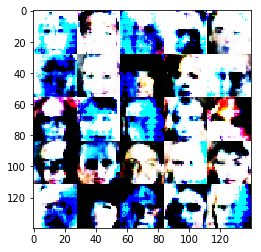

Epoch 1/1... Discriminator Loss: 0.7915... Generator Loss: 1.7317


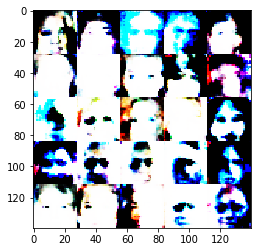

Epoch 1/1... Discriminator Loss: 0.5794... Generator Loss: 2.4351


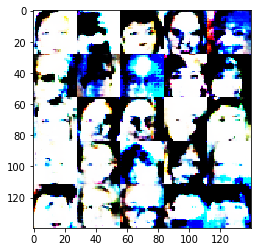

Epoch 1/1... Discriminator Loss: 1.1225... Generator Loss: 1.0089


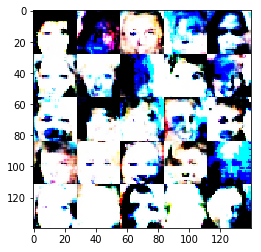

Epoch 1/1... Discriminator Loss: 1.9017... Generator Loss: 2.2280


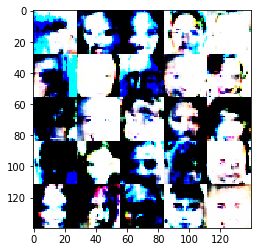

Epoch 1/1... Discriminator Loss: 0.9007... Generator Loss: 1.0055


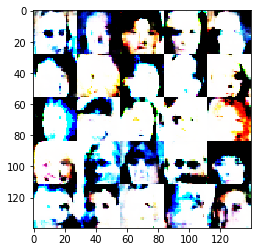

Epoch 1/1... Discriminator Loss: 1.5820... Generator Loss: 1.0004


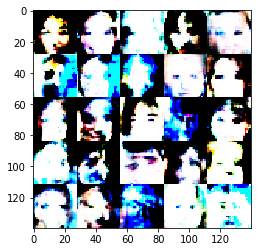

Epoch 1/1... Discriminator Loss: 1.2943... Generator Loss: 1.0072


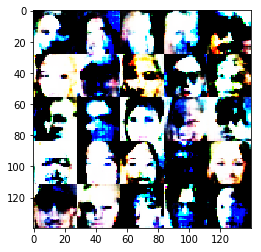

Epoch 1/1... Discriminator Loss: 1.2757... Generator Loss: 0.7958


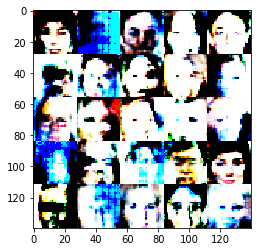

Epoch 1/1... Discriminator Loss: 1.0520... Generator Loss: 0.9668


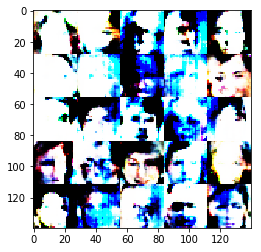

Epoch 1/1... Discriminator Loss: 1.0456... Generator Loss: 1.0571


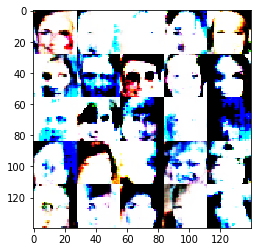

Epoch 1/1... Discriminator Loss: 1.3209... Generator Loss: 0.9504


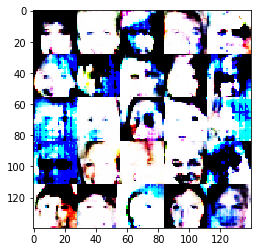

Epoch 1/1... Discriminator Loss: 1.0186... Generator Loss: 1.1892


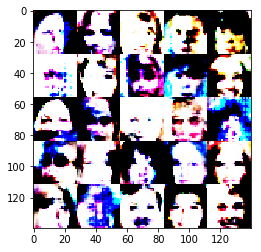

Epoch 1/1... Discriminator Loss: 0.9698... Generator Loss: 1.0983


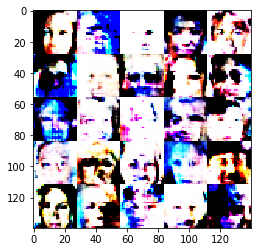

Epoch 1/1... Discriminator Loss: 1.1386... Generator Loss: 1.3833


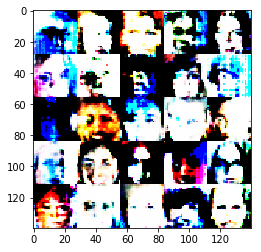

Epoch 1/1... Discriminator Loss: 0.9514... Generator Loss: 1.1049


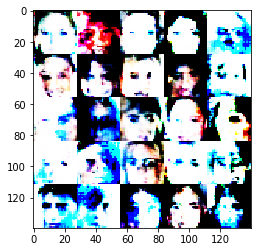

Epoch 1/1... Discriminator Loss: 1.2193... Generator Loss: 1.0625


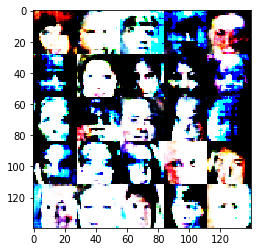

Epoch 1/1... Discriminator Loss: 0.9017... Generator Loss: 1.0160


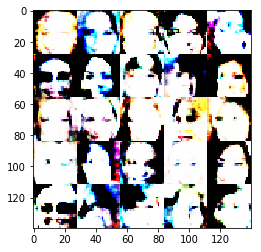

Epoch 1/1... Discriminator Loss: 2.4456... Generator Loss: 2.5860


In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.